In [47]:
import astroprov

from astropy.io import fits
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
from astropy.table import Table
from astropy.table import Column
from astropy.io import fits
from astropy.io.ascii import SExtractor
from astropy.coordinates import SkyCoord
import astropy.units as u
from astropy import wcs

from astroquery.simbad import Simbad

import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from photutils import DAOStarFinder
from photutils import CircularAperture
import os
import subprocess

import image_registration
from image_registration import chi2_shift
from image_registration.fft_tools import shift
import pandas
import collections

from reproject import reproject_interp
from astropy.utils.data import get_pkg_data_filename
from astropy.wcs import WCS

In [2]:
imageDirectory = '/data/mj1e16/kepler/cal/'
dirlist = os.listdir(imageDirectory)
dirlist = [x for x in dirlist if x[0] != '.']
#dirlist = sort(dirlist)
imagelist = [imageDirectory+x for x in dirlist]
#print(dirlist)

In [3]:
def correctExtensionOrder(imageName):
    hdu_list = fits.open(imageName)
    extensionOrder = np.zeros(len(hdu_list))
    for channel in range(1,len(hdu_list)):
        hdr = hdu_list[channel].header
        location = hdr['SKYGROUP'] # independant location
        extensionOrder[location] = channel # ordered from 0-84 channel with extension in place of name
    return extensionOrder

In [4]:
def medianImages(image1,image2,channelOrder1,channelOrder2,outfile): # medianing images 2 at a time as they are large
    image_concat = []
    medianlist = []
    hdu_list_1 = fits.open(image1)
    hdu_list_2 = fits.open(image2)
    for channel in range(1,len(channelOrder1)):
        chanNo1 = int(channelOrder1[channel])
        chanNo2 = int(channelOrder2[channel])
        
        im1 = hdu_list_1[chanNo1].data
        im2 = hdu_list_2[chanNo2].data
        
#         yoff,xoff = image_registration.cross_correlation_shifts(im1,im2)
#         im1_aligned_to_im2 = np.roll(np.roll(im1,int(yoff),1),int(xoff),0)
        
        xoff, yoff = chi2_shift(im2, im1, upsample_factor='auto')
        im1_aligned_to_im2 = shift.shiftnd(im1, -yoff, -xoff)

        medianImage = np.median([im2,im1_aligned_to_im2],axis=0)
        hdu = fits.PrimaryHDU(medianImage)
        hdu.writeto(outfile+'_{}.fits'.format(channel), clobber=True)
        medianlist.append(outfile+'_{}.fits'.format(channel))
    return outfile

In [5]:
def reMedian(median,image2,channel,channelOrder2,outfile): # medianing images 2 at a time as they are large
    
    image_concat = []
    hdu_list_1 = fits.open(median)
    hdu_list_2 = fits.open(image2)
    chanNo2 = int(channelOrder2[channel])
    im1 = hdu_list_1[0].data
    im2 = hdu_list_2[chanNo2].data
    
#     yoff,xoff = image_registration.cross_correlation_shifts(im1,im2)
#     im1_aligned_to_im2 = np.roll(np.roll(im1,int(yoff),1),int(xoff),0)

    xoff, yoff = chi2_shift(im2, im1, upsample_factor='auto')
    im1_aligned_to_im2 = shift.shiftnd(im1, -yoff, -xoff)
    
    medianImage = np.median([im2,im1_aligned_to_im2],axis=0)
    hdu = fits.PrimaryHDU(medianImage)
    hdu.writeto(outfile, clobber=True)
    
    return outfile

In [71]:
def newMedian(imageList,channelList,outfile='blah'):
    
    image_concat = []
    medianlist = []

    
    for channel in range(1,2): #len(channelList)):
        
        hdulist = []
        chanNo1 = int(channelList[0][channel])
        #hdu1 = fits.open(get_pkg_data_filename(imagelist[0]))[chanNo1]
        hdu1 = fits.open(imagelist[0])
        im2 = hdu1[chanNo1].data
        
        for image in range(1,5): # ,len(imagelist)):
            chanNo = int(channelList[image][channel])
            #hdu2 = fits.open(get_pkg_data_filename(imagelist[image]))[chanNo]
            #im1_aligned_to_im2, footprint = reproject_interp(hdu1,hdu2.header)
            
            hdu2 = fits.open(imagelist[image])
            im1 = hdu2[chanNo].data
            yoff,xoff = image_registration.cross_correlation_shifts(im1,im2)
            im1_aligned_to_im2 = np.roll(np.roll(im1,int(yoff),1),int(xoff),0)
            #im1_aligned_to_im2 = hdu2.data
            hdulist.append(im1_aligned_to_im2)
            #print(im1_aligned_to_im2.shape)
            
            f = plt.figure(figsize=(10,20))
            ax1=f.add_subplot(121)
            ax2=f.add_subplot(122)
            ax1.imshow(im1,cmap='Greys',norm=LogNorm())
            ax2.imshow(im1_aligned_to_im2,cmap='Greys',norm=LogNorm())
            plt.show()
            
#             fig, ax = plt.subplots(figsize=(10, 10))
#             ax.imshow(im1_aligned_to_im2,cmap='Greys',norm=LogNorm())
            
            
#             hdugraph = hdu2.data
#             #fig, ax = plt.subplots(figsize=(10, 10))
#             ax.imshow(hdugraph,cmap='Greys',norm=LogNorm())
#         plt.show()
        
        #imdata = hdulist[0][1].data
        shaperoni = im1_aligned_to_im2.shape
        output = np.zeros(shaperoni)
        
        xsegments = int(shaperoni[0]/100)# actually x
        ylen = shaperoni[0] # actuall y
        
        k = 0
        for i in range(100):
            imageSegment = []
            j = i * xsegments
            k = j + xsegments
            for imData in range(len(hdulist)):
                #k += xsegments
                chanNo = int(channelList[imData][channel])
                imageSegment.append(hdulist[imData][j:k,:])
            output[j:k,:] = np.median(imageSegment,axis=0)
        if k != shaperoni[1]:
            imageSegment = []
            print(k,shaperoni[1])
            for imData in range(len(hdulist)):
                chanNo = int(channelList[imData][channel])
                imageSegment.append(hdulist[imData][k:shaperoni[0],:])
            output[k:shaperoni[0],:] = np.median(imageSegment,axis=0)
        
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(output,cmap='Greys',norm=LogNorm())
        plt.title('Median Image Align')
        plt.show()
        hdu = fits.PrimaryHDU(output)
        hdu.writeto(outfile+'_{}.fits'.format(channel), clobber=True)
        medianlist.append(outfile+'_{}.fits'.format(channel))
        
#         NBINS = 1000
#         po = output.flatten()
#         po = po[np.isfinite(po)]
#         plt.hist(po,NBINS)
#         plt.show()
        
#         for x in hdulist:
#             po = x.flatten()
#             po = po[np.isfinite(po)]
#             plt.hist(x.flatten(),NBINS)
#             plt.show()

#         fig, ax = plt.subplots(figsize=(10, 10))
#         #print(outfiles+'_{}.fits'.format(x))
#         hdu = fits.open(outfile+'_{}.fits'.format(x))
#         imdata = hdu[0].data
#         ax.imshow(imdata,cmap='Greys',norm=LogNorm())
#         plt.show()
        
    return outfile
    
    

In [72]:
def newMedianReproject(imageList,channelList,outfile='blah'):
    
    image_concat = []
    medianlist = []

    
    for channel in range(1,2): #len(channelList)):
        
        hdulist = []
        chanNo1 = int(channelList[0][channel])
        hdu1 = fits.open(get_pkg_data_filename(imagelist[0]))[chanNo1]
        
        for image in range(1,5): # ,len(imagelist)):
            chanNo = int(channelList[image][channel])
            hdu2 = fits.open(get_pkg_data_filename(imagelist[image]))[chanNo]
            im1_aligned_to_im2, footprint = reproject_interp(hdu1,hdu2.header)
            hdulist.append(im1_aligned_to_im2)
            
#             f = plt.figure(figsize=(10,20))
#             ax1=f.add_subplot(121)
#             ax2=f.add_subplot(122)
#             ax1.imshow(im1,cmap='Greys',norm=LogNorm())
#             ax2.imshow(im1_aligned_to_im2,cmap='Greys',norm=LogNorm())
#             plt.show()
        
        shaperoni = im1_aligned_to_im2.shape
        output = np.zeros(shaperoni)
        
        xsegments = int(shaperoni[0]/100)# actually x
        ylen = shaperoni[0] # actuall y
        
        k = 0
        for i in range(100):
            imageSegment = []
            j = i * xsegments
            k = j + xsegments
            for imData in range(len(hdulist)):
                #k += xsegments
                chanNo = int(channelList[imData][channel])
                imageSegment.append(hdulist[imData][j:k,:])
            output[j:k,:] = np.median(imageSegment,axis=0)
        if k != shaperoni[1]:
            imageSegment = []
            print(k,shaperoni[1])
            for imData in range(len(hdulist)):
                chanNo = int(channelList[imData][channel])
                imageSegment.append(hdulist[imData][k:shaperoni[0],:])
            output[k:shaperoni[0],:] = np.median(imageSegment,axis=0)
        
        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(output,cmap='Greys',norm=LogNorm())
        plt.title('Median Image Reproject')
        plt.show()
        hdu = fits.PrimaryHDU(output)
        hdu.writeto(outfile+'_{}.fits'.format(channel), clobber=True)
        medianlist.append(outfile+'_{}.fits'.format(channel))
        
        
    return outfile
    
    

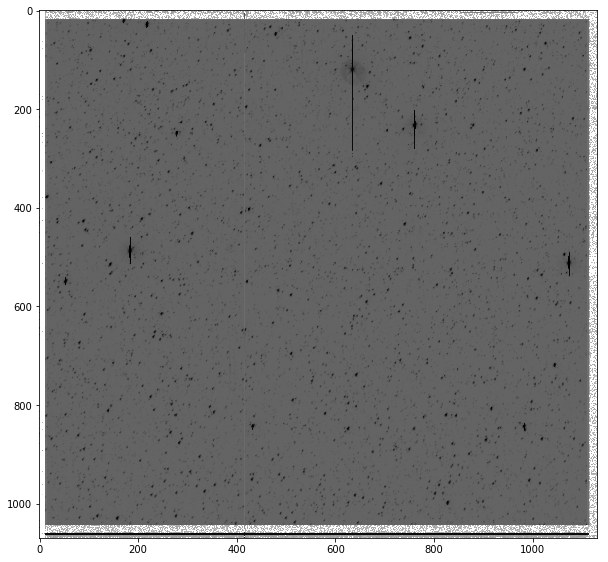

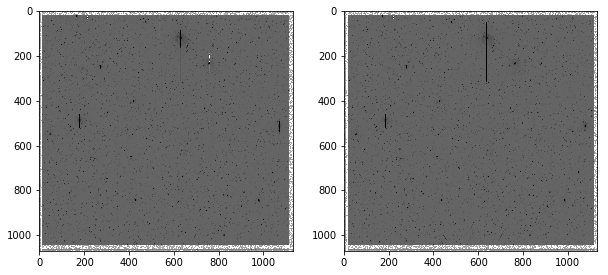

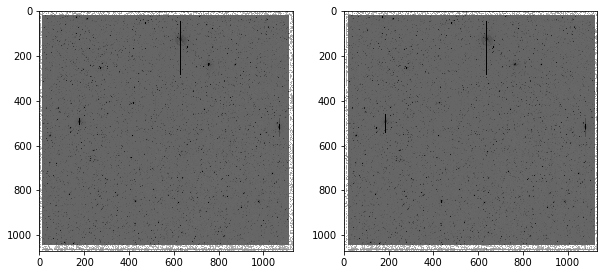

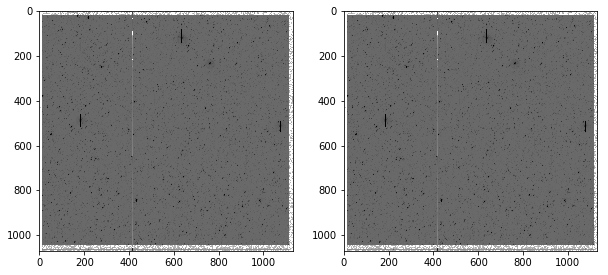

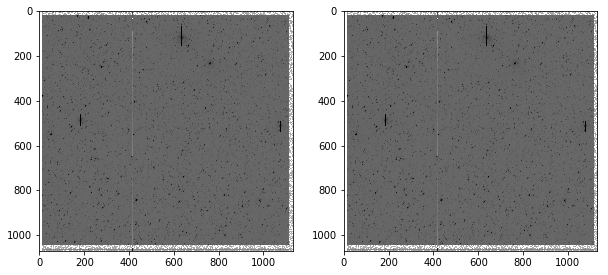

(1000, 1132)


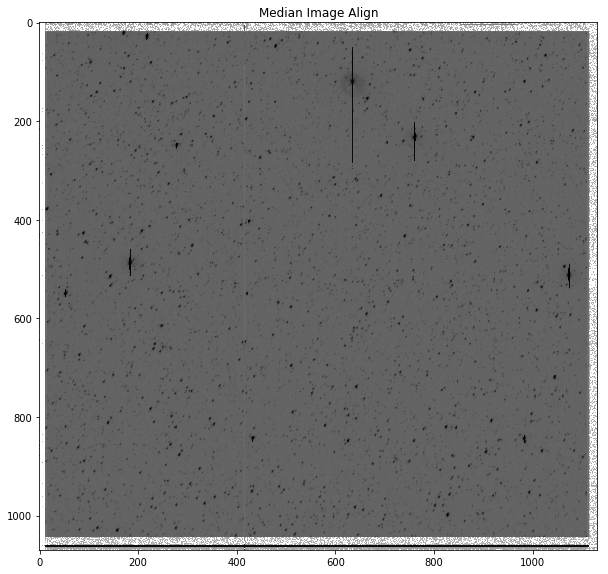

'/data/mj1e16/kepler/medians/meidian'

In [73]:
newMedian(imagelist,extensionOrders,'/data/mj1e16/kepler/medians/meidian')

(1000, 1132)


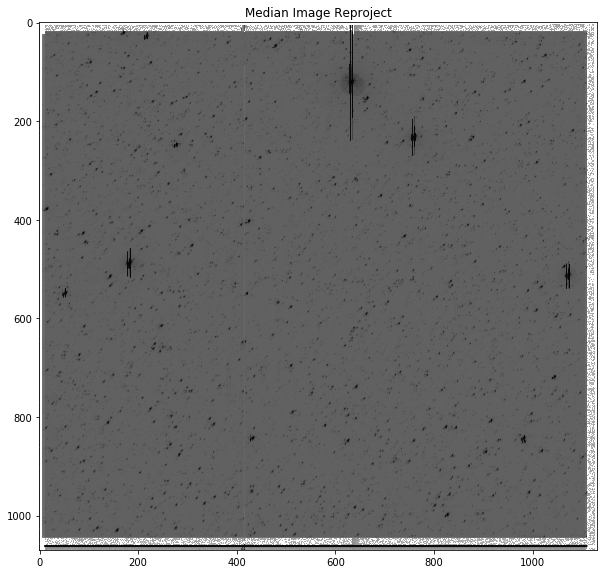

'/data/mj1e16/kepler/medians/meidian'

In [74]:
newMedianReproject(imagelist,extensionOrders,'/data/mj1e16/kepler/medians/meidian')

In [ ]:
int(2.9)

In [41]:
hdu = fits.open(imagelist[17])
#im1 = 
a = hdu[21].data
print(a.shape)

(1070, 1132)


In [35]:
b= a.shape
print(b)
print(b[1])

(1070, 1132)
1132


In [7]:
def findLowerMagLimit(imagename,cataloguename,magAbove=3,sextractoryDir='/home/mj1e16/sextractor/sextractor-master/config/'):
    os.chdir(sextractoryDir)
    subprocess.call(['sex',imagename])
    assoc = Table.read(cataloguename,format='ascii.sextractor')
    
    print(len(assoc))
    mags = assoc['MAG_BEST'] 
    mags = [x for x in mags if x < 95]
    
    plt.hist(mags,bins='auto')
    plt.show()
    
    minMag = max(mags)
    magLimit = minMag - magAbove
    
    return magLimit

In [8]:
def sextractorTransientSearch(imagename,cataloguename,lowerMag,sextractoryDir='/home/mj1e16/sextractor/sextractor-master/config/'):
    os.chdir(sextractoryDir)
    print(imagename)
    subprocess.call(['sex',imagename])
    assoc = Table.read(cataloguename,format='ascii.sextractor')

    hdu_list = fits.open(imagename) # open image header
    imagedata = (hdu_list[0].data) 
    
    fig, ax = plt.subplots(figsize=(10, 10))
    positions = (assoc['X_IMAGE'], assoc['Y_IMAGE'])
    apertures = CircularAperture(positions, r=4.)
    norm = ImageNormalize(stretch=SqrtStretch())
    ax.imshow(imagedata, cmap='Greys', origin='lower', vmin=-100,vmax=100)#norm=norm)
    apertures.plot(color='blue', lw=1.5, alpha=0.5)
    #plt.savefig('fits.png',dpi=100)
    plt.show()
    
    df = assoc.to_pandas()
    df.drop(df[df['MAG_BEST'] > lowerMag].index)
    #assoc.drop(assoc[assoc.MAG_BEST > lowerMag].index)
    
    plt.hist(df['MAG_BEST'],bins='auto')
    plt.show()
    
    return df

In [9]:
def queryObjectRegion(outputTable,inCat,imageName,searchRadius=5*u.arcsecond):
    imageCoords = []
    r = searchRadius
    
    if inCat == 'dao':
        xlabel = 'xcentroid'
        ylabel = 'ycentroid'
        label = 'id'
        
    if inCat == 'sex':
        xlabel = 'X_IMAGE'
        ylabel = 'Y_IMAGE'
        label = 'NUMBER'
        
    tableLength = len(outputTable)
    for x in range(tableLength):
        xpos = outputTable[xlabel][x]
        ypos = outputTable[ylabel][x]
        if 20 < ypos < 1040:
            if 12 < xpos < 1110:
                imageCoords.append([xpos,ypos])
                # this may need to change per image but I hope not

    coords = load_wcs_from_file(imageName,imageCoords)
    print(coords)
    customSimbad = Simbad()
    customSimbad.add_votable_fields('ra(d)','dec(d)','otype')
    customSimbad.remove_votable_fields('coordinates')
            
    result_table = Table([['-'],[0],[0],['-'],[0],[0]],names=('MAIN_ID','RA_d','DEC_d','OTYPE','xcentroid','ycentroid'),dtype=('object','float64','float64','object','float64','float64'))

    for x in range(len(imageCoords)):
        try:
            c = SkyCoord(coords[x][0],coords[x][1],frame='icrs',unit='deg')
            rt = customSimbad.query_region(c,radius=r)
            rowlist = []
            for y in range(len(rt[0])):
                rowlist.append(rt[0][y])
            rowlist.append(imageCoords[x][0])
            rowlist.append(imageCoords[x][1])
            result_table.add_row(rowlist)

        except:
            result_table.add_row(['N/A',[0],[0],'Not Found in Simbad',[imageCoords[x][0]],[imageCoords[x][1]]])
    
    
    return result_table

In [10]:
def alterDefault(defaultDir,valList,attributeList):
    
    with open(defaultDir+'/default.sex','r') as f:
        data  = f.read()
    for x in range(len(valList)):
        nameLoc = data.find(attributeList[x]) + len(attributeList[x])
        endLoc = data[nameLoc:].find('#') + nameLoc
        newData = data[:nameLoc] + ' '+str(valList[x])+' ' + data[endLoc:]
        data = newData
    
#     with open(defaultDir+'/default.sex','r') as f:
#         endData = f.read()
#     cname = 'CATALOG_NAME'
#     nameLoc = endData.find(cname) + len(cname)
#     endLoc = data[nameLoc:].find('#') + nameLoc
#     newData = data[:nameLoc] + '' + data[endLoc:]
    
    with open(defaultDir+'/default.sex','w') as f:
        f.write(data)

In [11]:
def load_wcs_from_file(filename,pixCoord):
    # Load the FITS hdulist using astropy.io.fits
    hdulist = fits.open(filename)

    # Parse the WCS keywords in the primary HDU
    w = wcs.WCS(hdulist[0].header)

    # Print out the "name" of the WCS, as defined in the FITS header
    #print(w.wcs.name)

    # Print out all of the settings that were parsed from the header
    w.wcs.print_contents()

    # Three pixel coordinates of interest.
    # Note we've silently assumed a NAXIS=2 image here.
    # Note also that the pixel coordinates are pairs of [X, Y], 
    # and since WCS built from FITS header automatically has
    # origin set to 1, [0, 0] is actually not inside the image.
    pixcrd = np.array(pixCoord, dtype=np.float_)

    # Convert pixel coordinates to world coordinates
    # The second argument is "origin" -- in this case we're declaring we
    # have 1-based (Fortran-like) coordinates.
    world = w.wcs_pix2world(pixcrd, 1)
    #print(world)
    return(world)
#     # Convert the same coordinates back to pixel coordinates.
#     pixcrd2 = w.wcs_world2pix(world, 1)
#     print(pixcrd2)

#     # These should be the same as the original pixel coordinates, modulo
#     # some floating-point error.
#     assert np.max(np.abs(pixcrd - pixcrd2)) < 1e-6




In [12]:
def findObjectOccurences(inputTable,columnName):
    otype = inputTable[columnName]
    otypelist = []
    for x in range(len(otype)):
        otypelist.append(otype[x])
    #print(len(otypelist))
    newotype = set(otypelist)
    counter = collections.Counter(otypelist)
    keys = counter.keys()
    values = counter.values()
    occurenceDict = dict(zip(keys,values))
    od = collections.OrderedDict(sorted(occurenceDict.items()))
    return od

In [13]:
alterDefault('/home/mj1e16/sextractor/sextractor-master/config/',[5,5,64,3],['DETECT_THRESH','DETECT_MINAREA','BACK_SIZE','BACK_FILTERSIZE'])

In [13]:
extensionOrders = []
for image in imagelist:
    extensionOrders.append(correctExtensionOrder(image))

In [14]:
medianDir = '/data/mj1e16/kepler/newDiff/'
medians = os.listdir(medianDir)
medians = [x for x in medians if x[0] != '.']
medians.sort()

/data/mj1e16/kepler/medians/meidian_1.fits


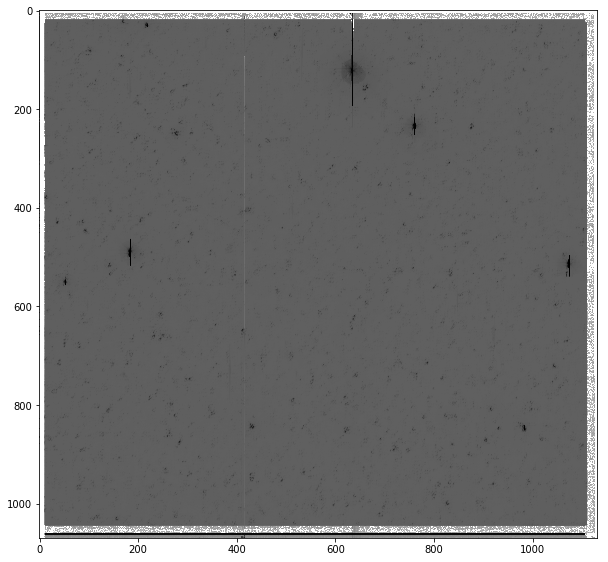

/data/mj1e16/kepler/medians/meidian_2.fits


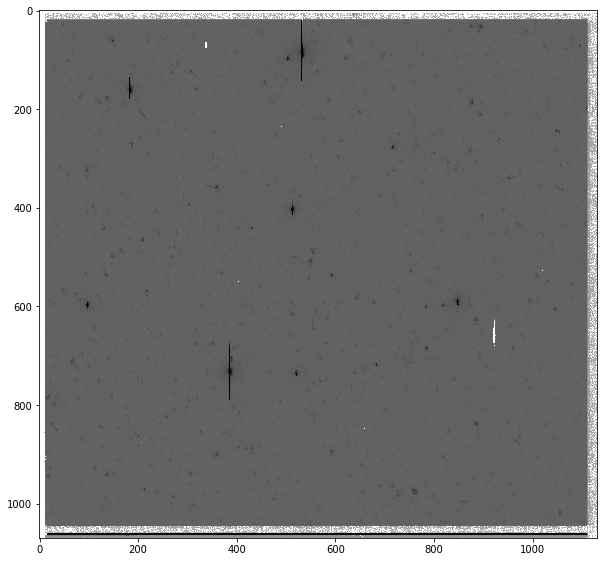

/data/mj1e16/kepler/medians/meidian_3.fits


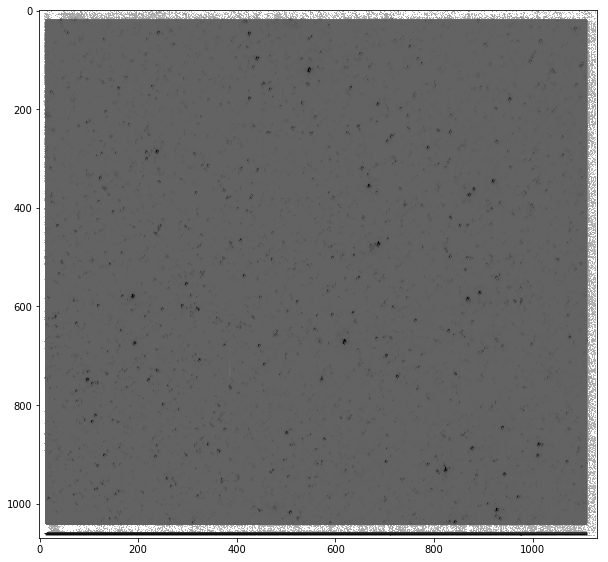

/data/mj1e16/kepler/medians/meidian_4.fits


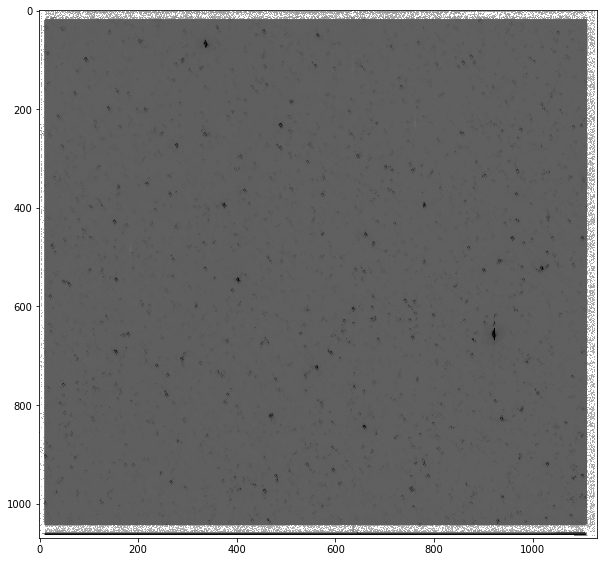

In [27]:
outfiles = '/data/mj1e16/kepler/medians/meidian'
norm = ImageNormalize(stretch=SqrtStretch())
for x in range(1,5):
    fig, ax = plt.subplots(figsize=(10, 10))
    print(outfiles+'_{}.fits'.format(x))
    hdu = fits.open(outfiles+'_{}.fits'.format(x))
    imdata = hdu[0].data
    ax.imshow(imdata,cmap='Greys',norm=LogNorm())
    plt.show()

In [61]:
def medianImages(image1,image2,channelOrder1,channelOrder2,outfile): # medianing images 2 at a time as they are large
    image_concat = []
    medianlist = []
    hdu_list_1 = fits.open(image1)
    hdu_list_2 = fits.open(image2)
    
    
    
    for channel in range(1,len(channelOrder1)):
        chanNo1 = int(channelOrder1[channel])
        chanNo2 = int(channelOrder2[channel])
        
#         hdu1 = fits.open(get_pkg_data_filename(image1))[chanNo1]
#         hdu2 = fits.open(get_pkg_data_filename(image2))[chanNo2]
        
        im1 = hdu_list_1[chanNo1].data
        im2 = hdu_list_2[chanNo2].data
        
        yoff,xoff = image_registration.cross_correlation_shifts(im1,im2)
        im1_aligned_to_im2 = np.roll(np.roll(im1,int(yoff),1),int(xoff),0)
        
#         xoff, yoff ,exoff, eyoff= chi2_shift(im2, im1, return_error=True ,upsample_factor='auto')
#         im1_aligned_to_im2 = shift.shiftnd(im1, -yoff, -xoff)

#         im1_aligned_to_im2, footprint = reproject_interp(hdu1,hdu2.header)


        medianImage = np.median([im2,im1_aligned_to_im2],axis=0)
        medianImage = np.absolute(medianImage)
        
        fig, ax = plt.subplots(figsize=(10, 10))
        norm = ImageNormalize(stretch=SqrtStretch())
        ax.imshow(medianImage, cmap='Greys',norm=LogNorm())
        plt.show()
        
        hdu = fits.PrimaryHDU(medianImage)
        hdu.writeto(outfile+'_{}.fits'.format(channel), clobber=True)
        medianlist.append(outfile+'_{}.fits'.format(channel))
    return outfile

In [54]:
def reMedian(median,image2,channel,channelOrder2,outfile): # medianing images 2 at a time as they are large
    
    image_concat = []
    hdu_list_1 = fits.open(median)
    hdu_list_2 = fits.open(image2)
    
    hdu1 = fits.open(get_pkg_data_filename(median))[0]
    hdu2 = fits.open(get_pkg_data_filename(image2))[chanNo2]
    
    chanNo2 = int(channelOrder2[channel])
    im1 = hdu_list_1[0].data
    im2 = hdu_list_2[chanNo2].data
    
#     yoff,xoff = image_registration.cross_correlation_shifts(im1,im2)
#     im1_aligned_to_im2 = np.roll(np.roll(im1,int(yoff),1),int(xoff),0)
    
#     xoff, yoff ,exoff, eyoff= chi2_shift(im2, im1, return_error=True ,upsample_factor='auto')
#     im1_aligned_to_im2 = shift.shiftnd(im1, -yoff, -xoff)

    im1_aligned_to_im2, footprint = reproject_interp(hdu1,hdu2.header)
    
    medianImage = np.median([im2,im1_aligned_to_im2],axis=0)
    medianImage = np.absolute(medianImage)
    
    
    
    fig, ax = plt.subplots(figsize=(10, 10))
    norm = ImageNormalize(stretch=SqrtStretch())
    ax.imshow(medianImage, cmap='Greys',norm=LogNorm())
    plt.show()
    
    hdu = fits.PrimaryHDU(medianImage)
    hdu.writeto(outfile, clobber=True)
    
    return outfile

In [42]:
import itertools

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 5519 results
  r = func(a, **kwargs)
/home/mj1e16/.local/lib/python2.7/site-packages/matplotlib/colors.py:929: RuntimeWarning: invalid value encountered in less_equal
  mask |= resdat <= 0


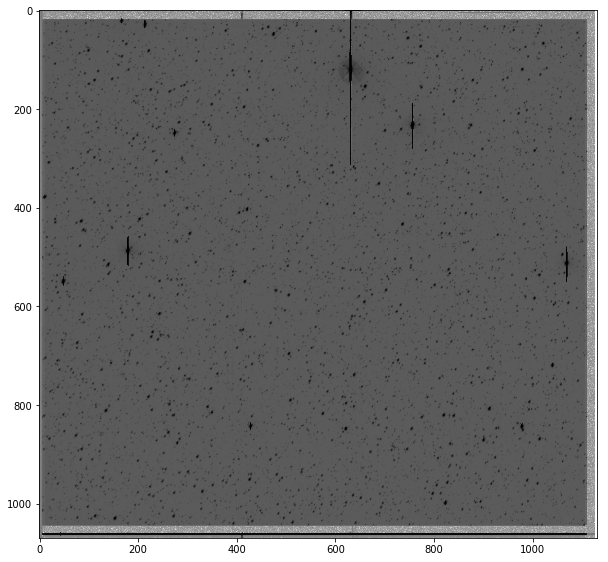

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 6340 results
  r = func(a, **kwargs)


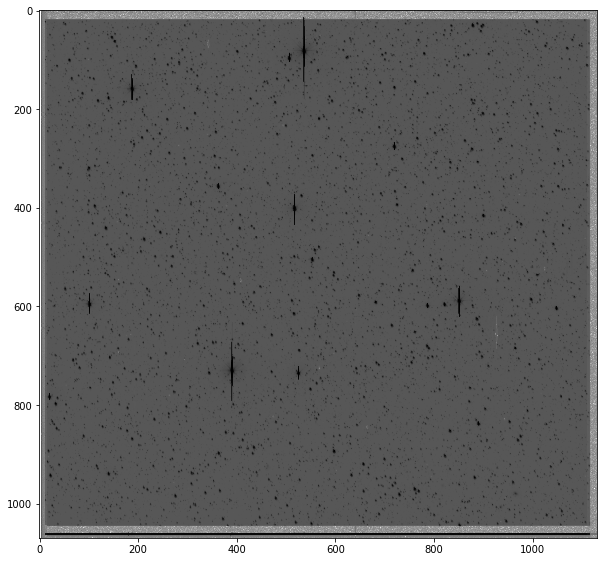

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 6536 results
  r = func(a, **kwargs)


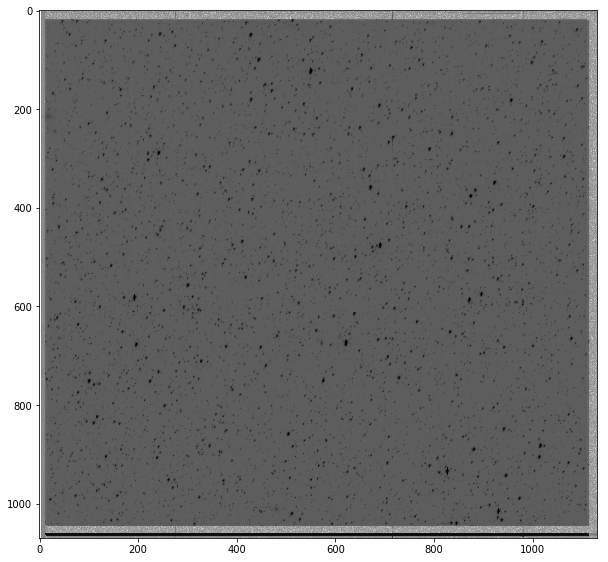

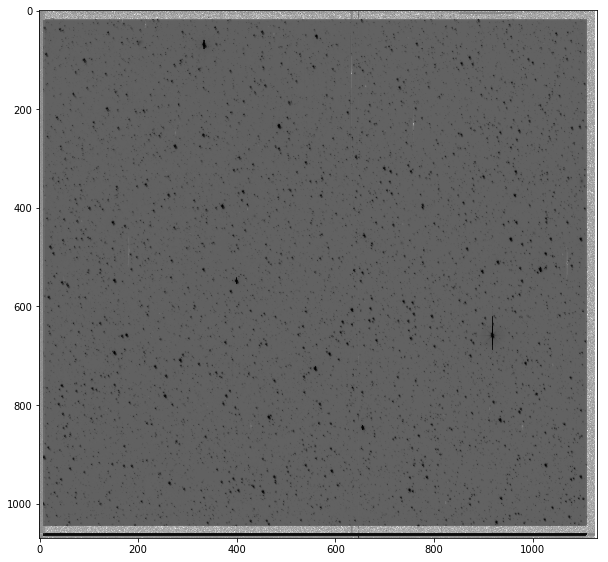

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 5988 results
  r = func(a, **kwargs)


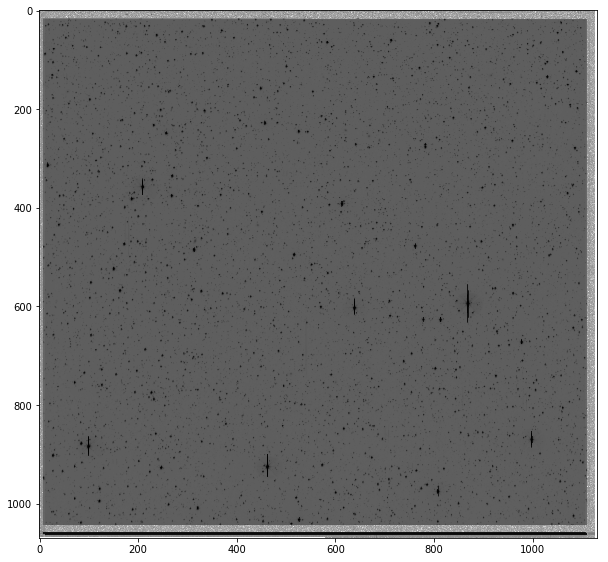

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 4991 results
  r = func(a, **kwargs)


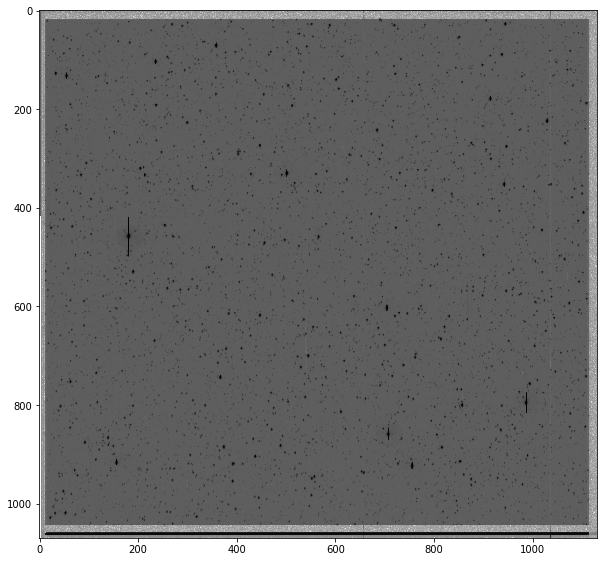

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 4528 results
  r = func(a, **kwargs)


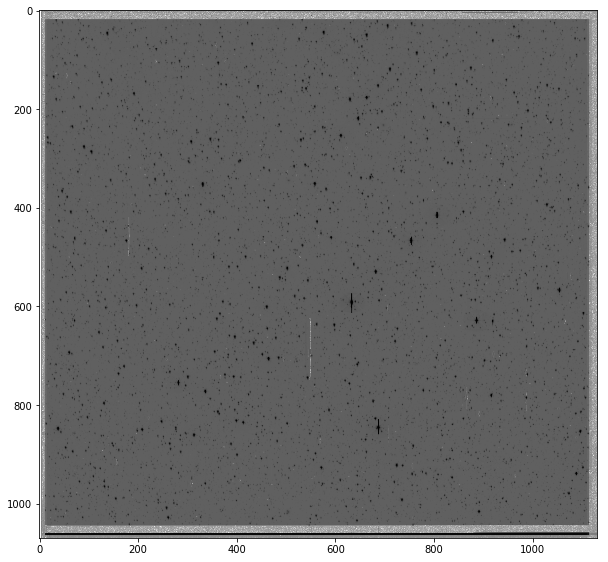

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 5408 results
  r = func(a, **kwargs)


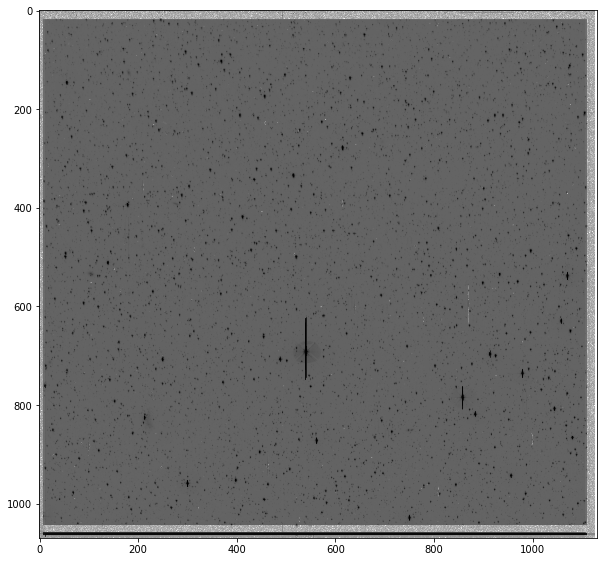

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 6165 results
  r = func(a, **kwargs)


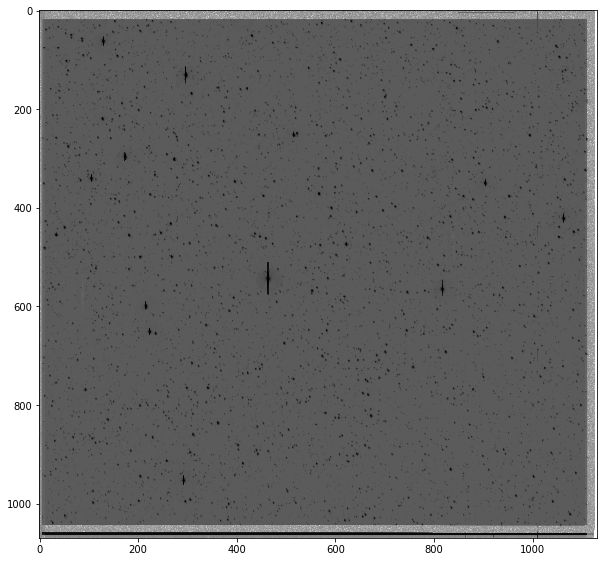

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 5635 results
  r = func(a, **kwargs)


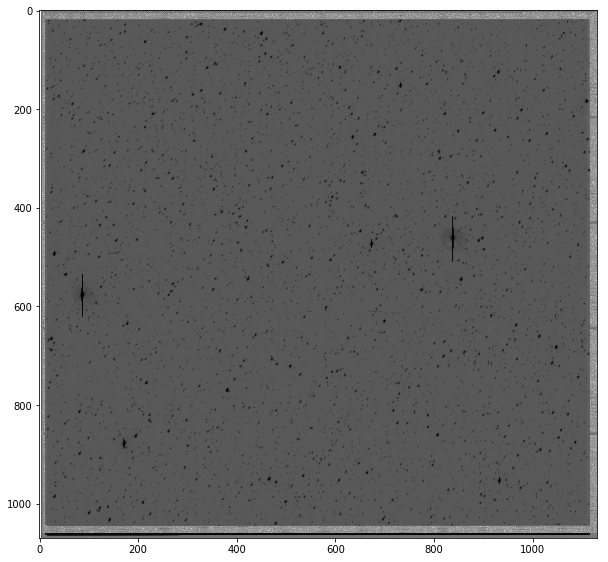

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 10067 results
  r = func(a, **kwargs)


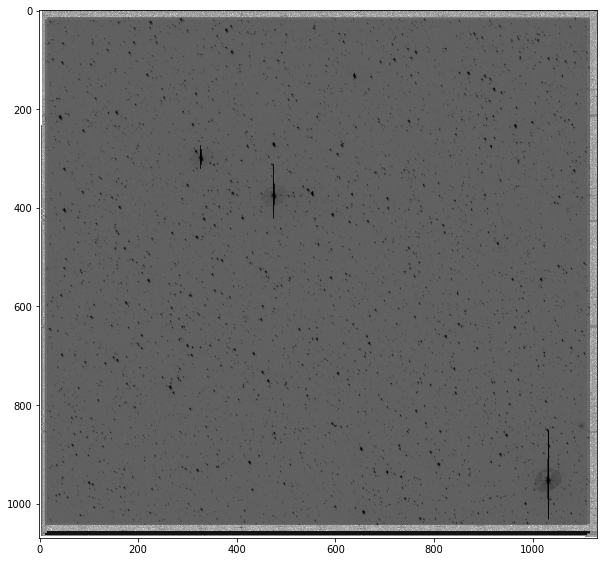

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 9611 results
  r = func(a, **kwargs)


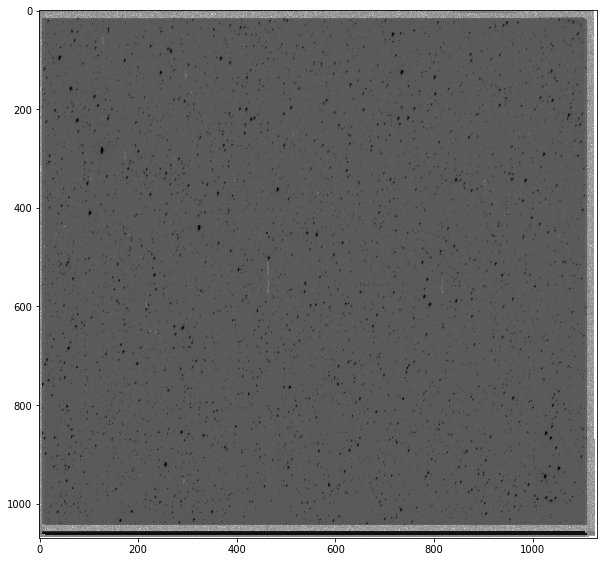

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 6884 results
  r = func(a, **kwargs)


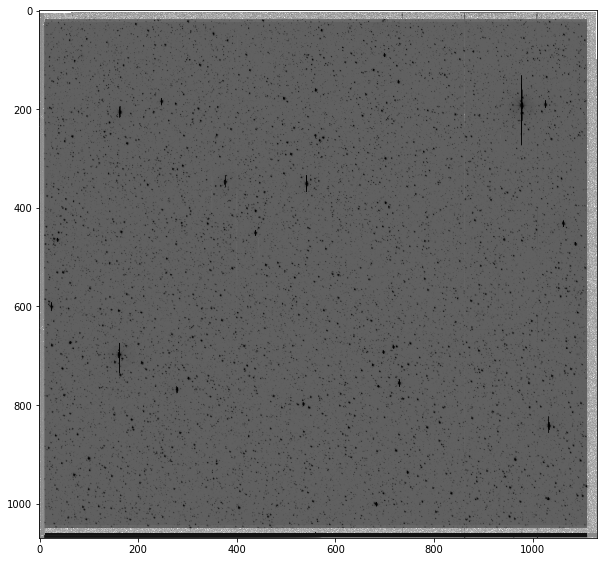

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 5634 results
  r = func(a, **kwargs)


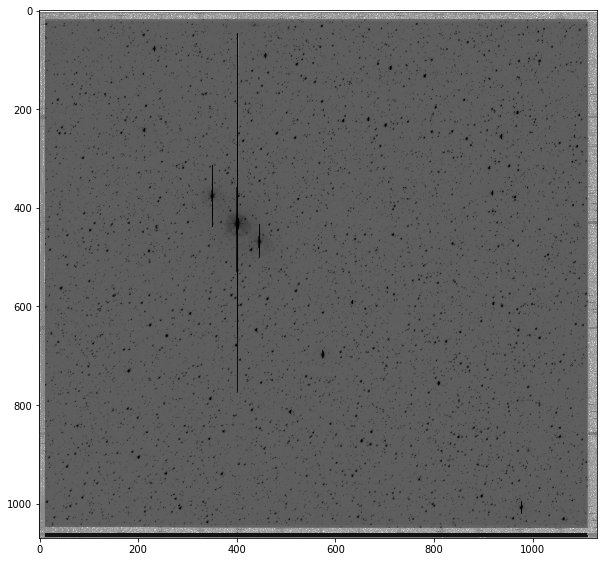

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 1105 results
  r = func(a, **kwargs)


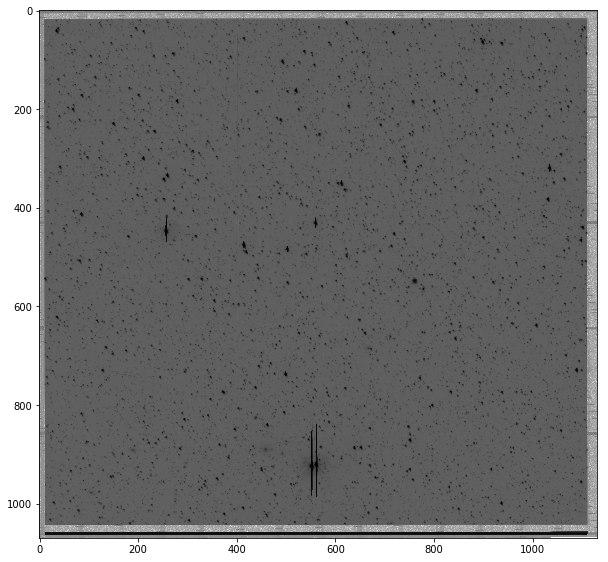

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 4404 results
  r = func(a, **kwargs)


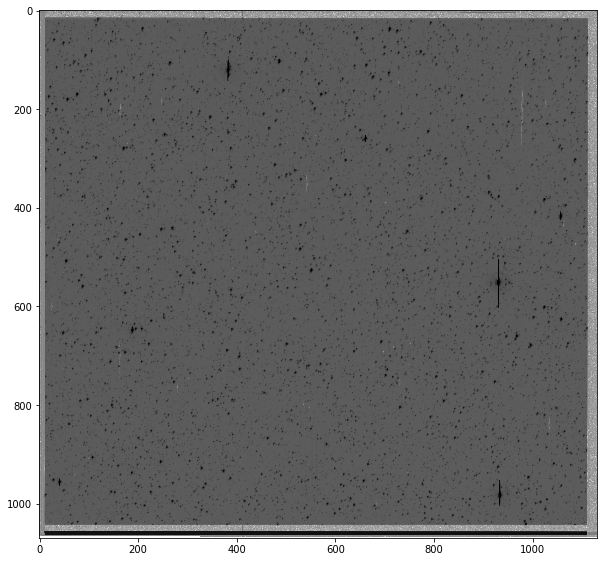

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 7546 results
  r = func(a, **kwargs)


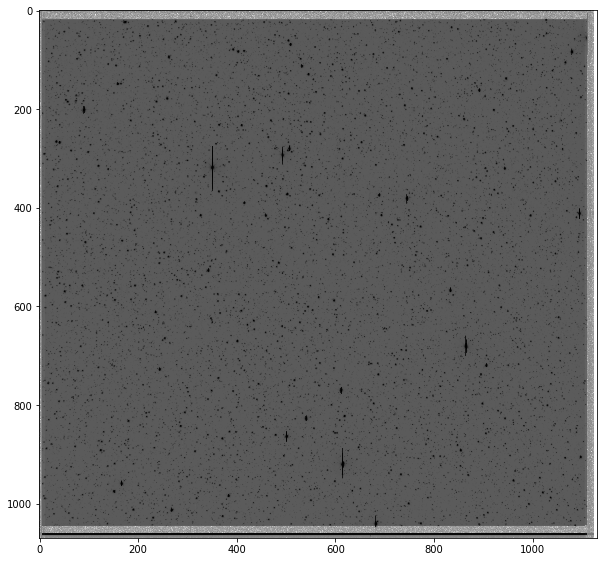

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 6477 results
  r = func(a, **kwargs)


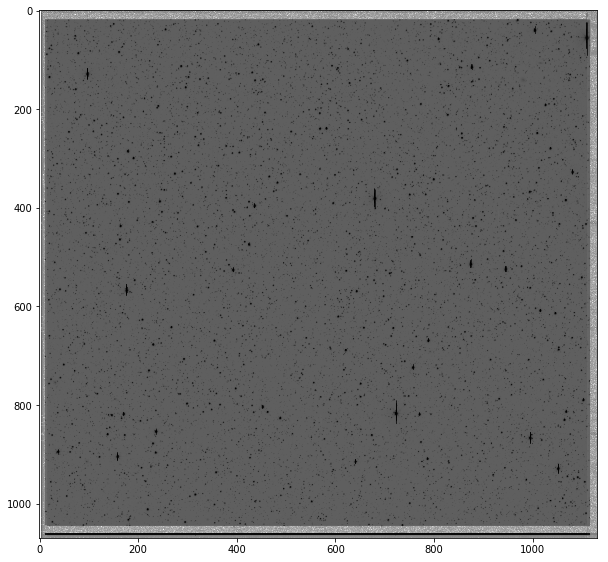

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 5745 results
  r = func(a, **kwargs)


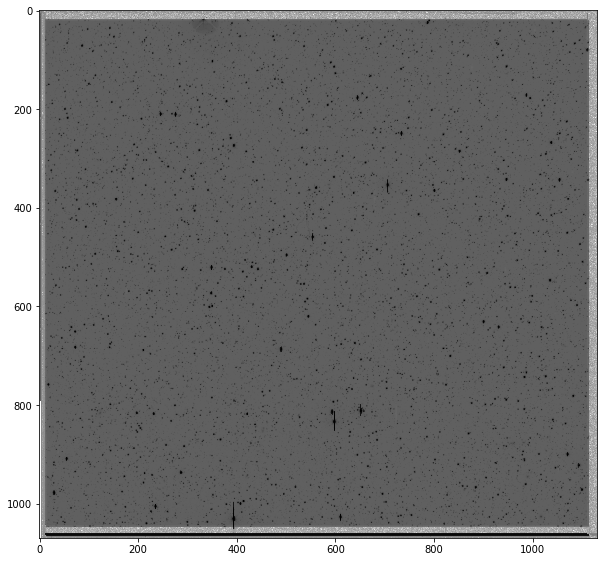

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 6519 results
  r = func(a, **kwargs)


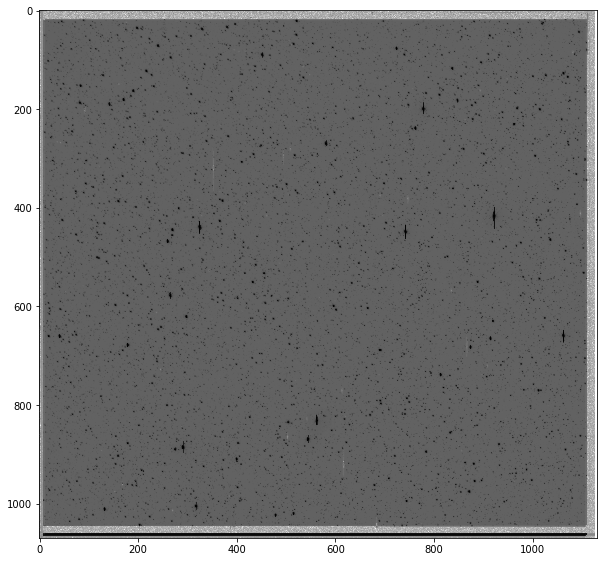

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 6323 results
  r = func(a, **kwargs)


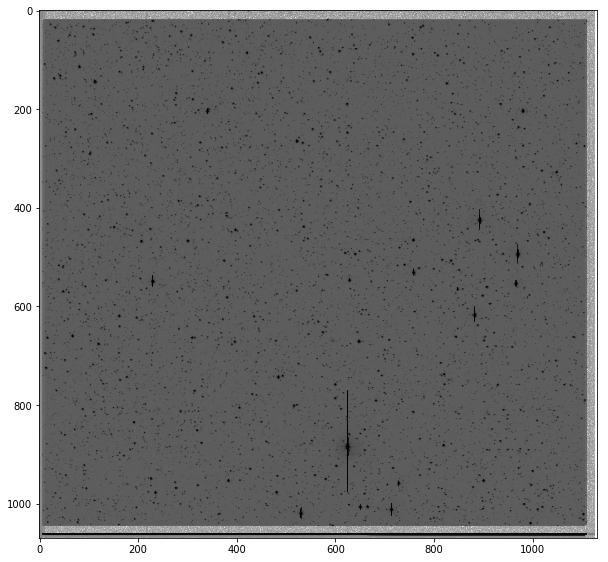

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 6101 results
  r = func(a, **kwargs)


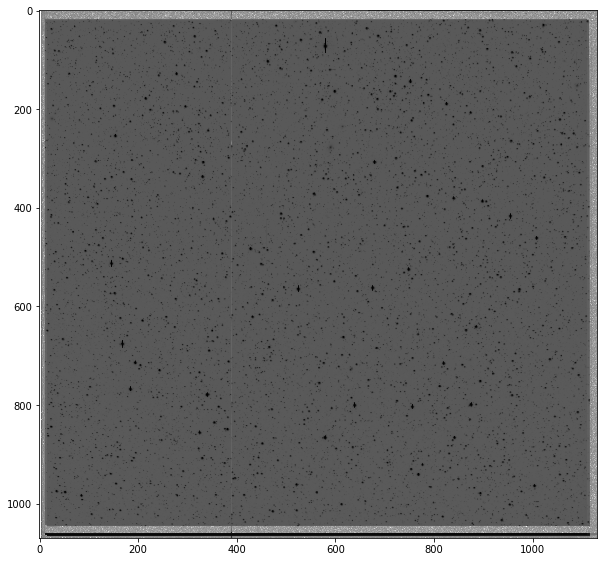

/home/mj1e16/.local/lib/python2.7/site-packages/numpy/lib/function_base.py:4011: RuntimeWarning: Invalid value encountered in median for 4339 results
  r = func(a, **kwargs)


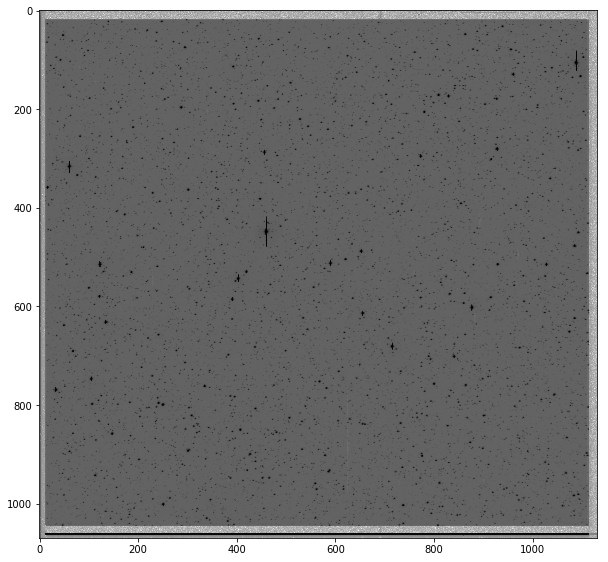

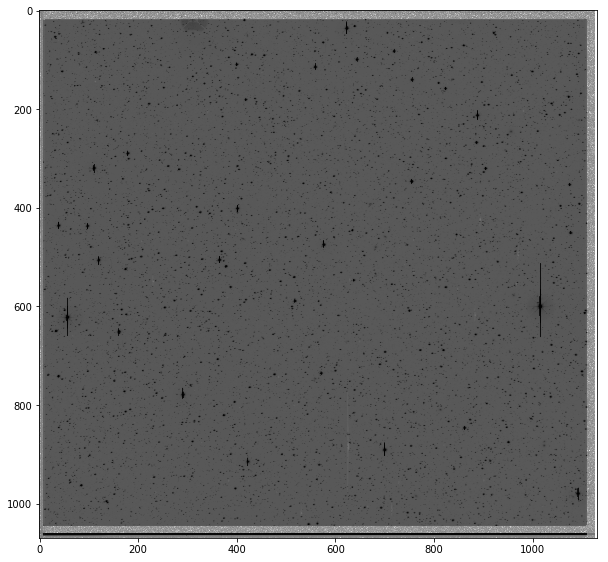

KeyboardInterrupt: 

In [59]:

medianImages(imagelist[0],imagelist[1],extensionOrders[0],extensionOrders[1],'/data/mj1e16/kepler/newDiff/median')

for imageNo in range(2,3): #len(imagelist)):
    for channel in range(1,2): #len(medians)):
        medianFile = medianDir+'median_{}.fits'.format(channel)
        reMedian(medianFile,imagelist[imageNo],channel,extensionOrders[imageNo],medianFile)
        
os.chdir('/data/mj1e16/kepler/hotpants-master/')
for imNo in range(1): #len(imagelist)):
    for channel in range(1,2): #len(medians)):
        ccdChannel = int(extensionOrders[imNo][channel])
        inim = imagelist[imNo]+'[{}]'.format(ccdChannel)
        tmplim = medianDir+'median_{}.fits'.format(channel)
        outim = '/data/mj1e16/kepler/properDiff/diff_imNo{}_channel{}.fits'.format(imNo,channel)
        subprocess.call(['./hotpants','-inim',inim,'-tmplim',tmplim,'-outim',outim,'-v','0'])

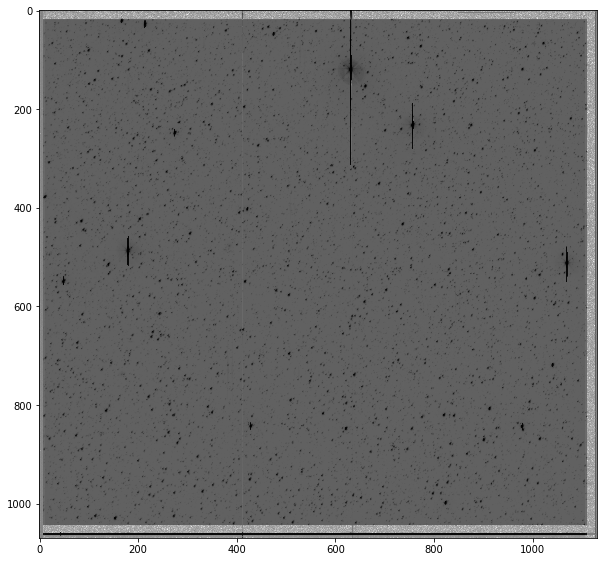

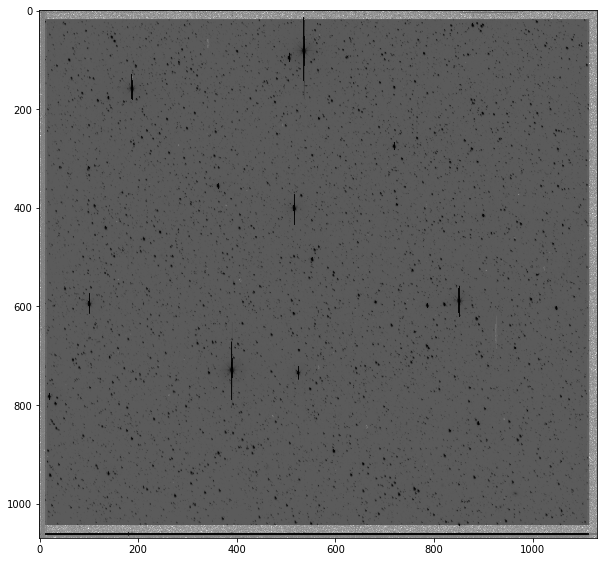

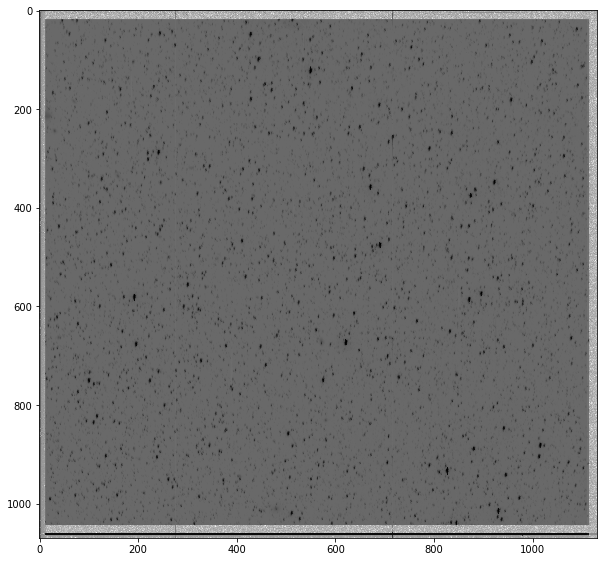

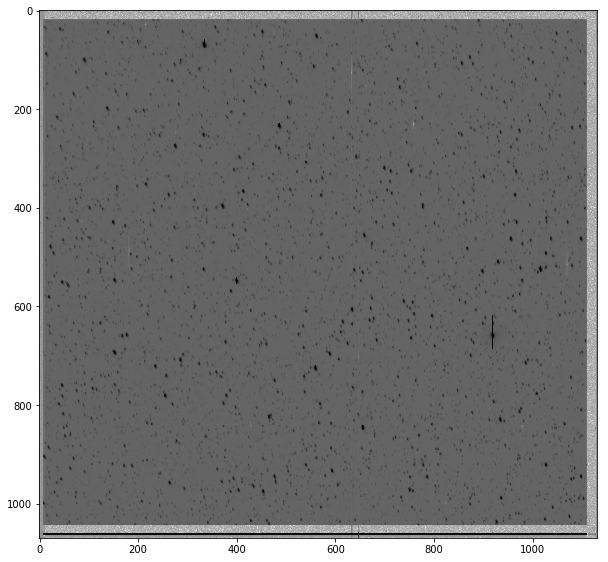

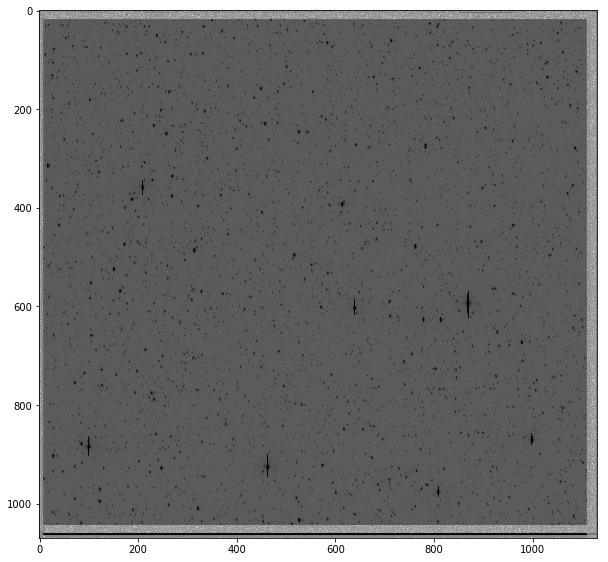

...

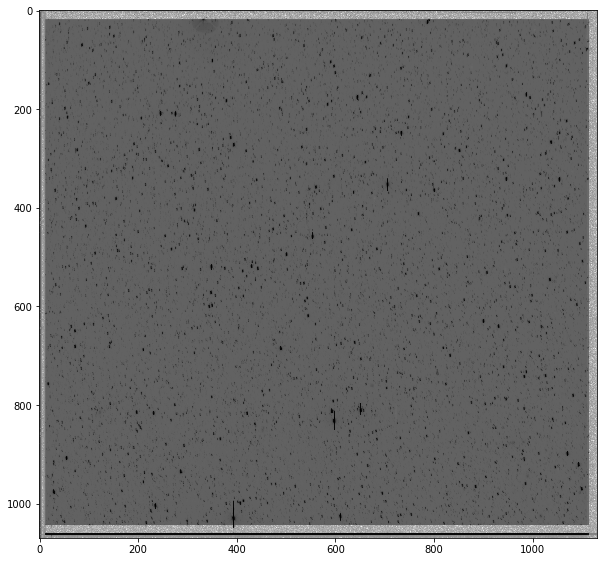

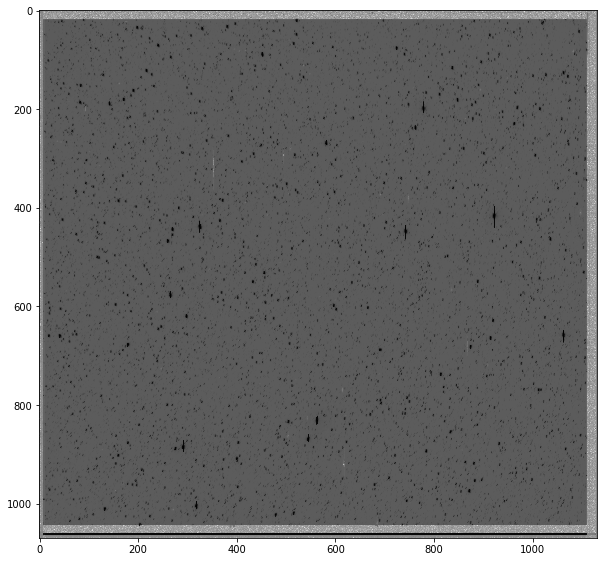

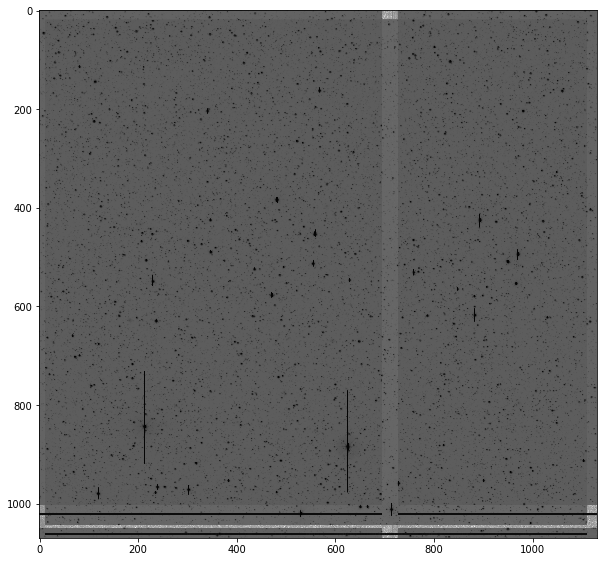

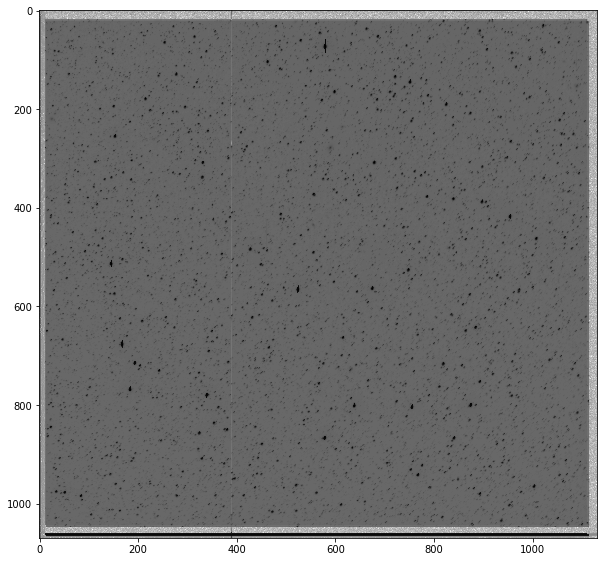

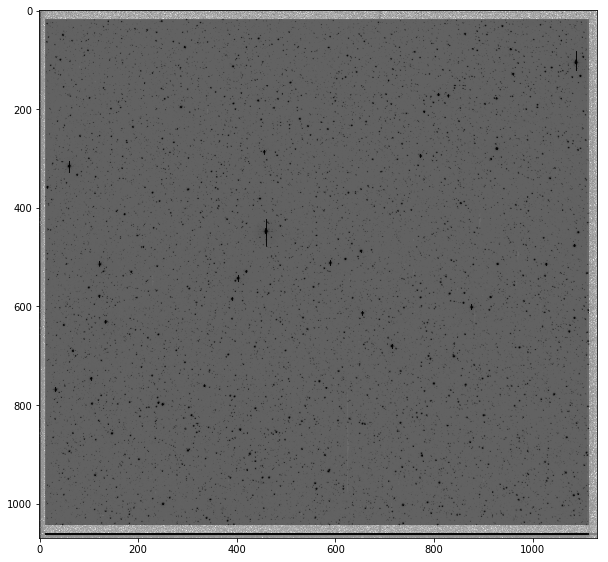

ValueError: Shape of array too small to calculate a numerical gradient, at least (edge_order + 1) elements are required.

In [62]:

medianImages(imagelist[0],imagelist[1],extensionOrders[0],extensionOrders[1],'/data/mj1e16/kepler/newDiff/median')

for imageNo in range(2,3): #len(imagelist)):
    for channel in range(1,2): #len(medians)):
        medianFile = medianDir+'median_{}.fits'.format(channel)
        reMedian(medianFile,imagelist[imageNo],channel,extensionOrders[imageNo],medianFile)
        
os.chdir('/data/mj1e16/kepler/hotpants-master/')
for imNo in range(1): #len(imagelist)):
    for channel in range(1,2): #len(medians)):
        ccdChannel = int(extensionOrders[imNo][channel])
        inim = imagelist[imNo]+'[{}]'.format(ccdChannel)
        tmplim = medianDir+'median_{}.fits'.format(channel)
        outim = '/data/mj1e16/kepler/properDiff/diff_imNo{}_channel{}.fits'.format(imNo,channel)
        subprocess.call(['./hotpants','-inim',inim,'-tmplim',tmplim,'-outim',outim,'-v','0'])

In [17]:
# ####### ONLY WHEN RECOMPUTING IMAGES #############

# medianImages(imagelist[0],imagelist[1],extensionOrders[0],extensionOrders[1],'/data/mj1e16/kepler/newDiff/median')

# for imageNo in range(2,len(imagelist)):
#     for channel in range(1,len(medians)):
#         medianFile = medianDir+'median_{}.fits'.format(channel)
#         reMedian(medianFile,imagelist[imageNo],channel,extensionOrders[imageNo],medianFile)
        
# os.chdir('/data/mj1e16/kepler/hotpants-master/')
# for imNo in range(len(imagelist)):
#     for channel in range(1,len(medians)):
#         ccdChannel = int(extensionOrders[imNo][channel])
#         inim = imagelist[imNo]+'[{}]'.format(ccdChannel)
#         tmplim = medianDir+'median_{}.fits'.format(channel)
#         outim = '/data/mj1e16/kepler/properDiff/diff_imNo{}_channel{}.fits'.format(imNo,channel)
#         subprocess.call(['./hotpants','-inim',inim,'-tmplim',tmplim,'-outim',outim,'-v','0'])

9763


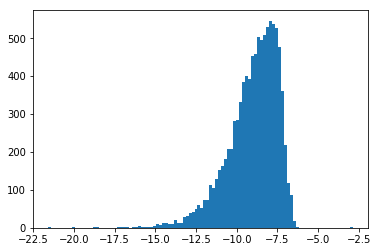

9424


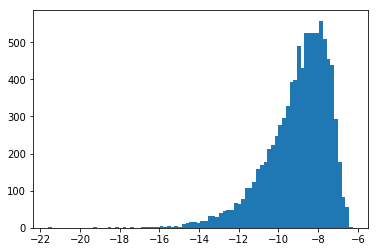

7535


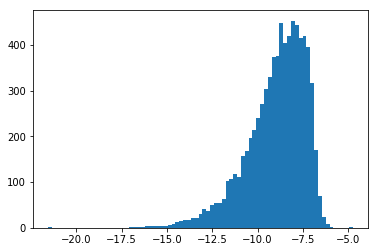

7328


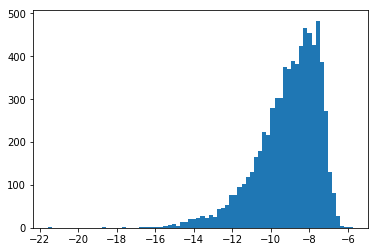

7232


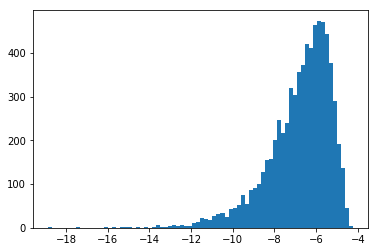

6859


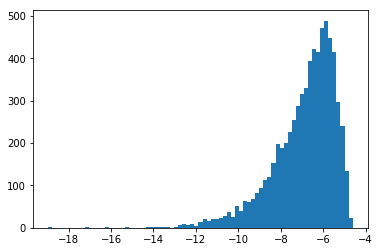

5186


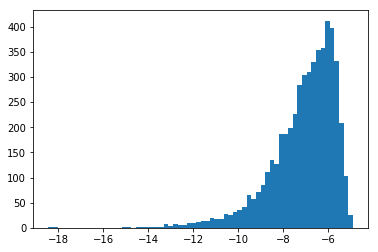

5746


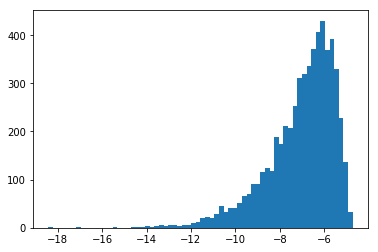

9750


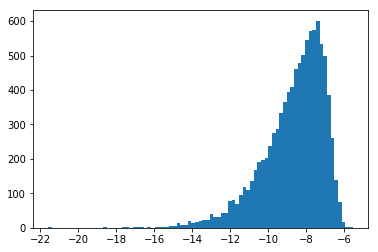

8831


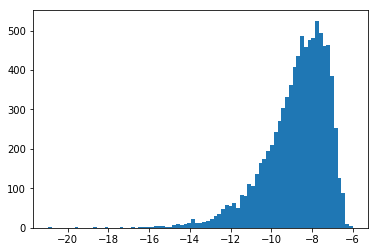

7822


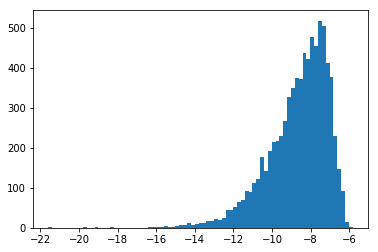

8843


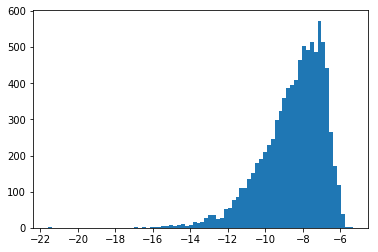

10495


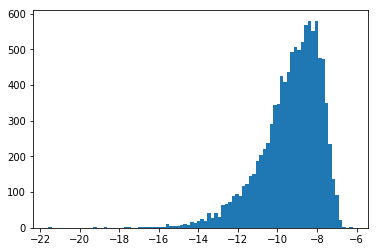

9463


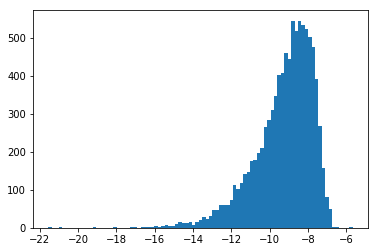

8461


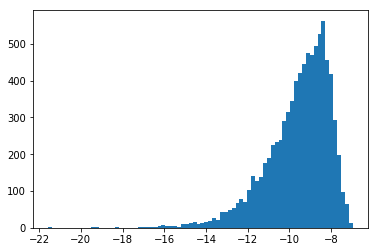

9664


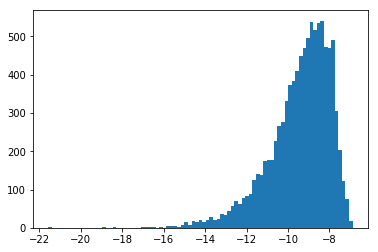

12591


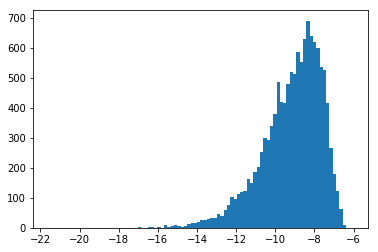

11886


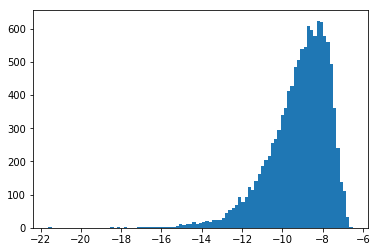

11596


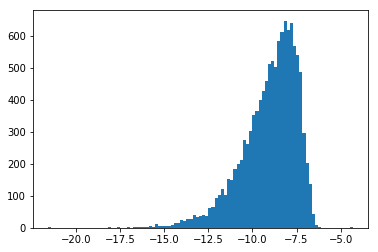

11657


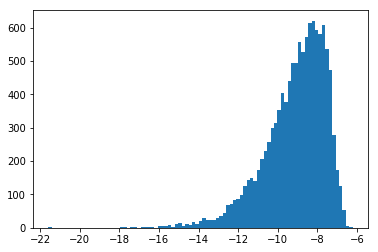

11706


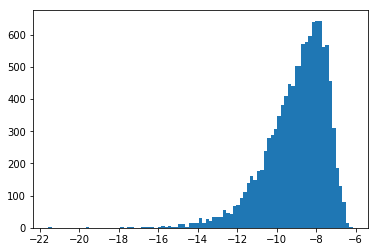

11482


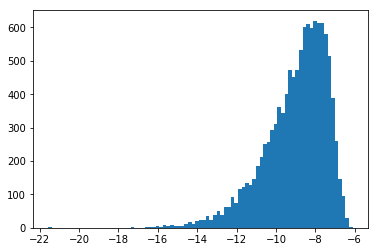

9666


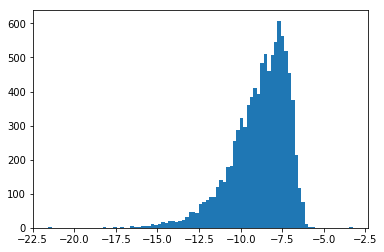

10508


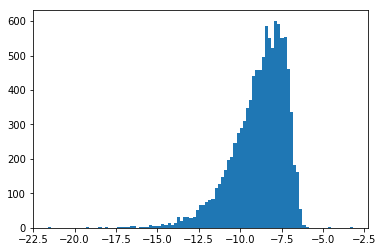

10296


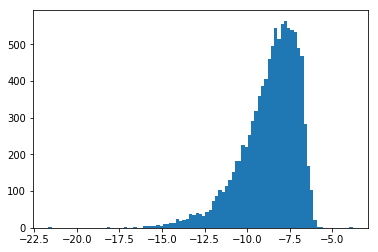

10073


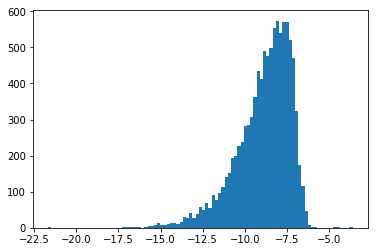

9681


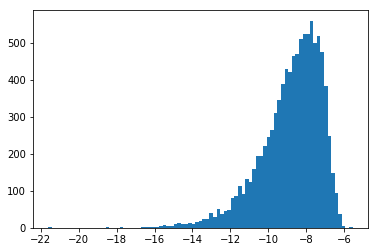

9120


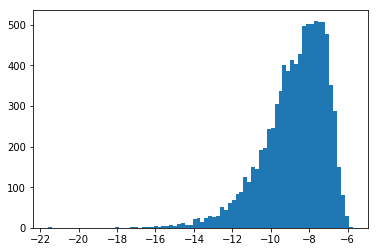

8672


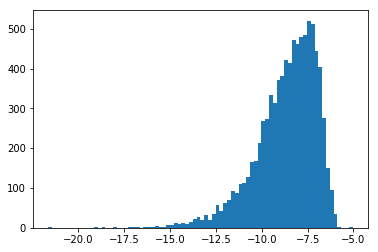

8612


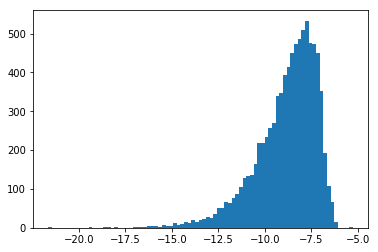

8268


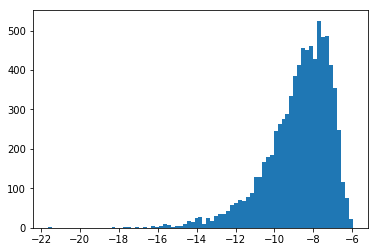

7509


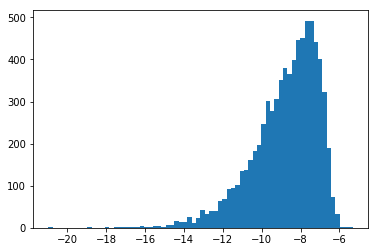

11401


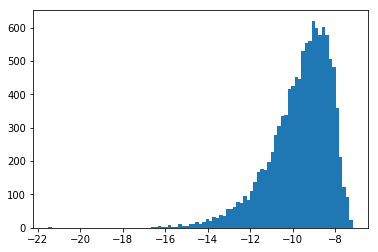

11352


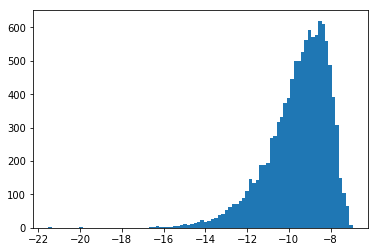

10505


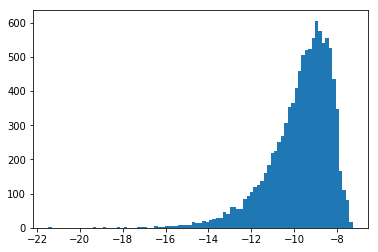

10626


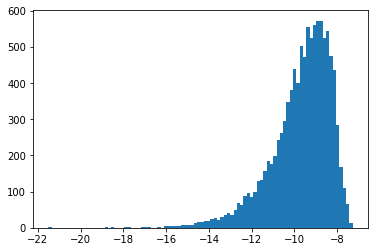

10357


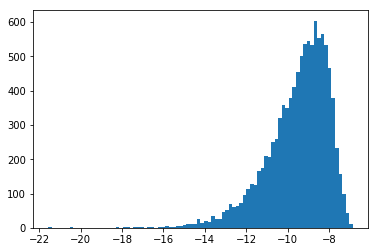

9915


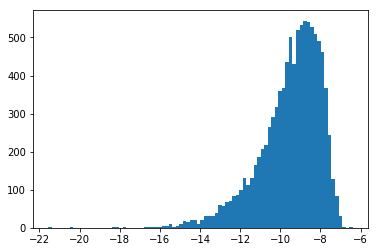

11276


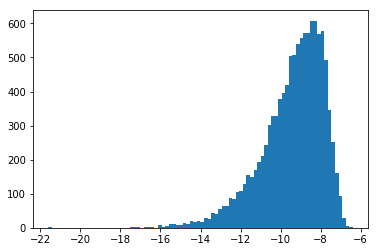

11244


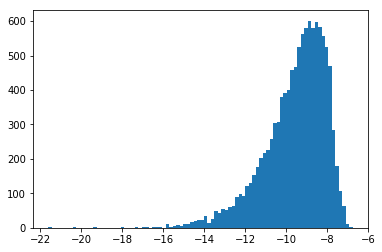

10705


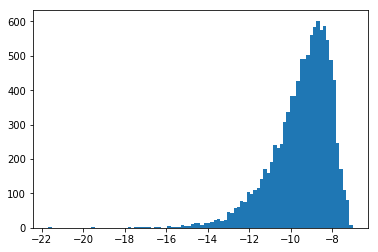

10837


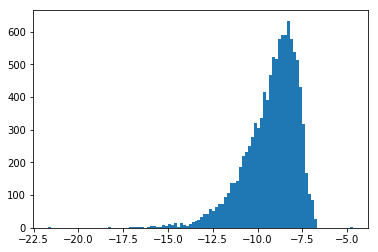

10971


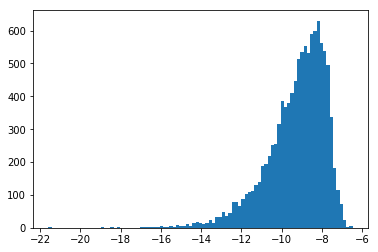

10995


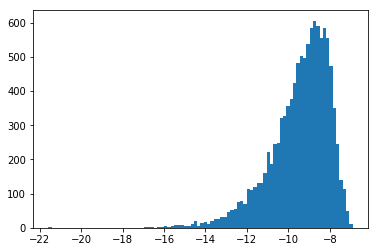

9921


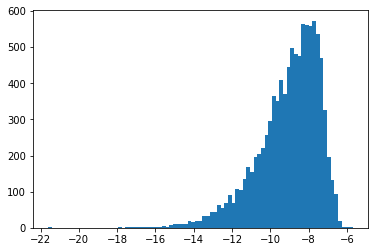

11114


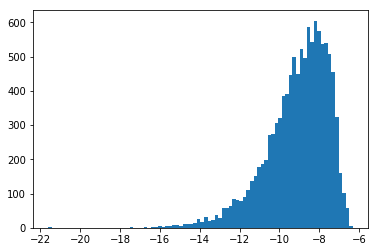

10796


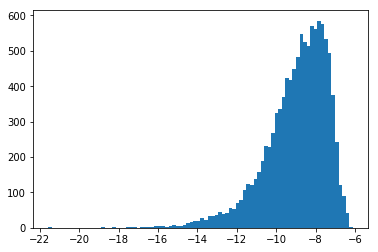

10728


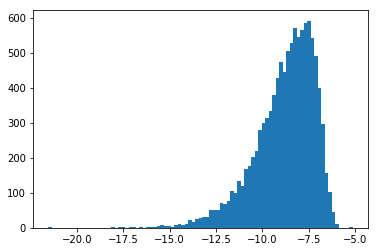

9967


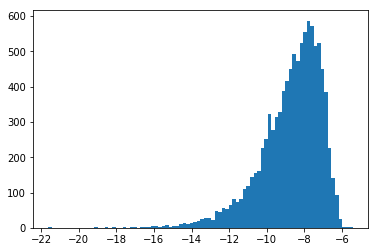

10474


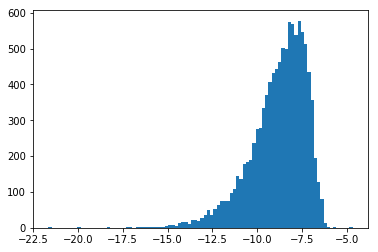

8105


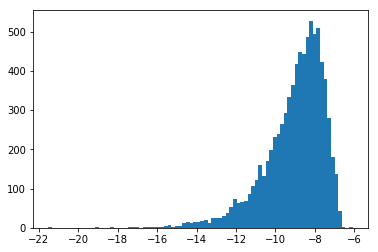

8436


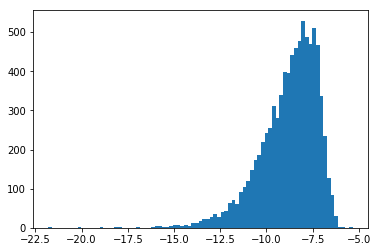

9180


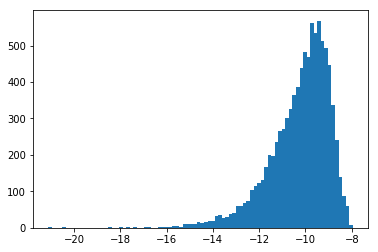

9550


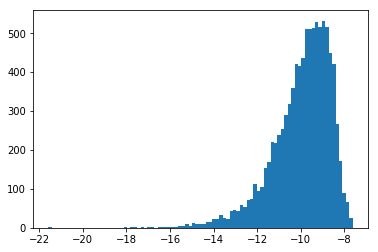

7843


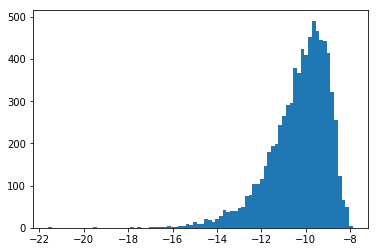

7208


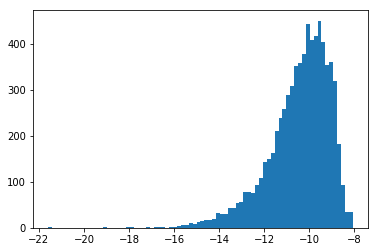

11711


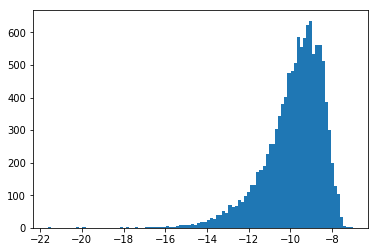

11744


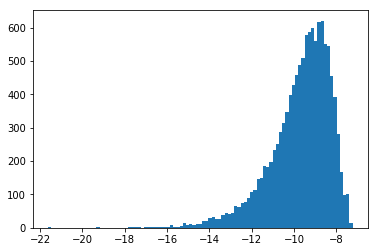

10930


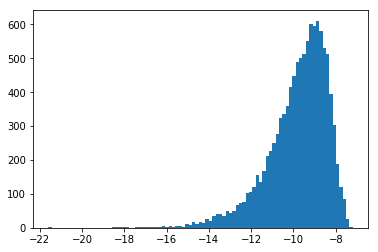

11103


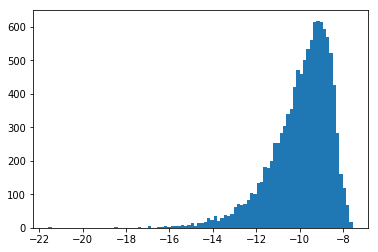

11945


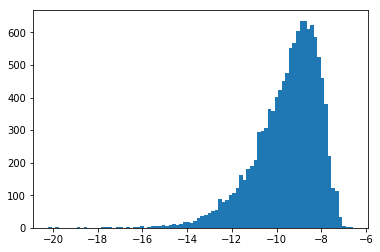

11595


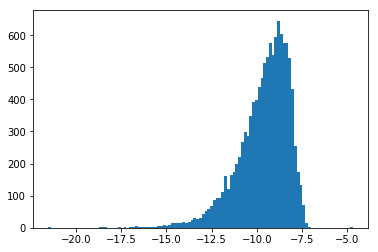

13033


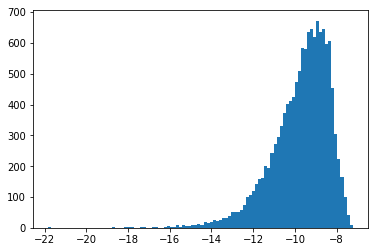

12480


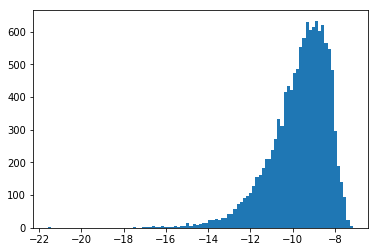

11297


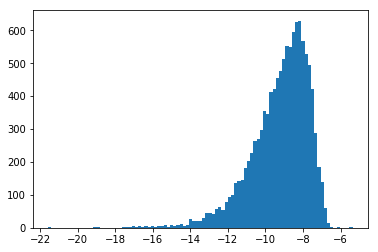

11038


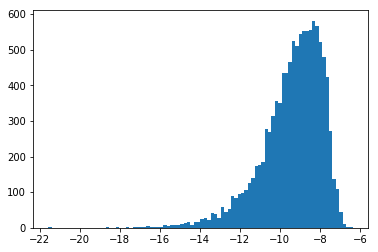

13157


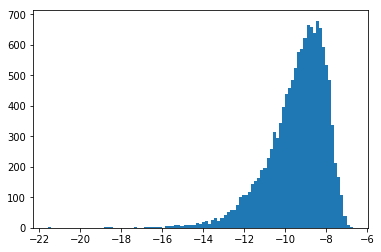

12195


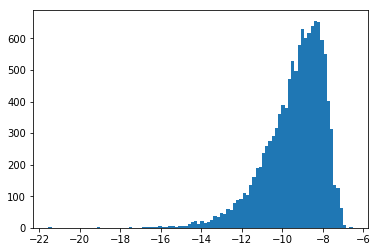

10455


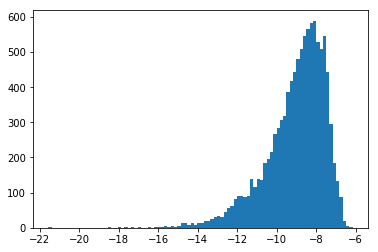

9833


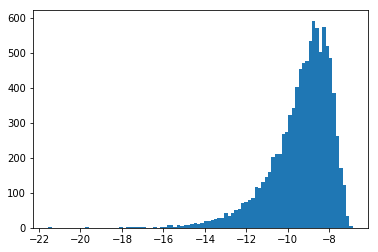

8782


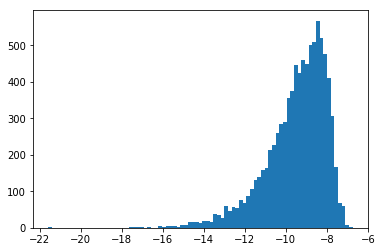

9293


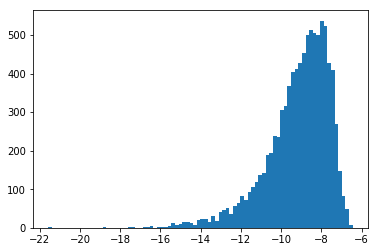

11169


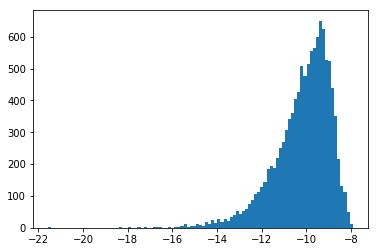

9330


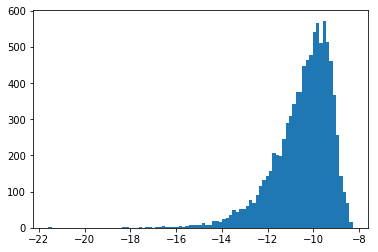

10024


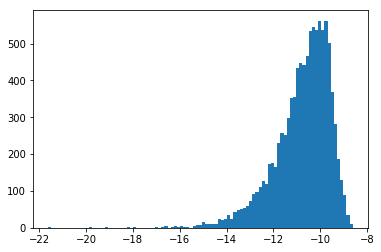

9078


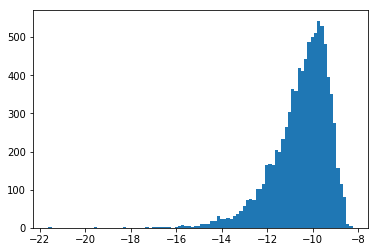

10914


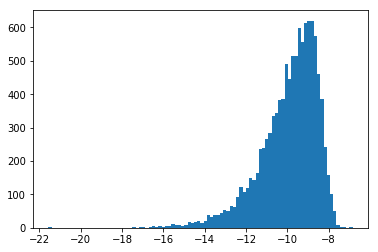

11026


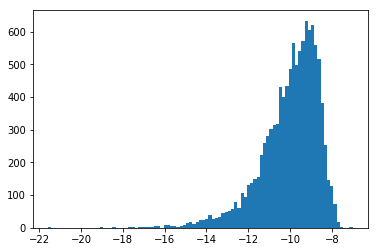

10602


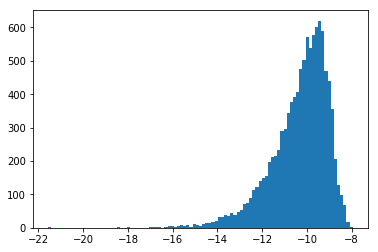

9980


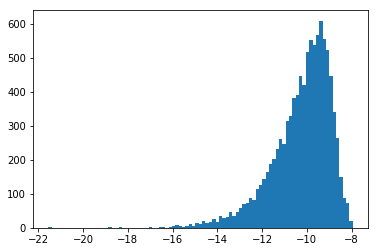

11514


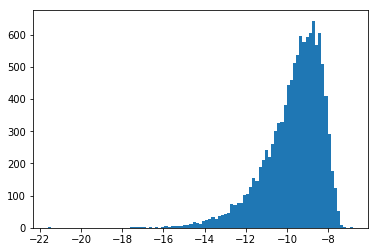

11989


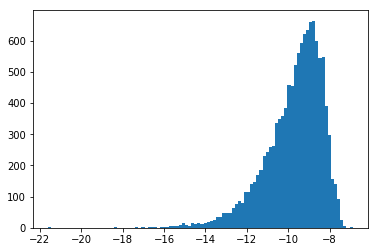

11433


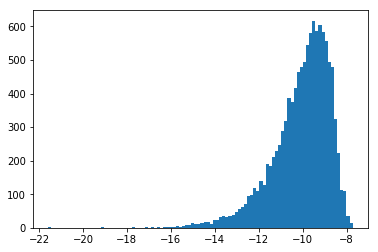

-9.20834819277


In [21]:
lowerMagLims = []
for channel in range(1,len(medians)):
    lowerMagLims.append(findLowerMagLimit(medianDir+'median_{}.fits'.format(channel),'test.cat'))
    
lowMagLim = np.mean(lowerMagLims)
print(lowMagLim)

In [22]:
newlist = [0] # correct as median 0 does not exist
newlist.extend(lowerMagLims)

In [23]:
len(imagelist)

53

/data/mj1e16/kepler/properDiff/diff_imNo0_channel1.fits


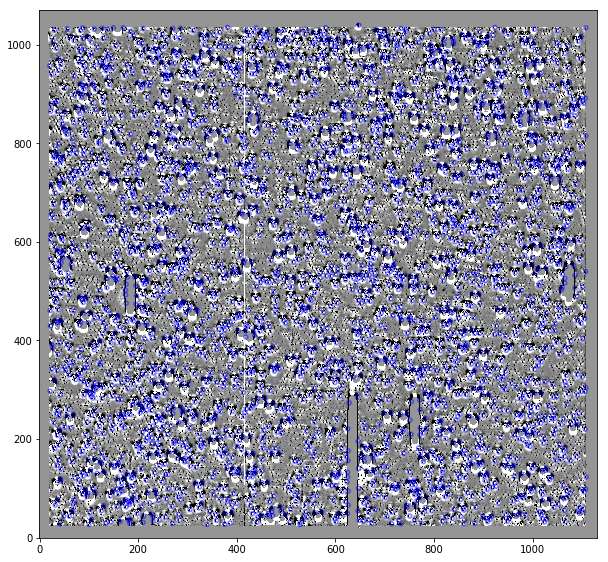

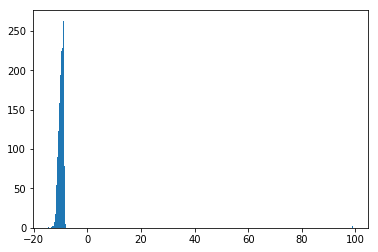

[[ 291.14154333   50.21634032]
 [ 291.18556745   50.17398335]
 [ 291.05383599   50.30551075]
 ..., 
 [ 290.20704398   51.05663052]
 [ 290.35569023   51.12367809]
 [ 290.64836415   51.2440234 ]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.2263 +50:15:58.3658': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.9646 +49:56:51.8731': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.1117 +50:17:47.8328': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/data/mj1e16/kepler/properDiff/diff_imNo1_channel1.fits


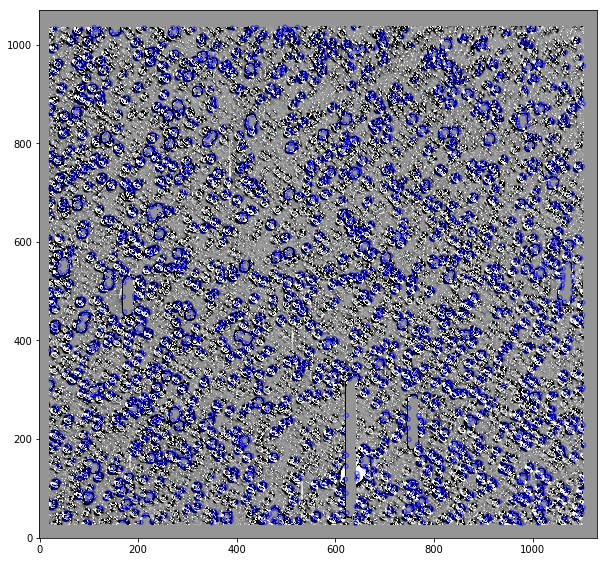

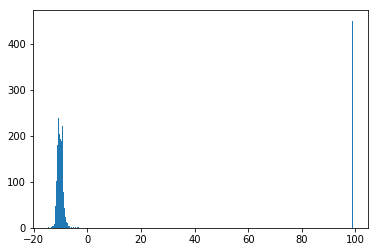

[[ 291.21590052   50.18096081]
 [ 291.18090966   50.21891073]
 [ 291.03296383   50.36525269]
 ..., 
 [ 290.47719434   51.16921481]
 [ 290.26430402   51.08472802]
 [ 290.89323778   51.34109578]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.8161 +50:10:51.4589': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:43.4183 +50:13:08.0786': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:07.9113 +50:21:54.9097': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/data/mj1e16/kepler/properDiff/diff_imNo2_channel1.fits


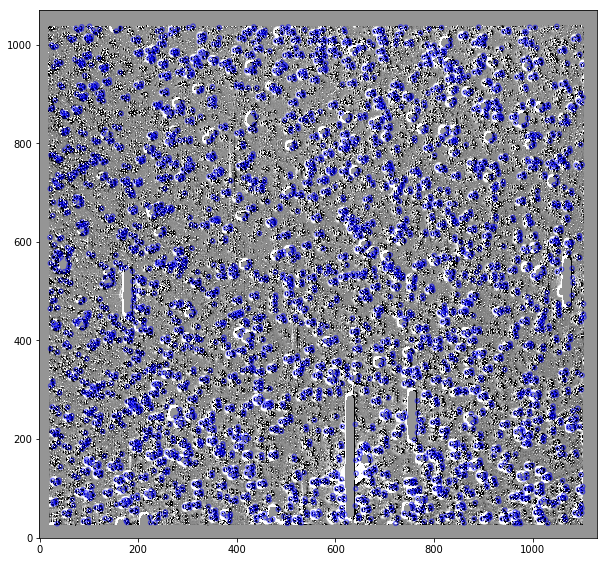

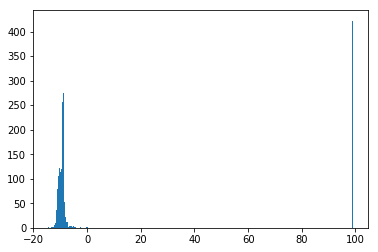

[[ 291.09539511   50.09654739]
 [ 290.64934359   49.91193027]
 [ 290.89405249   50.01471544]
 ..., 
 [ 289.78130715   50.78268251]
 [ 290.70655997   51.1703387 ]
 [ 291.12888181   51.34880096]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.8948 +50:05:47.5706': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.8425 +49:54:42.949': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.5726 +50:00:52.9756': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/data/mj1e16/kepler/properDiff/diff_imNo3_channel1.fits


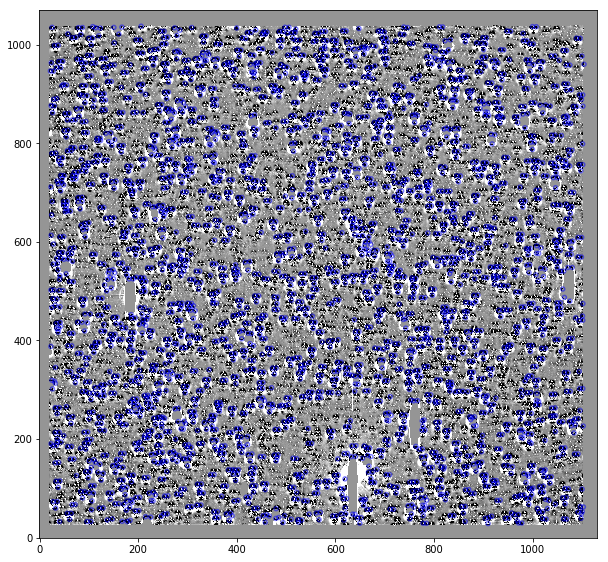

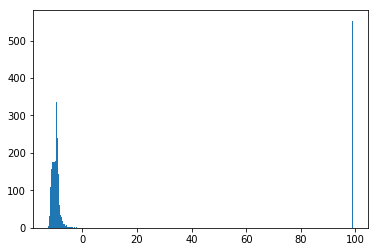

[[ 291.36893205   50.22477342]
 [ 290.65861501   49.93604097]
 [ 291.8899897    50.43044235]
 ..., 
 [ 290.54905366   51.19113213]
 [ 290.96562497   51.37292755]
 [ 290.99051714   51.3820898 ]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.5437 +50:13:29.1843': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:33.5975 +50:25:49.5925': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.8199 +49:55:50.4359': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.1458 +50:11:27.8647': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:53.9167 +50:16:46.5402': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:18.1842 +50:25:04.2182': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:06.9661 +50:23:59.9916': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:13.8526 +50:30:09.8005': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.1132 +50:06:14.9052': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:24.6739 +50:28:12.7688': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:57.1735 +49:59:03.7103': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:20.6656 +50:13:38.2621': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:25.3367 +50:27:17.4565': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.9521 +49:57:40.3766': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:18.8729 +50:32:27.8842': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:57.3296 +51:07:17.51': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.4789 +51:11:05.2634': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.1469 +51:11:21.7189': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.4081 +51:06:11.4318': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.3592 +51:06:49.8843': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.0028 +51:21:23.8677': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.2508 +50:59:21.2714': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:57.9504 +50:59:38.8756': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:20.2734 +50:55:33.4262': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:14.1786 +50:54:29.8508': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.5294 +51:02:05.3265': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:23.2073 +51:01:47.32': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/data/mj1e16/kepler/properDiff/diff_imNo4_channel1.fits


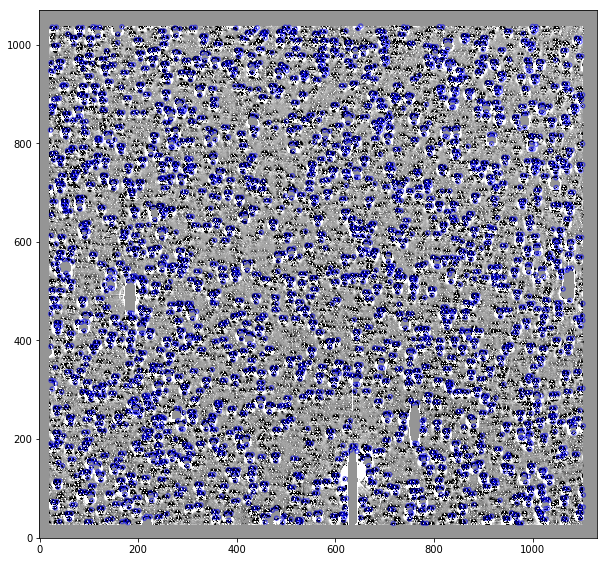

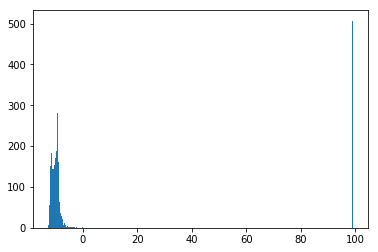

[[ 291.36819035   50.22584909]
 [ 290.65863531   49.9360039 ]
 [ 291.41180373   50.25347908]
 ..., 
 [ 290.54946611   51.19111783]
 [ 290.53928579   51.18751264]
 [ 290.96500497   51.3733202 ]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.3657 +50:13:33.0567': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.8329 +50:15:12.5247': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.3467 +50:00:09.598': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/data/mj1e16/kepler/properDiff/diff_imNo5_channel1.fits


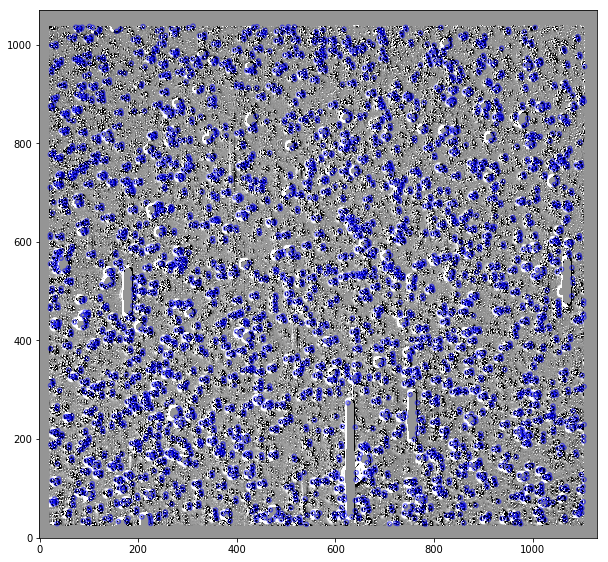

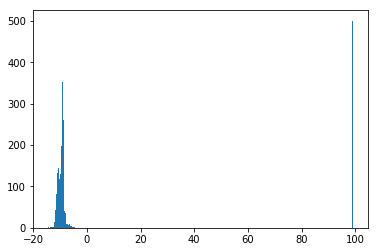

[[ 290.89450052   50.01477529]
 [ 291.11446095   50.10311786]
 [ 291.36087121   50.20217508]
 ..., 
 [ 289.97429205   50.80605469]
 [ 291.20361149   51.29714204]
 [ 291.24708      51.32696881]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.6801 +50:00:53.191': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.4706 +50:06:11.2243': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.6091 +50:12:07.8303': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:59.8072 +50:28:15.9316': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:32.6245 +50:13:31.904': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:43.2761 +50:27:01.8353': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.193 +49:55:50.2247': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.4911 +50:09:21.3408': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.3764 +50:03:00.1183': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.1594 +49:55:21.1833': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:20.9097 +50:19:21.2292': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:59.1939 +50:11:01.3711': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.1826 +49:56:52.5715': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:20.4848 +50:26:02.3439': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.0658 +50:09:10.045': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.0807 +50:05:36.9653': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.8289 +50:03:11.5772': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:22.709 +49:56:44.9989': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.4115 +50:12:09.5358': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:45.977 +49:59:52.7876': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:26.6177 +49:56:53.857': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.121 +50:10:39.4808': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:44.2083 +50:24:37.8066': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:43.7912 +50:25:00.592': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:51.5531 +50:07:42.4828': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:21.6799 +50:27:26.4727': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:52.1001 +50:31:42.8172': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:23.414 +49:59:13.1772': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.942 +50:22:14.3902': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:12.3977 +49:56:23.453': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.4274 +50:06:48.1684': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:19.3338 +50:17:36.7901': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:22.3226 +49:59:36.7003': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.8862 +50:10:10.295': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:03.6051 +50:29:21.4279': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.5371 +50:12:21.1889': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.1316 +50:05:16.7517': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:50.267 +49:57:46.3297': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:37.7065 +50:09:07.9078': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:50.8471 +50:29:06.062': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:31.3102 +50:13:36.4497': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:58.252 +50:23:18.7039': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.4149 +50:13:39.7005': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.2866 +50:01:53.8789': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:17.4284 +50:13:07.3335': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:13.7345 +51:08:32.2921': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:00.4004 +51:19:15.3893': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:09.2294 +50:43:16.478': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.9613 +51:15:30.989': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:23.7456 +50:50:11.282': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.3525 +51:01:13.2393': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:32.9328 +50:50:32.9015': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:00.0637 +50:53:18.0674': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.4144 +51:13:37.6006': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.5435 +50:45:14.2091': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:58.3341 +50:44:48.7676': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.3508 +50:46:04.3392': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:32.6398 +50:42:59.5498': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:06.8668 +50:39:27.2521': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:03.8228 +50:39:57.9647': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:22.5207 +50:53:50.7108': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.2659 +50:54:48.5063': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:41.5959 +50:43:20.2402': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.7831 +51:00:28.9266': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.2599 +51:02:01.8897': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:01.3247 +51:01:13.8327': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:06.2644 +50:44:23.7366': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:24.6495 +50:52:30.3426': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.2215 +50:58:12.6594': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:44.9737 +51:05:58.7206': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:12.9584 +51:15:10.9624': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.9988 +50:55:05.5045': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:22.1076 +51:14:00.3663': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.2659 +50:59:11.2854': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.7537 +50:55:23.0847': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.7812 +50:53:30.1996': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.488 +50:53:08.5868': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.2469 +51:07:07.6718': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:47.5153 +50:39:42.9753': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:42.9532 +50:38:50.1915': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.0511 +50:39:48.8414': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:38.1892 +50:37:33.8874': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:13.9623 +50:47:37.1584': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:49.2302 +50:44:55.5066': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:03.9674 +50:39:28.9694': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:19.0198 +50:59:28.9687': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.7066 +50:48:10.871': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:27.1443 +51:11:30.4108': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.4052 +50:48:57.4858': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:23.4644 +51:04:54.0159': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.706 +50:57:39.4363': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.37 +51:05:35.1133': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:37.6426 +51:05:10.1773': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.2037 +50:52:17.1756': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.1604 +50:57:27.3216': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:08.35 +51:08:17.455': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:26.5106 +50:32:50.2679': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:27.5248 +50:32:26.8334': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:45.29 +50:41:04.2835': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.1126 +50:42:58.1963': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.8801 +50:48:54.1683': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.7274 +50:48:15.797': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:43.3675 +50:45:59.5399': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:30.676 +51:08:51.9851': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:28.9676 +50:38:01.6294': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:32.3019 +51:08:33.4179': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:34.2539 +51:08:36.8864': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.3282 +50:34:15.2869': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:03.4533 +50:46:55.0737': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.3011 +50:52:39.8391': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:35.1649 +51:08:16.9573': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.0165 +51:02:48.8173': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:11.0458 +51:04:43.8971': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:07.3634 +51:04:54.8212': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:47.0226 +50:44:12.6014': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:00.9333 +51:03:48.1363': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.7587 +51:08:53.9676': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:50.9761 +50:50:04.4967': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:09.4839 +50:33:12.8996': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.898 +50:41:52.584': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:58.6653 +50:36:54.3344': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.4877 +50:37:15.3812': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:56.227 +50:36:48.0639': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:01.1764 +50:55:49.8323': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.7086 +50:40:09.9964': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:12.3 +50:44:31.6132': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:52.9861 +50:41:54.4578': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.1436 +50:51:29.1649': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:54.5937 +50:29:23.4569': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.4593 +51:03:04.5637': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:28.699 +50:33:09.5362': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.454 +50:50:07.7479': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.7253 +50:58:15.1447': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:07.3612 +50:35:32.3445': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:08.1569 +50:35:10.4583': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:51.427 +50:33:09.5886': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:29.9038 +51:01:25.1204': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:01.5535 +50:27:44.9581': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:23.175 +50:35:32.9241': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.4386 +50:42:50.83': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:14.6137 +50:53:18.3171': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:25.0721 +50:53:35.468': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:32.8579 +50:54:24.7432': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.4389 +51:02:33.347': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.4318 +51:01:11.3604': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.1278 +50:39:26.1737': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.4241 +50:56:12.6188': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:41.0257 +50:42:26.5215': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.854 +50:37:37.9476': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:28.3522 +50:46:04.7787': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:09.9974 +50:38:02.2121': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.9798 +50:57:48.4144': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:30.2803 +50:58:19.3509': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:24.6675 +50:50:59.9816': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.3322 +50:24:45.2163': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:13.929 +50:24:55.407': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.4752 +50:38:05.0364': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.5953 +50:37:56.8744': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:54.5213 +50:52:05.5919': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:23.6585 +50:24:32.5168': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.9829 +50:39:36.0828': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.2566 +50:44:58.464': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:46.3372 +50:32:26.7996': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:47.3533 +50:32:05.5882': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.5299 +50:37:34.4419': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.8462 +50:36:21.9391': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:07.0287 +50:52:35.5424': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:21.9469 +51:00:01.4271': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.7916 +50:33:29.3606': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.1992 +50:33:13.6402': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:08.6995 +50:33:02.274': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.9971 +50:35:31.1684': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.683 +50:46:26.2427': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.7496 +50:45:59.5827': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.9757 +50:29:27.1588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.2638 +50:35:21.1351': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.058 +50:36:12.4742': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.937 +50:35:50.6354': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.2941 +50:41:00.8265': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:01.2478 +50:49:49.8783': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:25.769 +50:32:58.5055': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.4165 +50:37:19.0995': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.368 +50:37:30.693': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:43.7248 +50:47:15.4854': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.2758 +50:33:19.5866': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.7436 +50:35:07.2824': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.4663 +50:39:54.6982': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.3211 +50:39:35.9755': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.3603 +50:50:25.9259': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:16.8421 +50:24:23.0938': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.2539 +50:38:22.5304': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:47.0641 +50:34:03.5604': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:44.6412 +50:25:31.8041': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:41.1366 +50:25:43.0071': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:42.3718 +50:25:28.1186': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:32.6933 +50:42:15.2382': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:53.9301 +50:20:13.0312': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.4503 +50:33:50.6462': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.0359 +50:39:39.3927': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.3321 +50:44:05.4685': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.1276 +50:25:53.0063': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.7071 +50:36:38.5543': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:04.4432 +50:19:56.1553': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:14.7426 +50:45:29.2345': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:05.3309 +50:19:34.0025': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.7306 +50:31:21.5614': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.1726 +50:22:28.199': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:08.8175 +50:25:25.7121': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.0845 +50:28:08.4729': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.7856 +50:28:19.2885': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:43.7316 +50:27:34.8747': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.3079 +50:32:10.6808': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.6353 +50:44:42.096': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.1418 +50:25:10.2667': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.8249 +50:40:44.6366': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.067 +50:41:06.7023': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.4538 +50:25:58.6244': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.5731 +50:26:19.8455': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.2659 +50:26:00.5876': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:08.7282 +50:47:27.3719': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:24.1952 +50:48:58.0391': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:14.3976 +50:17:18.54': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:49.1214 +50:50:36.6224': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.9771 +50:38:22.6927': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.6592 +50:24:36.345': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.7089 +50:29:35.4751': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:44.928 +50:31:22.429': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.0539 +50:30:59.8736': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.4675 +50:21:01.6611': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.6787 +50:26:17.5647': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.8224 +50:25:53.558': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:30.9806 +50:22:37.7089': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.8038 +50:22:14.8355': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.2839 +50:27:15.8867': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:50.7484 +50:42:40.0787': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:52.1133 +50:24:22.8674': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:53.1528 +50:23:55.0464': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:09.5136 +50:13:07.1543': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:07.8131 +50:25:14.995': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.9559 +50:37:06.9715': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.7245 +50:34:54.5864': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.2571 +50:14:06.257': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:15.3332 +50:18:53.3355': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:20.3346 +50:42:58.7558': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.1942 +50:13:38.8153': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.9697 +50:21:34.4052': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:57.3127 +50:21:44.5766': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.2318 +50:21:20.3973': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:58.3415 +50:34:04.3488': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:07.0835 +50:46:44.259': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.6013 +50:33:44.2636': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.3022 +50:34:12.4871': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.9013 +50:23:54.1474': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:29.0378 +50:23:33.7513': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.9204 +50:34:16.2036': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.3342 +50:22:53.5286': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.2499 +50:22:30.665': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:35.6723 +50:24:03.7031': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.5406 +50:38:33.572': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:47.6868 +50:36:45.5047': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.7816 +50:36:40.2547': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:24.1569 +50:14:45.8411': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:32.1284 +50:40:37.1358': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.6375 +50:16:20.662': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:13.6812 +50:37:53.6497': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:14.95 +50:37:37.4595': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:45.0126 +50:41:09.285': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.0609 +50:13:54.1158': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.9864 +50:13:29.4885': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.4514 +50:25:15.0294': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:31.2306 +50:26:42.6444': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.0733 +50:17:01.2216': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.0223 +50:16:54.7869': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.9514 +50:28:07.8771': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:59.9768 +50:28:04.2119': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:06.8239 +50:35:46.1047': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:38.7639 +50:07:34.6915': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.313 +50:30:52.9246': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:27.2008 +50:30:30.7852': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.2208 +50:32:59.7708': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.1584 +50:32:33.8996': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:58.1924 +50:32:23.6138': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.7921 +50:17:48.1357': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:08.1317 +50:38:41.436': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:09.4723 +50:38:19.5042': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.0185 +50:04:45.6481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:30.498 +50:17:06.7724': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:53.7584 +50:25:29.2617': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.1897 +50:14:58.3893': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.7973 +50:14:25.5585': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:51.2245 +50:36:46.4691': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:50.4506 +50:11:30.6087': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.9412 +50:12:48.8349': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:04.7169 +50:12:23.2083': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.8894 +50:29:25.3481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:45.235 +50:40:44.0912': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.5982 +50:07:24.5062': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:34.3257 +50:27:08.9038': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:33.8512 +50:26:41.6455': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.1666 +50:01:53.2604': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:51.7599 +50:33:21.1383': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:45.677 +50:39:25.1459': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.1611 +50:01:23.284': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.0018 +50:05:24.7733': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:55.0152 +50:33:52.6702': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.5437 +50:16:57.3882': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.6413 +50:09:18.9706': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:11.9597 +50:16:42.6735': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.4637 +50:02:26.7449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:28.2924 +50:29:52.5891': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:06.822 +50:09:03.955': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:09.8412 +50:08:50.9146': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.2513 +50:11:13.3327': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:32.2761 +50:10:57.334': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:16.7045 +50:16:10.411': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:30.0584 +50:34:53.9102': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:30.8299 +50:34:30.7178': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:42.8679 +50:29:54.2354': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:32.785 +50:35:02.8091': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:57.3278 +50:36:50.7353': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:20.4578 +50:32:54.2655': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:09.5674 +51:23:03.478': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.0325 +51:24:34.9831': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.2898 +51:18:02.9801': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.7462 +51:09:06.766': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:10.9157 +51:10:45.2973': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:55.0768 +51:15:00.8148': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:12.9927 +51:10:31.7064': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.6599 +51:22:39.4064': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:29.4541 +50:47:12.9921': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:15.2103 +51:03:21.6446': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.0292 +51:13:06.5067': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.1598 +51:19:05.4092': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.2187 +51:02:11.1784': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:04.8325 +50:50:06.6589': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:53.1475 +51:13:17.0448': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.6512 +51:12:41.0739': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:16.5703 +51:02:34.0849': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:18.911 +50:56:27.0725': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.3499 +51:06:32.7351': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.0254 +51:02:54.9031': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:06.983 +51:06:49.1367': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:17.9117 +50:54:35.413': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:15.2104 +50:48:33.1234': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.0049 +51:19:49.8052': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:23.5319 +51:01:41.0703': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:14.1974 +50:53:11.148': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:10.2396 +50:46:57.3313': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:49.6941 +50:51:09.6481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:46.2798 +51:03:18.5627': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.6171 +51:07:43.5704': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:23.5945 +51:00:26.3405': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.0161 +51:09:19.9839': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.0225 +51:12:12.0169': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:04.5549 +51:03:41.8891': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.2663 +51:05:42.5146': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:40.2674 +50:48:52.7088': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.6516 +51:12:45.3411': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:29.0297 +51:12:09.9706': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:22.1196 +51:12:30.3693': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:25.0851 +51:16:47.7197': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.3796 +51:22:08.1357': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:55.7323 +51:01:30.5423': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/data/mj1e16/kepler/properDiff/diff_imNo6_channel1.fits


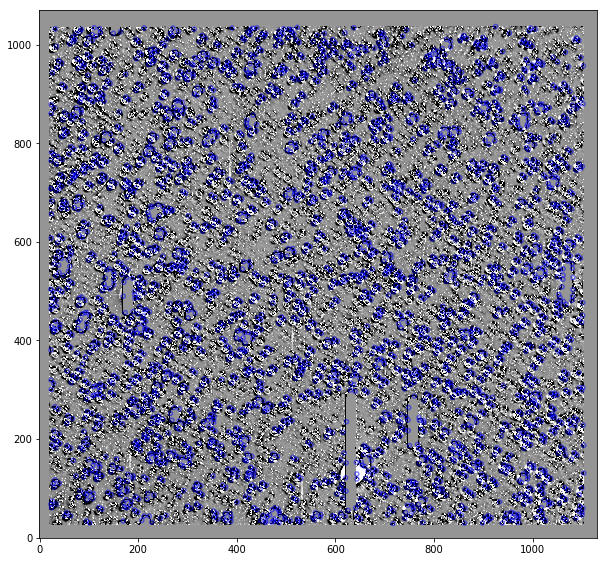

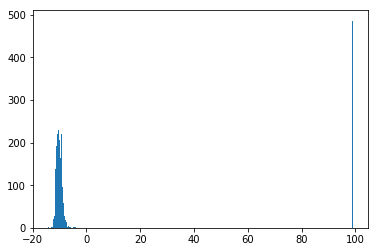

[[ 291.04467747   50.35336722]
 [ 291.17718499   50.22298995]
 [ 290.64778942   49.92562365]
 ..., 
 [ 290.45569824   51.14665682]
 [ 290.82450878   51.2995019 ]
 [ 290.55440574   51.2044065 ]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.7226 +50:21:12.122': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.5244 +50:13:22.7638': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.4695 +49:55:32.2452': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.8315 +50:11:03.2122': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:06.8239 +49:58:24.3405': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.7002 +49:59:50.672': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.7439 +50:16:33.9515': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:12.555 +50:12:17.9999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:52.4104 +50:16:37.7554': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:24.5586 +50:20:09.6861': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.874 +50:02:18.4588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.7719 +50:03:06.7007': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.7017 +49:59:13.245': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.5445 +50:06:32.3759': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.9055 +50:00:00.2951': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:35.0454 +51:16:52.1124': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.5928 +51:04:07.5443': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.926 +51:03:42.2294': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:22.9566 +50:56:00.1883': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.5665 +51:06:31.8782': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:30.3341 +51:09:43.1819': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.4572 +51:11:26.5776': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:57.7845 +51:11:06.1358': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:15.5145 +50:48:47.9944': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:51.0662 +50:52:06.4736': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.4496 +50:51:38.5005': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:09.8017 +50:53:51.2583': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:40.4927 +51:07:50.7817': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.9648 +51:07:38.6042': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.4192 +51:03:39.2427': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:08.404 +50:52:42.2513': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.1919 +51:06:01.2823': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.307 +51:10:01.7308': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:13.2663 +50:52:17.8674': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:40.7317 +50:49:11.0792': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.6819 +51:13:42.7565': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:23.1362 +50:45:58.9117': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:44.4244 +50:54:40.0905': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:25.5048 +51:17:09.1534': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:59.0718 +51:19:29.6875': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:29.1433 +50:51:35.9537': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.4442 +51:09:10.5512': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:28.8011 +51:09:22.4107': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.8447 +51:08:59.5077': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:30.0528 +50:45:06.3649': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.458 +50:56:03.7661': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.7946 +51:13:57.44': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:38.0459 +51:15:38.0968': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:58.0298 +50:45:29.2007': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.797 +51:15:51.2543': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:32.1982 +50:43:38.2919': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:33.3795 +50:49:16.1714': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.1797 +51:11:15.9992': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:55.6988 +51:09:47.9529': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.9137 +51:15:50.9569': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.7245 +51:15:22.5003': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.9353 +51:07:59.5818': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.6163 +50:41:56.7583': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.2138 +50:41:24.2916': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.6168 +50:58:13.7172': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.1689 +51:15:21.9321': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.9882 +51:06:40.5522': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.4485 +50:59:23.6778': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:44.8322 +50:46:07.5956': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:43.8951 +50:45:34.8572': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:00.0615 +51:06:58.7453': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.2577 +50:50:42.9285': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:14.0912 +51:01:41.1093': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:13.6486 +51:01:15.8856': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:55.316 +50:52:36.1234': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:59.1868 +51:11:29.5673': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:43.0136 +50:39:02.9694': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.2846 +50:56:46.4697': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.7711 +50:56:19.4834': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:40.6727 +50:55:53.9915': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:48.1404 +50:56:15.1339': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:46.7031 +50:55:45.282': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:13.728 +51:11:07.0402': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.2878 +50:48:02.5318': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:17.0207 +50:39:32.4217': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:15.9222 +50:39:04.1909': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.0315 +51:04:42.1914': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:12.579 +51:09:03.8207': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:11.3317 +51:08:38.3216': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:05.3232 +51:01:39.8856': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:27.8842 +50:39:14.5862': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:27.0341 +50:38:47.8336': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:05.8021 +50:48:50.0521': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.0299 +50:48:18.733': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:25.8296 +50:50:57.0548': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:15.6288 +50:49:10.2572': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.1117 +50:48:53.4263': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.2795 +50:48:20.6655': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:49.296 +50:33:08.9845': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.2448 +50:33:27.2062': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.4192 +50:33:39.2046': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:46.2956 +50:44:51.9633': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:43.7964 +50:44:23.488': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.6013 +50:44:17.1499': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:47.0264 +50:43:01.7546': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.2792 +50:43:51.5996': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.6033 +50:43:31.4443': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:52.1471 +50:50:25.1412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:46.5953 +50:30:41.634': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:39.0684 +50:42:22.2774': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:55.9419 +50:55:24.9596': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:01.9545 +50:56:10.9597': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.2121 +50:40:28.7826': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.7116 +50:51:42.2638': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:56.1211 +50:29:52.148': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:54.58 +50:29:16.2397': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:06.1798 +51:00:48.9849': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.5943 +51:06:02.6496': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.73 +50:58:02.0613': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:22.1257 +50:36:37.2656': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.5438 +50:36:14.8779': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.723 +50:44:39.1361': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.8665 +50:35:44.6677': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.3655 +50:45:59.0416': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.8787 +50:41:54.6606': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.2342 +50:51:50.1483': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.7804 +50:51:18.1631': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.7758 +50:59:13.75': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.2814 +50:37:49.8939': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.0299 +51:01:40.0793': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.9394 +51:01:12.2819': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:31.355 +50:28:02.9046': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:04.1305 +50:31:28.488': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:13.0308 +50:38:30.5432': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.7453 +50:39:49.6419': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:31.3957 +50:57:53.9697': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:22.7082 +50:26:14.2132': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:40.8816 +50:26:23.402': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:33.1562 +50:38:43.7656': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.878 +50:38:13.9368': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.1797 +50:44:51.6713': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.2098 +50:44:35.7083': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.4406 +50:51:54.1787': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.484 +50:45:25.7368': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:10.3753 +51:00:19.9412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.5166 +50:58:18.2231': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:35.8343 +50:18:21.0875': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:15.1097 +50:46:02.3369': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.8389 +50:46:47.7718': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.725 +50:57:05.5248': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.5284 +50:35:07.2094': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.3318 +50:35:15.3419': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:16.5485 +50:27:46.0327': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.5794 +50:36:33.3733': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:08.2407 +50:51:13.6706': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:20.3832 +50:26:44.4432': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.6381 +50:54:57.4586': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:52.6557 +50:54:07.557': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:25.1991 +50:33:38.4767': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:26.9512 +50:33:32.7452': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:06.3459 +50:37:55.7485': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.9656 +50:43:27.6953': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:47.5269 +50:23:12.1023': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:49.612 +50:23:29.6783': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.8361 +50:32:31.1765': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:37.3267 +50:51:58.8019': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:37.2486 +50:51:23.2449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.8404 +50:45:38.9733': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:11.1539 +50:23:34.0126': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.0875 +50:23:05.5914': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:05.7607 +50:53:43.5689': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.1496 +50:38:14.7403': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.9603 +50:32:25.8474': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:23.2174 +50:41:41.7907': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:53.5107 +50:20:02.9126': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.7833 +50:35:28.2786': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:49.2569 +50:18:46.1202': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:29.2846 +50:17:18.4921': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.3182 +50:37:16.1605': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:16.506 +50:51:27.2413': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:37.5614 +50:41:21.8774': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.6324 +50:40:53.35': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:41.8503 +50:41:05.439': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:08.0836 +50:49:30.1356': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:00.6886 +50:36:48.9971': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:16.9824 +50:19:06.1936': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.6961 +50:34:37.9483': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:37.8405 +50:39:45.9521': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.3804 +50:19:37.82': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:12.4406 +50:30:30.671': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:54.5968 +50:41:01.9471': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.7209 +50:21:56.0179': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:00.5354 +50:40:55.3147': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.1613 +50:47:42.5937': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.1646 +50:24:53.9253': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.1922 +50:14:25.7907': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:20.0243 +50:41:38.9993': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.726 +50:27:29.5374': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:04.5021 +50:27:01.5993': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.4005 +50:30:58.2334': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:30.5286 +50:22:28.4569': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:01.508 +50:38:30.533': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.1799 +50:14:39.7115': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.0721 +50:31:38.0984': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.7891 +50:36:31.8039': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.8859 +50:36:55.8172': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.0565 +50:28:14.5068': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.1827 +50:31:34.152': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:04.6706 +50:43:31.055': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.5301 +50:28:14.0328': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.6962 +50:31:00.3663': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.6827 +50:18:43.5757': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.8947 +50:20:05.9833': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:47.0483 +50:27:29.1224': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.5589 +50:13:28.0502': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.3912 +50:33:12.8301': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.347 +50:39:54.3533': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.5224 +50:39:55.4782': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.453 +50:25:08.649': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:50.6496 +50:38:42.5349': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.3741 +50:38:13.018': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:30.8381 +50:35:51.3162': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:17.0689 +50:09:55.4951': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:14.3626 +50:28:04.1884': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:08.5193 +50:20:43.5151': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:49.3107 +50:43:13.2305': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:57.8564 +50:44:10.4632': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.1586 +50:16:38.3566': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.7304 +50:16:45.7525': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.4454 +50:24:30.3198': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.2836 +50:09:24.5683': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.3544 +50:15:01.0829': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.7669 +50:17:59.708': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.3262 +50:10:57.5892': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.2427 +50:11:14.4586': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.6402 +50:16:13.7652': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:31.3291 +50:38:49.0482': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:25.3656 +50:37:58.6192': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:35.9385 +50:39:10.9444': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:39.293 +50:07:51.8399': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.0261 +50:08:55.889': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:27.1644 +50:31:14.367': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:20.9131 +50:29:50.3962': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:56.9736 +50:32:42.5806': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:08.7741 +50:40:28.7424': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.8282 +50:18:36.9913': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:15.8042 +50:40:28.0589': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:46.3343 +50:31:34.0923': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.6721 +50:07:11.3456': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.9418 +50:14:14.5407': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:53.5012 +50:25:18.9565': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.7726 +50:25:38.1878': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:08.446 +50:06:38.96': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:06.6759 +50:06:02.999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroq

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:22.8631 +50:32:47.7574': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:40.7167 +50:34:20.1576': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.7238 +50:10:03.621': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:13.2878 +50:06:01.5149': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:12.3284 +50:05:32.8588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.5214 +50:28:38.3448': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:36.2799 +50:32:20.5397': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:26.0097 +50:37:13.156': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.492 +50:21:10.5287': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.6224 +50:26:54.6318': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.4638 +50:06:48.3175': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:27.5257 +50:37:46.8169': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:36.836 +50:30:51.4771': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:41.848 +50:31:10.6262': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:42.9227 +50:30:49.3288': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:49.2102 +50:31:13.65': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:48.7082 +50:30:49.33': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:40.2993 +50:24:14.9185': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroq

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.476 +50:06:36.6773': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.1911 +50:15:54.0025': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:38.2959 +50:29:35.9251': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.4011 +50:22:58.1043': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.4166 +50:08:47.0912': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.9051 +50:09:43.088': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:14.9846 +50:07:18.7087': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:40.3049 +50:21:59.1826': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:41.2815 +50:21:45.1861': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:48.4489 +50:34:28.757': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:59.9041 +50:29:34.5798': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.6058 +50:13:23.3745': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:03.5639 +50:34:50.753': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.6184 +50:12:41.0162': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:58.129 +50:16:09.4769': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:45.5296 +50:20:22.7991': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:27.8293 +50:24:47.9614': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:06.8474 +49:57:49.8114': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.7421 +50:11:11.3321': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.3184 +50:20:22.5309': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:11.2601 +50:09:57.9852': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.719 +50:05:38.3622': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:17.5985 +50:10:22.1472': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.1937 +50:23:20.2335': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.1348 +50:01:00.1188': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:52.6267 +51:01:35.5094': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.6722 +49:56:27.327': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.0319 +51:09:47.5913': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:13.9309 +51:03:27.5784': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:45.8708 +50:29:17.7239': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.926 +51:23:38.2384': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.717 +51:04:43.9401': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:15.0546 +50:52:58.0177': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:32.0161 +50:47:19.6623': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:44.0955 +50:53:36.3805': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:31.9435 +51:24:04.8109': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:08.5874 +50:51:07.1804': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.7664 +51:10:14.7277': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.4065 +51:05:32.306': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/data/mj1e16/kepler/properDiff/diff_imNo7_channel1.fits


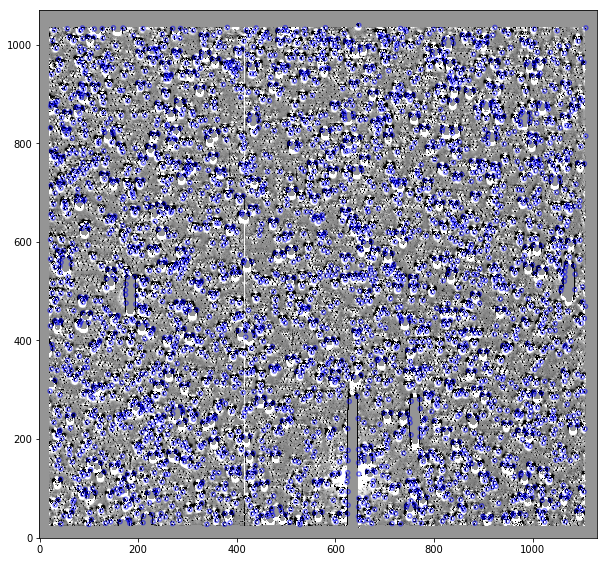

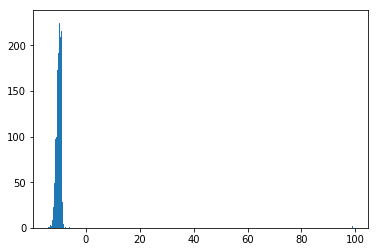

[[ 291.0105183    50.34844148]
 [ 291.00426502   50.3914057 ]
 [ 291.22193668   50.18140317]
 ..., 
 [ 290.90487026   51.34428013]
 [ 290.64877324   51.24402082]
 [ 290.814777     51.30850043]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.5244 +50:20:54.3893': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:01.0236 +50:23:29.0605': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:53.2648 +50:10:53.0514': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/data/mj1e16/kepler/properDiff/diff_imNo8_channel1.fits


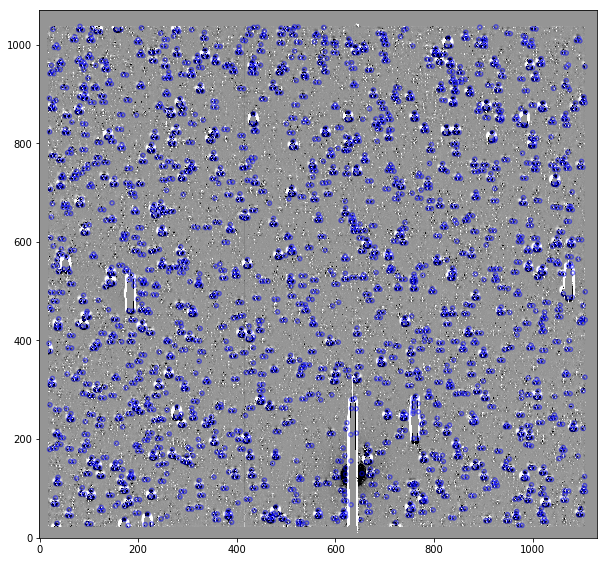

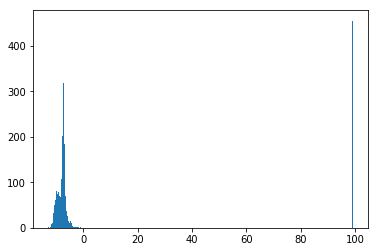

[[ 291.10945911   50.23395553]
 [ 290.66882501   49.92473891]
 [ 291.10167793   50.10039685]
 ..., 
 [ 289.95332665   50.93611065]
 [ 290.2034821    51.02653095]
 [ 290.47672451   51.14616985]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:26.2702 +50:14:02.2399': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:40.518 +49:55:29.0601': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:24.4027 +50:06:01.4287': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.2449 +50:10:21.414': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.127 +49:55:11.9818': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:17.1944 +50:12:28.5883': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:56.7828 +50:06:31.4356': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.7501 +49:56:30.4117': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.2624 +50:05:43.0751': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.9158 +49:56:56.6659': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.8274 +49:57:14.3446': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.8844 +50:10:45': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroqu

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:39.2195 +50:10:50.0657': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:00.2162 +51:09:25.6696': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:10.1016 +50:49:52.3987': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:15.1538 +51:01:49.3124': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:18.0401 +51:02:07.8484': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:38.5571 +51:04:23.1439': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.4575 +51:05:16.6138': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.2057 +51:08:55.739': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.742 +51:20:45.6746': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:38.6523 +51:21:02.7778': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:12.8382 +50:53:48.6203': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:16.5159 +50:53:45.0091': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.2688 +51:07:56.4185': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.264 +51:07:38.4047': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:38.5787 +51:14:15.6288': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:22.9259 +51:12:08.634': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:00.268 +51:21:56.5344': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:16.7321 +50:59:10.784': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.2404 +51:11:19.1195': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.0689 +51:11:37.6484': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:30.1329 +51:12:04.3174': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.8597 +51:04:44.8581': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:30.007 +51:16:38.9102': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:30.6046 +50:52:12.9171': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.9059 +51:06:30.7491': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:12.9874 +50:43:22.2616': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.151 +51:06:11.3725': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:11.2626 +50:54:11.976': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:22.9595 +50:55:40.4523': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:56.9989 +50:53:02.1324': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:09.0232 +50:53:22.5787': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.977 +51:07:00.8436': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:59.769 +50:39:39.5223': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.382 +51:10:22.5411': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:19.9958 +51:18:01.4662': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.1106 +50:46:14.7931': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.0561 +51:15:19.9786': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.9894 +51:15:38.4191': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:18.0749 +50:46:29.7664': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:05.6273 +50:43:37.0454': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:03.8515 +50:43:43.2309': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:15.3072 +50:45:10.7491': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:13.5895 +51:14:52.7691': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.5211 +51:06:09.0424': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:54.5903 +50:41:53.1188': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.3552 +50:50:54.1671': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.5474 +50:50:36.6591': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.8193 +51:02:44.8887': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.1935 +51:00:54.5035': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:18.6236 +51:01:10.132': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:54.5759 +51:09:54.5844': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.7531 +50:56:37.0975': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.9074 +51:09:36.0169': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.1752 +51:10:27.0687': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:07.7305 +50:45:20.1203': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.4065 +50:45:38.0853': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.1037 +50:51:52.4571': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:12.5412 +51:09:04.343': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.5613 +50:36:50.9543': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.8158 +51:08:48.1652': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.1241 +51:08:00.1139': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:01.7333 +50:36:21.4589': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:39.5381 +50:34:00.3272': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:48.504 +50:34:36.2885': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.4213 +50:56:59.4481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:39.3203 +50:33:36.3717': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:40.5734 +50:39:17.0001': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:43.2149 +50:39:33.7194': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:45.5837 +50:39:37.7817': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.1274 +50:43:32.8994': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:16.8512 +51:06:20.9977': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.7769 +50:43:15.3596': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.9024 +50:55:18.5901': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.7281 +50:32:37.8057': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:53.7539 +50:32:25.9145': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.8834 +51:08:11.2505': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:50.9201 +51:08:34.1224': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:52.8052 +51:08:29.8511': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.7583 +50:42:40.8615': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:52.0536 +50:49:07.9033': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.4323 +50:54:34.5246': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.5679 +50:39:12.4615': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.6707 +50:39:55.6471': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:15.2551 +50:31:46.3214': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:56.3227 +51:05:34.0412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:04.024 +50:29:29.4133': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:37.959 +50:39:10.634': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:09.7196 +50:35:02.4999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.7356 +50:51:16.5911': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.2513 +50:51:28.0546': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.7845 +50:48:30.0295': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:24.5587 +50:35:24.3755': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:36.6301 +50:48:47.5946': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:05.4908 +50:38:48.6744': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.9508 +50:38:48.2611': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:03.4489 +50:32:02.9013': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:19.9054 +50:26:22.5774': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:19.3243 +50:57:01.7218': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:21.8273 +50:57:18.2357': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.1399 +50:50:13.8838': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:36.3621 +50:27:06.4451': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.4203 +50:39:37.593': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:25.7623 +50:37:13.2363': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:25.0113 +50:55:28.7391': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:27.9166 +50:55:46.0603': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.1299 +50:44:15.9039': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:18.9623 +50:59:55.5621': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.4225 +50:33:01.366': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:22.8162 +50:22:24.9774': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:23.1875 +50:22:03.1318': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:58.016 +50:26:20.9726': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.4355 +50:55:29.7343': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.7589 +50:25:04.8064': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:52.902 +50:24:46.656': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:48.2266 +50:23:37.2766': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:04.6467 +50:25:25.8749': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:07.2147 +50:25:41.7612': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:12.5201 +50:32:01.1958': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.3609 +50:35:52.9286': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.6557 +50:41:35.4362': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.3283 +50:27:02.4465': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.3562 +50:39:32.9783': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:05.5502 +50:42:38.4241': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:29.3079 +50:50:16.1618': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:26.3741 +50:31:13.3387': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:05.2435 +50:53:45.5069': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.1529 +50:44:47.4334': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.9582 +50:45:06.7451': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.4664 +50:33:47.2749': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:49.0487 +50:55:52.2241': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:58.7438 +50:49:20.0715': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.7235 +50:48:59.9511': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.7723 +50:22:41.0437': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:12.6253 +50:26:39.4155': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.2716 +50:36:52.4255': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.2313 +50:21:26.7513': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:01.1553 +50:24:39.5508': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.9736 +50:25:18.7336': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:53.073 +50:53:26.9468': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:13.5073 +50:37:12.4314': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:58.5866 +50:47:47.6133': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:39.6037 +50:50:52.9966': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:36.0188 +50:50:32.8715': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:11.3844 +50:17:35.0905': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.7215 +50:45:23.8858': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:00.5011 +50:21:31.8566': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.731 +50:45:04.9218': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.4196 +50:41:08.7697': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:44.5013 +50:43:17.8735': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:46.2358 +50:43:10.8952': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:07.2997 +50:26:40.7266': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:09.9401 +50:26:57.6001': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:38.4415 +50:47:55.0025': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.1998 +50:17:37.7223': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.9376 +50:22:24.8369': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:34.6949 +50:34:30.803': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:23.2367 +50:32:36.8945': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.6528 +50:36:46.3101': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.5744 +50:43:09.9267': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.1451 +50:18:39.3783': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:53.2719 +50:34:26.1006': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:51.276 +50:27:52.9594': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.6053 +50:19:15.8063': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:40.1785 +50:19:32.0481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:59.5643 +50:33:37.3643': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.901 +50:32:22.5588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:53.5374 +50:32:39.473': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:11.9271 +50:46:33.6838': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.4569 +50:15:38.1814': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:33.7184 +50:35:30.2474': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.1598 +50:18:02.7852': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:09.7519 +50:38:19.5558': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:12.8189 +50:38:36.6397': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:24.482 +50:15:31.1003': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.0659 +50:16:12.624': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:25.6735 +50:26:36.0047': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:09.8391 +50:43:13.7003': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.122 +50:22:10.8868': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:55.859 +50:41:11.2412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:58.6658 +50:41:28.2785': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.714 +50:16:08.1751': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.9941 +50:16:30.6627': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.1665 +50:20:37.4184': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:28.0875 +50:42:40.9265': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:25.8719 +50:36:18.6099': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:36.37 +50:43:18.9006': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:28.3162 +50:17:29.8548': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:30.8126 +50:17:45.0566': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:40.7373 +50:12:22.3543': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:30.5209 +50:35:03.0908': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:41.8413 +50:11:30.032': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:45.1118 +50:11:56.2504': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:10.4709 +50:38:13.4362': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:13.2773 +50:38:30.0289': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:36.2535 +50:04:05.103': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:40.3776 +50:34:04.6363': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.4561 +50:06:43.1641': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.0303 +50:06:58.8823': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:34.5424 +50:26:10.1183': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.293 +50:26:52.6438': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:04.1939 +50:10:58.0691': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:09.7632 +50:28:54.8721': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.7815 +50:21:04.8195': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:18.0301 +50:29:32.4359': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:33.9703 +50:36:36.0865': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:36.5576 +50:36:52.9702': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.2965 +50:06:28.0176': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.1145 +50:10:14.9375': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:30.3453 +50:17:17.8867': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:56.1553 +50:25:58.7747': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.3626 +50:27:59.6514': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.9514 +50:04:52.445': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.1522 +50:09:30.237': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:22.3579 +50:02:08.4061': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:43.2263 +50:04:19.289': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:18.2131 +50:32:11.0506': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:13.6163 +50:30:17.1127': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:32.0405 +50:32:21.2026': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:34.8394 +50:32:37.2318': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:25.1875 +50:24:59.6651': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:50.8615 +50:27:25.5557': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:53.225 +50:27:40.5061': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.2303 +50:24:08.4931': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:28.8038 +50:24:25.2096': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.9188 +49:56:26.3469': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:24.1943 +50:29:14.3283': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.263 +49:55:57.0214': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.9691 +49:55:42.4714': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:47.1381 +50:53:54.0483': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:17.0781 +50:03:21.5535': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:19.4335 +50:03:36.5657': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:23.8233 +50:15:33.0823': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.7288 +50:15:48.9492': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:19.1222 +51:03:31.7977': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.6743 +51:06:01.2084': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:10.663 +50:50:47.4108': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.6952 +51:09:26.2055': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:40.142 +50:54:00.5744': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.178 +51:17:17.3264': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.3361 +51:11:43.6748': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:04.1236 +51:16:38.4591': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:17.2707 +51:17:41.3683': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:32.1229 +51:24:20.3009': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.4139 +51:08:46.2115': No astronomical object found :
  (error.line, error.msg))


/data/mj1e16/kepler/properDiff/diff_imNo9_channel1.fits


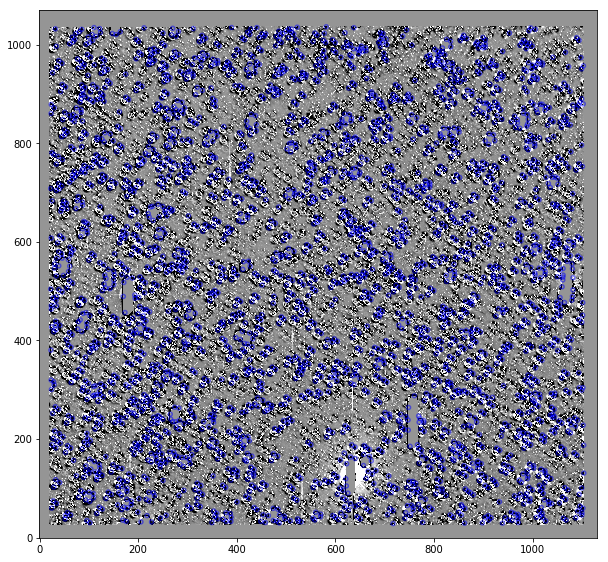

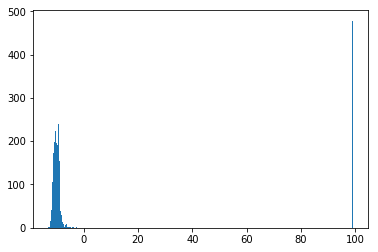

[[ 290.75425065   49.97154384]
 [ 291.36759741   50.21893004]
 [ 290.64757119   49.92457863]
 ..., 
 [ 290.74655253   51.28030606]
 [ 291.0441303    51.40279541]
 [ 290.45891059   51.15344473]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:01.0202 +49:58:17.5578': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.2234 +50:13:08.1481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.4171 +49:55:28.4831': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:34.5557 +50:26:06.8598': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:06.7654 +49:58:22.7583': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.3402 +50:19:28.7719': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.3857 +49:57:17.9573': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.3039 +50:11:05.266': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.3906 +49:56:34.3554': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.811 +49:54:29.7905': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:03.521 +49:54:10.1723': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:56.8859 +50:05:26.4144': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.249 +50:06:40.8167': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.289 +50:17:42.8411': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:25.5615 +50:20:38.9444': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:04.3181 +51:01:58.1081': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:05.52 +51:01:38.2266': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.7593 +51:04:44.6738': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.8166 +51:21:35.3183': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:26.9433 +51:21:04.3329': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:24.8553 +50:56:29.4822': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.2494 +51:11:55.2548': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.1996 +51:12:44.579': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:37.1509 +51:21:48.9151': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.4466 +50:51:38.6408': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:09.8026 +50:53:51.292': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.1205 +50:53:31.7446': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.3171 +51:07:55.6073': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:39.4047 +50:50:20.0913': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:41.5498 +50:50:30.0812': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.2098 +51:06:03.5293': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:40.0309 +51:08:20.6799': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.7569 +51:07:46.1826': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:12.4677 +50:59:42.2505': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:55.414 +51:08:59.6032': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.5429 +51:12:22.8004': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:17.1466 +50:51:33.9826': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.7547 +51:12:53.2466': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:44.4382 +50:54:40.8023': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:58.9878 +50:55:09.6874': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:49.7777 +50:47:56.1262': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.7605 +51:09:53.6105': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.2712 +51:11:49.4612': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:28.3 +51:09:10.9294': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.5561 +51:19:19.3265': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.0253 +50:52:54.7982': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:57.7125 +50:52:52.9998': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:54.8063 +50:40:14.8959': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.9525 +51:07:02.8527': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.3395 +50:45:01.221': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.7056 +50:46:20.3336': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.4934 +51:08:29.5322': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.6016 +51:09:23.1605': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.3373 +51:08:54.4257': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:50.3679 +50:56:04.2898': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.0628 +50:54:51.3299': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:47.1398 +50:55:42.1201': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:15.7032 +50:39:41.4839': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:55.0147 +50:41:56.481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.4508 +50:43:16.4774': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.9021 +50:52:24.3231': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.7621 +50:52:23.2724': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.0377 +50:51:54.352': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:38.8347 +50:46:28.0184': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:36.3462 +50:46:01.9008': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:37.2241 +50:45:37.3275': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:56.3805 +51:10:58.6892': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:56.1576 +51:10:28.8257': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:14.0936 +51:01:41.112': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.8039 +51:03:34.4649': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:32.3045 +50:38:05.8335': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.9526 +50:55:46.5361': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.221 +50:55:29.1164': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:44.3808 +51:03:00.2635': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.3985 +51:02:37.7987': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:14.5483 +51:11:33.439': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:47.8888 +50:56:23.1708': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:46.6365 +50:55:45.7636': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:15.9154 +50:39:04.2056': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:38.8529 +50:35:28.7298': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.4639 +50:49:59.1322': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:41.4462 +50:41:21.2304': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:46.3661 +50:35:26.7053': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:34.3146 +50:40:30.8467': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.1124 +51:05:19.4078': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:26.047 +50:32:36.3658': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:27.882 +50:39:14.593': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:09.073 +51:00:48.1344': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.5394 +51:02:25.308': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.5201 +51:06:09.9891': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.9587 +50:46:27.0657': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:16.8474 +51:01:15.0488': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:15.0727 +51:00:40.0681': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:03.9022 +50:47:11.6177': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.4749 +50:50:09.1186': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:33.7212 +50:49:45.1929': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:59.2034 +50:58:15.9076': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.7192 +51:08:23.6217': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:58.0711 +50:33:13.7456': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.9417 +50:51:41.4991': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:04.1293 +50:50:37.9181': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.699 +50:50:48.1487': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.3574 +50:49:55.014': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.2324 +50:58:44.6613': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:36.6823 +50:41:39.6174': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.2453 +50:40:00.201': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:23.5049 +50:32:51.6013': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.7045 +50:44:22.2913': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.9679 +50:59:40.7566': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:52.7318 +50:59:44.3476': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:01.1945 +50:29:46.4494': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:59.3371 +51:05:43.098': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:20.1989 +50:37:35.5483': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:07.8294 +50:35:49.7895': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.0785 +50:53:41.3735': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.3074 +50:53:06.7925': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:28.0356 +50:30:26.4411': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.4705 +50:42:44.0695': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.0275 +50:42:19.8123': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.2672 +50:42:03.3438': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.7733 +50:27:22.8402': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:10.7504 +50:26:54.6089': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:57.8382 +50:32:08.3803': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:22.1332 +50:58:25.7439': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:16.7489 +50:26:52.3797': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:05.0206 +50:31:58.7944': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:06.3555 +50:37:13.4163': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:32.978 +50:46:18.1775': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:14.7288 +50:50:46.6479': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.604 +50:43:38.4429': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:07.339 +50:54:56.4264': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:06.105 +50:54:26.8104': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:25.7922 +50:59:40.128': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:18.0791 +50:58:51.0788': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:21.3799 +50:58:19.7139': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.9979 +50:57:02.2729': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.6271 +50:52:32.3638': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:56.1404 +50:51:57.7549': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.9543 +50:50:58.625': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.9813 +50:27:07.6287': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:01.4726 +50:58:09.6775': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:49.4807 +50:25:05.0943': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:08.5123 +50:33:46.8756': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.6893 +50:55:18.4656': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:14.2963 +50:40:05.8224': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:30.0007 +50:47:48.5844': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.2174 +50:50:22.7608': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:59.8186 +50:50:03.2945': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:11.1017 +50:51:10.6371': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.2723 +50:39:26.6601': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.6621 +50:35:01.082': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:52.9097 +50:30:26.25': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:25.2406 +50:33:37.9209': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:47.6126 +50:23:14.1274': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:24.1889 +50:33:12.4791': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.8171 +50:45:38.4674': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:22.8471 +50:32:01.4562': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:51.1379 +50:41:01.1937': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.7359 +50:39:31.698': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:36.5297 +50:56:58.4275': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.9659 +50:32:28.1489': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.785 +50:45:38.9748': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:05.7263 +50:53:43.2165': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.194 +50:38:14.2513': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.9616 +50:32:25.8612': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:23.2128 +50:41:39.9418': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:16.563 +50:46:56.0291': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.1408 +50:46:26.0675': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:47.8204 +50:36:44.4838': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.2488 +50:37:39.848': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:21.5559 +50:46:18.5273': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:47.7945 +50:47:55.1219': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.3843 +50:29:41.1119': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:30.0924 +50:52:30.8896': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:41.8953 +50:41:05.3733': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:00.7352 +50:36:48.3912': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:26.4916 +50:39:24.9785': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:33.4397 +50:50:39.8999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:40.8929 +50:51:08.1368': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:39.0846 +50:50:32.053': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.9765 +50:26:39.0971': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:12.6454 +50:42:34.0275': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:04.1663 +50:47:02.3808': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:00.6113 +50:40:54.2473': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:48.8937 +50:45:26.9387': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.403 +50:30:19.8929': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.8082 +50:25:13.1915': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:17.7592 +50:41:21.4897': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:23.5534 +50:47:46.5045': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.3293 +50:41:24.4949': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:54.773 +50:50:03.232': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:00.6161 +50:13:41.059': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:53.8978 +50:49:32.2682': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:09.7691 +50:50:38.2414': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:59.5814 +50:13:09.1644': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.0423 +50:24:47.1064': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:05.8733 +50:43:59.8599': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:59.8351 +50:49:23.3115': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.5581 +50:14:18.4858': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:52.0664 +50:16:52.9105': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:26.5959 +50:20:34.4721': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.1083 +50:24:57.6924': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:59.6736 +50:41:20.9027': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:50.1701 +50:21:54.1502': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.6639 +50:21:35.0183': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.9224 +50:27:00.9922': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:58.6809 +50:34:25.2631': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.0471 +50:32:45.2408': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:36.324 +50:37:45.1153': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:05.0249 +50:46:06.5635': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:18.721 +50:10:23.8131': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:59.0681 +50:27:10.0633': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.7503 +50:16:25.4661': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:09.8398 +50:45:29.9954': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:09.7165 +50:21:13.0867': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.9746 +50:25:13.2587': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.2687 +50:31:27.5478': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.9407 +50:07:59.8497': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:13.5703 +50:38:34.1499': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:44.2685 +50:10:39.4596': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:41.9098 +50:10:10.7178': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.2906 +50:23:00.6009': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:53.0919 +50:41:33.4737': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.2689 +50:10:57.8088': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.3177 +50:11:14.3766': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:27.3818 +50:38:14.8118': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:24.5896 +50:37:55.5522': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:23.3297 +50:37:22.067': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:39.3421 +50:07:51.754': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:53.9881 +50:34:23.0707': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:27.0768 +50:31:14.3209': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.2166 +50:19:26.2707': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:36.915 +50:18:55.9927': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:37.8487 +50:18:36.0691': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:04.8646 +50:39:42.1958': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.0995 +50:12:16.243': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.9605 +50:11:41.0974': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:31.4018 +50:41:12.6426': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:46.0463 +50:11:56.3369': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.7453 +50:11:34.5799': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.136 +50:14:27.3116': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.3587 +50:14:55.7958': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.0209 +50:30:50.4323': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:18.0853 +50:20:17.4267': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:34.6936 +50:34:06.202': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.9659 +50:04:44.6346': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:40.0511 +50:39:52.662': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:45.009 +50:39:21.5869': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:47.8782 +50:40:24.8281': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:05.3309 +50:29:22.5696': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:47.118 +50:08:56.2458': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:52.1731 +50:33:23.1293': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:08.3766 +50:10:15.8037': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.6217 +50:12:55.9253': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:07.1013 +50:16:23.5999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:07.7447 +50:09:47.1132': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.284 +50:09:21.0277': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:42.4377 +50:25:39.4339': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:34.4658 +50:29:44.8469': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:18.2673 +50:34:35.3348': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.4129 +50:08:11.8228': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.8802 +50:10:24.6786': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:38.1486 +50:11:13.5382': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.4854 +50:06:37.1081': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:04.5164 +50:06:25.1951': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.2822 +50:22:57.6525': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.0867 +50:22:29.4586': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.7997 +50:02:26.4125': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.6017 +50:01:50.7059': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.2426 +50:07:18.3921': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:59.3724 +50:22:56.5269': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:58.5731 +50:29:05.3162': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:18.625 +50:31:04.3303': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.8109 +50:10:56.3331': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:46.7218 +50:20:53.0775': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:17.3097 +50:30:32.183': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.4158 +50:13:42.6638': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:19.1917 +50:17:28.9886': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:42.5986 +50:19:47.2819': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.5563 +51:07:32.8076': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:49.8607 +50:30:37.2132': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:24.5138 +49:58:46.3239': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.9357 +50:20:01.7476': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.9051 +50:00:01.1686': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.6898 +50:19:33.3538': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:23.2581 +49:56:58.4107': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:12.1337 +51:01:48.6052': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:38.7932 +50:53:12.4791': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:50.7301 +51:09:46.8327': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:32.4529 +51:24:04.1151': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.3083 +50:18:09.8896': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:23.651 +51:04:48.7993': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.1686 +51:05:58.1698': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.5713 +50:55:59.602': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.4722 +51:21:47.1539': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:00.0661 +51:22:09.8356': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.494 +51:11:49.0009': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.7514 +51:10:15.8477': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:15.013 +50:52:58.2034': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:17.8247 +51:17:43.1256': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/data/mj1e16/kepler/properDiff/diff_imNo10_channel1.fits


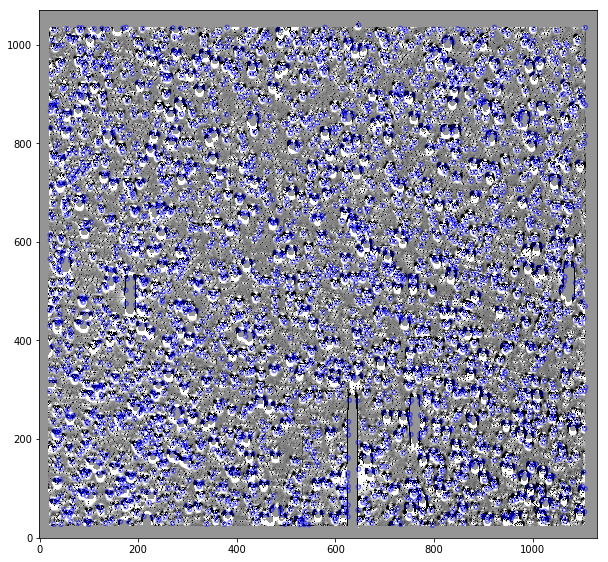

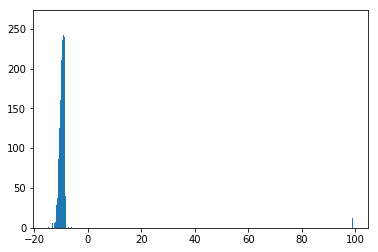

[[ 291.35001065   50.20475551]
 [ 290.98791269   50.0547408 ]
 [ 292.10742957   50.50978628]
 ..., 
 [ 291.18799925   51.41258009]
 [ 289.66643312   50.78703513]
 [ 290.1306761    50.9810305 ]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.0026 +50:12:17.1198': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.099 +50:03:17.0669': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:25.7831 +50:30:35.2306': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:59.9634 +50:16:21.6501': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.9397 +50:13:23.4097': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:03.5305 +50:10:41.5431': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:25.0889 +50:07:38.6323': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.1645 +50:02:17.8446': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:17.6054 +50:00:39.7363': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.472 +49:58:58.0605': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.2089 +50:09:22.9027': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:28.8062 +50:21:00.6915': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.7566 +50:03:00.8374': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:37.7677 +50:15:51.0071': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:04.236 +50:31:06.5074': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.0631 +50:12:42.9916': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.546 +49:56:37.54': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:36.8994 +50:16:11.7502': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:31.8912 +51:22:29.641': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:55.3752 +50:47:52.7034': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:04.4123 +50:48:49.6825': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:07.4325 +51:13:02.5966': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:38.8805 +51:16:12.5208': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.6389 +51:16:47.1893': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:34.8085 +51:21:31.7561': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:36.5802 +50:50:50.6457': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.9555 +51:00:19.7179': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:29.3534 +51:14:20.8026': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:15.6636 +51:00:34.8109': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:24.3343 +51:01:29.8853': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.1464 +51:16:56.0767': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:15.9984 +51:18:17.0567': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:09.0018 +50:59:06.7705': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:14.9357 +50:53:01.0738': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:50.6747 +51:09:00.571': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:53.0114 +50:50:40.3081': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:08.3086 +50:57:50.1765': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:38.1166 +51:13:07.3543': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:40.9686 +50:48:40.1759': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:45.9612 +50:48:32.7021': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:45.8312 +50:54:39.4908': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:14.1629 +50:57:34.987': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.6129 +51:17:22.0186': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:45.8578 +50:47:33.6438': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:21.248 +50:51:10.8496': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:34.3318 +50:51:43.9037': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:03.5378 +50:54:44.6492': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:03.0852 +50:54:28.3291': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:53.5814 +51:05:25.7435': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.6122 +51:15:45.6016': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:12.2889 +51:01:03.6308': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:18.2903 +51:07:01.9883': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:13.477 +51:18:32.7024': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:22.6126 +50:42:07.4296': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.84 +51:07:11.6771': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.8941 +51:18:12.4904': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.2316 +51:18:24.9076': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.3662 +50:56:12.7429': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:50.1616 +50:56:11.1835': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:20.835 +51:17:52.598': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.8925 +51:10:36.7891': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:04.6028 +50:57:28.4574': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.3729 +51:04:42.7856': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:22.7184 +50:58:36.263': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.9973 +50:42:49.6577': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:26.6695 +50:46:31.9916': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.034 +50:57:12.0025': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.2455 +50:59:21.499': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.0739 +51:07:50.5858': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:13.4073 +50:49:58.3055': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:06.0871 +50:55:21.5383': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:08.5969 +50:55:19.252': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.5646 +51:10:58.6262': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.1195 +51:10:41.3784': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.2466 +50:51:52.5437': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.7187 +50:53:18.9115': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:01.3287 +50:53:05.8742': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:28.9867 +50:37:30.2837': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:38.1432 +50:37:42.1648': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:13.8603 +50:47:45.472': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:13.7485 +50:35:03.8763': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.196 +51:04:41.7208': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.9539 +51:08:31.1301': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.5576 +50:54:00.651': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:28.5662 +50:35:05.3906': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:39.1666 +50:48:46.9646': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:10.8157 +51:10:15.4018': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:46.5181 +50:48:44.9205': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:33.2043 +51:05:38.0836': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.7531 +51:05:30.8569': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:41.9088 +51:05:45.5006': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.0859 +51:08:00.6036': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:03.2041 +50:37:01.6695': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:33.5835 +50:39:33.7322': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:00.7104 +51:01:15.0381': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.8873 +50:46:03.0953': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.2687 +51:09:05.052': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.1221 +50:44:21.3687': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:43.3024 +50:46:09.504': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:54.6269 +51:05:16.5527': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:51.1084 +50:33:48.7165': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:54.1515 +50:33:37.0046': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:47.2986 +50:45:21.0234': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.5424 +50:58:19.5023': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:25.4371 +51:01:25.5717': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:44.0459 +51:08:41.4013': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.9928 +51:01:18.0686': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.9171 +51:03:02.9777': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:49.1979 +50:31:24.9247': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:07.451 +50:33:16.3158': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:22.4597 +50:34:50.3257': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.5184 +50:42:20.267': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:09.3724 +50:57:34.034': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:14.0838 +50:39:31.445': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:47.6072 +51:06:42.5516': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:37.0217 +50:41:08.4561': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:50.4894 +50:48:43.6172': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:13.2153 +50:44:21.4997': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:52.4963 +51:06:32.4979': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:06.5075 +50:31:05.0968': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:42.6041 +50:34:10.1902': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:51.8829 +50:47:33.6707': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:36.537 +50:52:06.9232': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.9661 +50:58:34.4682': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:20.3762 +50:31:08.171': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:37.7049 +50:51:29.228': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.8563 +51:01:37.8099': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:08.3278 +50:35:20.8768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:33.8856 +50:44:10.0086': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:41.6167 +50:44:13.3249': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.9941 +50:57:50.4687': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:30.3947 +51:01:16.8344': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:47.2208 +51:02:17.1526': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:24.1466 +50:29:07.1099': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:45.9689 +50:31:24.7376': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:28.9009 +50:47:45.6325': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.1879 +50:53:41.6151': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.5708 +50:39:03.7933': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.1028 +50:45:37.1203': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.9795 +50:46:31.637': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.1415 +50:38:04.4803': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:12.0472 +50:32:04.7259': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:04.0741 +50:37:23.8108': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:35.4087 +50:46:52.3768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:24.5901 +50:51:10.7598': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:05.7947 +51:01:18.1957': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:32.1079 +50:26:43.3145': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:11.1407 +50:55:15.0461': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:21.3547 +50:55:56.6197': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:30.5321 +50:57:11.0944': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:22.1214 +50:30:56.8928': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.1568 +50:36:49.3322': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.8531 +50:48:37.2212': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:21.5989 +51:00:01.1627': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:28.3892 +50:24:20.6485': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:14.8426 +50:29:19.782': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:18.2661 +50:22:08.5996': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:25.2283 +50:20:06.1385': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:32.1958 +50:18:38.2221': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:34.6027 +50:48:26.3207': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:29.0083 +50:59:50.97': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.703 +50:38:42.2806': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.6617 +50:46:52.8556': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:27.7521 +50:59:15.5339': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.6011 +50:45:10.5812': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.5812 +50:48:47.1604': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.0685 +50:28:21.7741': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.1358 +50:28:35.2637': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.397 +50:41:49.8853': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:32.9123 +50:46:44.2424': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.6569 +50:44:09.1045': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:05.9388 +50:43:26.0993': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.5073 +50:51:44.0783': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.7991 +50:27:03.4627': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:48.5626 +50:34:49.2813': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.2375 +50:49:42.6802': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.7775 +50:26:57.7005': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.9973 +50:23:18.7635': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:10.0398 +50:29:51.8415': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.8229 +50:53:59.0066': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:52.6094 +50:39:23.9718': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.9648 +50:27:17.6596': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.7567 +50:45:00.7066': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:37.4862 +50:43:08.8368': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:12.6687 +50:46:38.9241': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.0294 +50:46:29.7923': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.0195 +50:37:18.1561': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.8668 +50:39:28.4432': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.8042 +50:22:55.235': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:46.3267 +50:54:46.3344': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:49.6187 +50:18:15.5461': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.9158 +50:40:59.1235': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:27.9701 +50:46:05.1963': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.4411 +50:30:24.2599': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.4939 +50:29:53.9164': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.5354 +50:35:28.8548': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:25.9303 +50:45:05.1577': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:41.6119 +50:15:45.6762': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:25.5877 +50:44:32.9446': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:07.4721 +50:17:56.5507': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.6481 +50:26:18.3406': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.2292 +50:33:16.4044': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.3227 +50:43:28.9527': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.6452 +50:22:20.2931': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:46.9862 +50:51:18.7227': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:09.0639 +50:23:00.1283': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.2458 +50:23:30.9959': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:41.9531 +50:43:56.1348': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.436 +50:31:30.0557': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.9179 +50:30:57.7284': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:08.6534 +50:45:51.1235': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:16.4078 +50:46:37.0873': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:00.0255 +50:50:56.1823': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.7839 +50:42:06.8632': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:11.6235 +50:14:35.9551': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:41.3566 +50:17:40.6492': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.2905 +50:18:51.3613': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:25.2437 +50:21:48.3761': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:19.1615 +50:14:50.0624': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:06.1373 +50:43:28.5697': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:14.0034 +50:44:19.2012': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:45.1529 +50:41:20.4957': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:48.5926 +50:46:52.6469': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.1498 +50:23:27.5775': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.9018 +50:13:47.9969': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:50.4092 +50:21:48.1406': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.7439 +50:22:44.3403': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:34.8411 +50:32:30.8917': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:26.2726 +50:31:09.7254': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:14.2448 +50:11:08.3059': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:43.9002 +50:20:33.4635': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:58.4229 +50:45:54.3423': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:09.7434 +50:16:28.3656': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.5785 +50:21:32.5809': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.9171 +50:15:03.6285': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.7847 +50:14:53.6904': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:16.5337 +50:35:01.2018': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.85 +50:17:52.8444': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:11.4747 +50:40:00.052': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.3597 +50:11:19.6984': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:50.72 +50:43:07.2117': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:54.5436 +50:43:27.6468': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:54.6193 +50:43:11.6113': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.0823 +50:30:19.8053': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:34.6966 +50:34:47.1011': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.0879 +50:10:06.3077': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:14.0065 +50:16:02.6033': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.5316 +51:17:33.527': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:46.4538 +51:02:15.013': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.8946 +50:10:55.2032': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.3759 +50:16:33.2942': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:08.2703 +50:18:39.6896': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.8001 +50:12:49.6756': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:52.4565 +50:16:34.8143': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.8302 +50:17:16.5411': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:08.278 +50:35:13.5528': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.5207 +50:12:18.2305': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:02.4339 +50:34:35.6506': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:55.8738 +50:08:59.1951': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:35.0697 +50:18:56.3667': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.1337 +50:26:28.2652': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:42.5174 +50:06:54.1245': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:22.5054 +50:35:24.9657': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:22.6962 +50:35:04.1968': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:43.0205 +50:12:27.1096': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:52.9113 +50:13:31.3018': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:07.6837 +50:14:57.9501': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:16.2832 +50:39:41.0693': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:19.5614 +50:09:37.7526': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.8372 +50:05:15.7421': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:17.7716 +50:14:40.9797': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.0821 +50:21:40.9712': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:36.9017 +50:34:53.8336': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.5659 +50:14:25.3418': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:45.8288 +50:10:39.4805': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.2465 +50:24:40.3164': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:08.0738 +50:12:08.3301': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:50.6251 +50:28:34.3918': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.9636 +50:04:55.4578': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.6485 +50:17:04.7912': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:09.3839 +50:16:48.1158': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:51.0057 +50:03:07.6191': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:00.4657 +50:15:50.7502': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:26.4913 +50:18:35.552': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:50.7484 +50:27:07.0076': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:57.9964 +50:02:33.9165': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:44.6269 +50:31:44.2506': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:00.6339 +50:15:11.8916': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:22.0928 +50:28:50.5993': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:23.2038 +50:28:40.4647': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:06.3197 +50:33:29.3862': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.5417 +50:07:14.0845': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.0068 +50:07:28.6786': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.4367 +50:20:33.8027': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:43.8741 +50:29:44.6861': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:57.4734 +50:37:05.2588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.2114 +50:13:39.2378': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:26.3609 +50:01:45.4748': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.8089 +50:02:43.2373': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.1894 +50:02:29.2963': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.0933 +50:18:19.8674': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:41.8172 +50:28:09.519': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:43.7457 +50:28:20.8887': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:01.2041 +50:35:18.5811': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:02.5161 +50:35:06.689': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:13.867 +49:59:53.5422': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:39.0049 +50:13:47.2201': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.8035 +50:13:19.207': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:47.076 +50:21:02.4253': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:57.8964 +50:03:14.4192': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:41.7805 +50:13:56.151': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.1259 +49:56:12.624': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:46.8099 +50:31:48.2634': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:39.0764 +50:25:06.2928': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:58.79 +50:26:59.5696': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:17.7811 +50:56:47.1417': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.2089 +50:19:32.4179': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.5295 +50:20:10.1975': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:19.0385 +50:27:55.3698': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:20.4397 +50:27:42.2679': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:15.6593 +50:21:36.9198': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:06.0462 +50:19:58.4291': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:34.7954 +50:22:47.4926': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:43.2913 +50:59:39.0798': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:15.9794 +50:56:49.9395': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:01.73 +51:23:01.5945': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.4911 +51:26:47.1282': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:30.2494 +51:18:40.8817': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:47.758 +51:14:36.6283': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:30.4532 +51:01:38.3723': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:33.1594 +50:15:21.9058': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:28.6552 +51:24:20.98': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.6308 +51:12:58.484': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:34.3501 +51:06:57.9221': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:46.5313 +50:48:30.7203': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:24.776 +51:04:53.388': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.104 +51:04:34.522': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.3549 +51:20:35.1363': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.1198 +51:24:45.2883': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/data/mj1e16/kepler/properDiff/diff_imNo11_channel1.fits


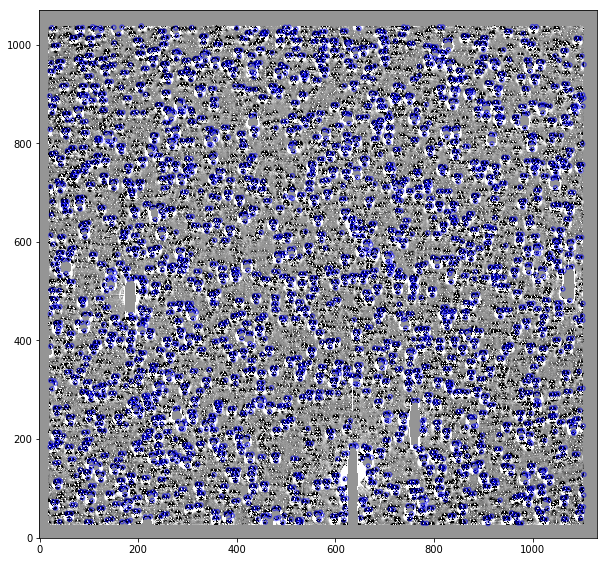

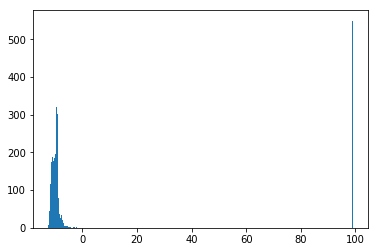

[[ 291.18995146   50.15793011]
 [ 290.65888345   49.93610425]
 [ 290.98883029   50.09572146]
 ..., 
 [ 290.53955196   51.18726807]
 [ 291.09786638   51.42454588]
 [ 290.46359092   51.16930251]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.5884 +50:09:28.5484': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.3193 +50:05:44.5973': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:33.5809 +50:25:49.2878': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:58.5525 +50:10:25.907': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:22.0869 +50:30:38.5928': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.0684 +50:13:13.8128': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:13.826 +50:30:10.1507': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:54.3505 +50:11:01.0094': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:23.4306 +49:54:35.1348': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:29.28 +50:03:25.9064': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:57.1891 +49:59:03.9461': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:04.0828 +50:24:05.357': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.0965 +51:10:25.9677': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.3733 +51:24:56.5437': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:19.4763 +50:57:44.1684': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.172 +51:11:21.5683': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.9016 +51:04:00.9791': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.4431 +51:04:17.9491': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.821 +51:21:40.7753': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.1268 +51:04:25.562': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.2997 +51:05:00.7156': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:57.5337 +51:11:49.1338': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.6397 +51:12:04.3234': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.9125 +51:14:48.3664': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:52.4391 +51:10:23.0273': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.4558 +50:51:59.3659': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.8721 +50:52:16.5712': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:48.9411 +50:45:05.867': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:51.443 +50:45:22.3383': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:14.8223 +51:18:38.9226': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:55.1583 +51:16:07.2418': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:07.5947 +50:52:30.8526': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:10.1426 +50:52:48.1367': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:17.1993 +50:46:13.5008': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:19.9566 +50:46:32.07': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:53.6153 +51:08:47.0936': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:44.0704 +50:48:28.6252': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:24.6365 +51:16:59.3065': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.4278 +51:17:15.8146': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:08.0029 +50:43:42.5358': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:22.9433 +50:51:05.0487': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:20.0531 +50:50:52.7993': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:10.347 +50:49:14.1418': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.6609 +50:58:23.1401': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:30.1473 +51:04:09.942': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.1527 +50:54:04.3238': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.5259 +51:08:59.4768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:53.8134 +50:40:48.2355': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.0866 +51:15:34.0483': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.5706 +51:09:50.9146': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.3153 +51:09:34.8003': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:23.0666 +50:54:31.2064': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:22.2477 +51:06:57.5097': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:17.3072 +51:18:19.7706': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.5646 +51:08:17.5378': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.2875 +51:08:29.7985': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:06.4989 +50:39:49.0555': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:04.4723 +50:51:06.7443': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:01.4947 +50:50:27.6511': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.7935 +51:02:48.5912': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.987 +50:58:22.3404': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:25.6927 +50:40:07.0614': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:34.636 +50:53:09.7531': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.6805 +50:55:14.4887': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.2302 +50:55:31.105': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:59.7749 +50:48:42.578': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.608 +51:14:35.3778': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:21.483 +51:14:49.9188': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:31.1535 +51:15:57.6197': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:01.0151 +50:53:54.3475': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:32.3227 +50:38:22.4497': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.9963 +51:00:28.5676': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.5165 +51:04:28.7249': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.0887 +51:10:09.6244': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:15.0295 +50:48:20.4828': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.579 +51:08:51.2277': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.4204 +51:09:07.5033': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:17.8165 +51:00:01.1707': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:05.8313 +50:52:23.734': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.8639 +50:52:43.9457': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.6135 +50:53:00.2339': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:52.6823 +50:43:11.4319': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.8712 +51:02:28.441': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.1966 +51:05:44.1389': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:48.2578 +50:35:32.6294': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:53.9759 +50:36:10.4762': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.5948 +50:53:10.1467': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:27.0916 +50:39:06.0328': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:29.6412 +50:39:22.9939': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.4626 +51:05:09.168': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.5367 +50:44:21.7974': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.6803 +50:44:08.7045': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.0536 +51:02:15.5974': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:18.7373 +51:01:18.4406': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:33.6856 +51:08:52.1526': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:38.5216 +50:38:32.4551': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.0217 +50:44:35.6741': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:37.9203 +50:44:18.1025': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:33.8145 +50:50:00.8291': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.9357 +50:51:13.0178': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.4064 +50:58:06.815': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.2533 +51:00:23.0475': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:34.1094 +50:42:37.3608': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.9138 +50:54:54.3459': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:11.8707 +51:04:40.8688': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.4243 +50:41:24.0939': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:52.7872 +50:56:02.702': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.561 +50:59:01.6368': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:14.9356 +50:32:40.5313': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:45.6882 +50:35:51.7369': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.447 +50:40:18.9145': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:56.6556 +50:29:47.406': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:53.9101 +50:29:06.9791': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.9893 +50:48:24.3684': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:13.7511 +50:55:38.696': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.1552 +51:00:34.7337': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:08.0366 +51:00:51.2636': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.94 +50:36:03.9342': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:28.6651 +50:55:49.1944': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:31.1504 +50:56:04.6714': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:29.6969 +50:30:15.9906': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.1284 +50:42:37.0946': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.8638 +50:43:28.0412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:05.0119 +50:51:37.9421': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.1116 +50:51:56.3418': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:15.0474 +50:52:53.8298': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.4134 +50:49:01.4696': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:48.8066 +50:43:06.2874': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.2225 +50:55:13.3395': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:13.0514 +51:03:03.2362': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:01.2471 +50:24:54.9796': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.1994 +51:01:15.078': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:21.4509 +50:26:10.5449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:08.725 +50:31:11.1406': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.0153 +50:56:43.6804': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.6398 +50:45:05.775': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:11.221 +51:01:01.4665': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:13.9185 +50:24:26.6779': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:24.0325 +50:37:11.1897': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:26.5443 +50:37:26.2918': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:24.0886 +50:36:47.7598': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:41.9565 +50:32:17.289': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.7817 +50:32:35.4497': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.6599 +50:32:51.8222': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:42.7481 +50:55:50.8446': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:42.5673 +50:31:24.2229': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.1876 +50:31:40.0285': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:14.8923 +50:27:56.0638': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:16.9905 +50:28:04.5961': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.5937 +50:32:17.7499': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:14.4766 +50:51:54.8804': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:29.5521 +50:22:27.7534': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:32.0017 +50:22:42.326': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:07.2976 +50:44:28.3878': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:50.7778 +50:24:05.1416': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.2023 +50:44:46.8906': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:46.4603 +50:23:19.9062': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.1839 +50:25:31.1169': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:52.0226 +50:42:33.6631': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:52.1529 +50:23:14.5366': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:14.686 +50:37:52.1031': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:24.0718 +50:56:59.8681': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.6394 +50:34:29.9871': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.4896 +50:49:33.5084': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:35.8498 +50:51:15.8999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:51.3052 +50:33:42.5923': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:51.4835 +50:39:42.3815': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.0322 +50:39:59.6663': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:22.1495 +50:35:44.8833': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.4558 +50:35:59.5882': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:55.9648 +50:39:09.1148': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:41.1268 +50:30:50.588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:22.1044 +50:47:15.7489': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.7187 +50:47:29.7832': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:05.3039 +50:26:02.4129': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:08.0266 +50:26:17.8606': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:55.2261 +50:31:21.5121': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:51.338 +50:17:49.4926': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:53.6107 +50:18:04.4689': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.614 +50:28:50.1916': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:56.0588 +50:48:26.3987': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:42.7853 +50:16:19.9492': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:00.4551 +50:24:28.9727': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:08.6936 +50:18:15.04': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:39.3435 +50:52:05.0204': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.7601 +50:30:24.6086': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.8131 +50:24:39.6416': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.7535 +50:26:44.2551': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:47.4035 +50:27:39.8555': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.4185 +50:47:58.7842': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.4287 +50:46:12.3389': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:57.955 +50:52:21.1705': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:43.7267 +50:43:49.0779': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.3809 +50:46:11.775': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:56.9723 +50:14:30.1117': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:37.0447 +50:48:01.295': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.5611 +50:40:04.2481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.2246 +50:32:12.3892': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:03.3203 +50:38:35.8678': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:11.6527 +50:45:36.8431': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:02.5181 +50:13:43.177': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:53.2781 +50:24:43.6706': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:55.6634 +50:24:52.395': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:12.5097 +50:44:53.8335': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.1589 +50:20:48.4917': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.5556 +50:36:12.0066': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.2064 +50:14:24.5989': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:35.9797 +50:26:48.1392': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:38.6227 +50:27:03.5257': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:12.5297 +50:24:49.1206': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.8353 +50:20:09.4198': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:09.624 +50:23:26.2326': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.0098 +50:27:59.1435': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:15.8999 +50:11:01.114': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.4826 +50:33:01.2593': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.6301 +50:39:21.649': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.4112 +50:13:02.0535': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:42.7583 +50:13:17.5046': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.614 +50:38:30.6717': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:27.2238 +50:41:32.8722': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:23.0926 +50:47:07.0757': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:25.1364 +50:47:21.7742': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.76 +50:25:01.7708': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:48.0962 +50:43:00.1561': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:56.3792 +50:43:26.2725': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:06.7981 +50:37:57.3553': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:20.4388 +50:08:28.4147': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.6208 +50:15:58.2005': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.5544 +50:09:16.7008': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:57.634 +50:42:29.6634': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.0384 +50:09:30.3477': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:34.3602 +50:39:21.9186': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:34.8931 +50:38:57.6334': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:36.8586 +50:38:31.7689': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.3884 +50:12:37.1228': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:50.9793 +50:09:29.9605': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:23.1964 +50:12:53.8974': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.26 +50:33:00.4428': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:00.0526 +50:33:16.2385': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:03.8882 +50:09:34.7339': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:45.8165 +50:31:53.2983': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:45.8543 +50:31:15.0537': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.3542 +50:31:30.6832': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:14.873 +50:40:15.2928': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.2674 +50:07:17.2816': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.0425 +50:07:31.9644': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:03.2418 +50:07:48.9324': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.2888 +50:03:36.5993': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.4825 +50:11:29.861': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.6862 +50:07:32.129': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.2221 +50:07:46.2762': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:22.6711 +50:14:58.7229': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:29.2611 +50:26:50.5377': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:34.2249 +50:27:16.03': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:39.2282 +50:34:06.6872': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.7538 +50:11:08.4576': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.6976 +50:10:56.1207': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.6388 +50:10:36.3716': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:09.8928 +50:17:01.8423': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:07.6557 +50:16:45.136': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:38.0999 +50:32:22.8109': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:59.5446 +50:15:31.5672': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.3091 +50:15:46.9732': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.2633 +50:27:33.7319': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:05.257 +50:33:49.91': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:07.6525 +50:34:04.1256': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:43.666 +50:00:51.232': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroqu

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:43.7365 +50:36:45.4018': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:46.2224 +50:37:00.1851': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:10.6822 +50:33:22.8294': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:15.3569 +50:32:50.0913': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:18.8459 +50:33:13.7463': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:17.531 +50:27:17.9525': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.4103 +50:06:19.2625': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:37.8741 +50:34:12.0811': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:43.9904 +50:35:04.2228': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:10.3993 +50:24:56.647': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:49.31 +50:34:41.3366': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.7953 +50:00:48.0437': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.6072 +50:22:43.7172': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:33.556 +50:32:24.7428': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.8643 +50:09:30.0799': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:09.2569 +50:23:01.3935': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:41.0883 +50:32:17.2055': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:43.5963 +50:32:31.3245': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:40.7521 +50:19:33.9967': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:19.0165 +50:05:01.7434': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:27.5891 +50:24:13.0138': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.6988 +50:00:23.7019': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.8622 +50:00:26.9095': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.7321 +49:59:24.7194': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:44.5206 +50:54:31.7975': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.9981 +50:11:17.4882': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:54.9368 +50:31:42.9882': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.9175 +51:06:07.8392': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.5209 +50:06:13.7768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:56.2515 +50:06:23.8017': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.6009 +51:17:17.2016': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:07.256 +50:50:28.5942': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:38.1633 +51:06:39.2333': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:13.177 +51:18:21.097': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:37.0887 +51:21:05.4262': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:18.0257 +51:23:16.1481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:57.0967 +50:52:11.3251': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.31 +51:21:48.1741': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.1329 +51:18:50.2708': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/data/mj1e16/kepler/properDiff/diff_imNo12_channel1.fits


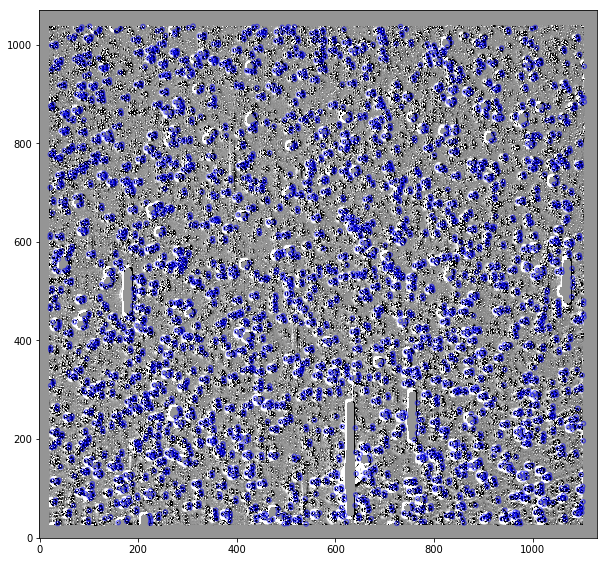

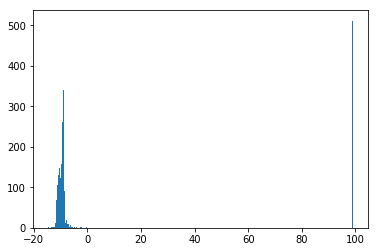

[[ 291.36082545   50.20298211]
 [ 290.89409486   50.01463353]
 [ 291.42494287   50.22952945]
 ..., 
 [ 290.07245265   50.9197101 ]
 [ 291.1474232    51.35676743]
 [ 289.81298472   50.80901632]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.5981 +50:12:10.7356': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.5828 +50:00:52.6807': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:41.9863 +50:13:46.306': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:14.8517 +50:23:57.7577': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:08.7964 +50:23:24.1341': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:19.372 +50:18:40.268': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.4357 +50:09:20.8269': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:17.1031 +50:18:33.0505': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.2454 +49:55:50.3534': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:11.3764 +50:30:10.503': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.1305 +50:14:50.2327': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.413 +49:55:20.4657': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:20.3667 +50:26:02.0752': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:18.1995 +50:02:00': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:42.0776 +50:22:21.9127': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroqu

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.0551 +50:05:36.9772': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.85 +50:03:10.1804': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:22.6838 +49:56:44.4303': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:49.0505 +50:30:50.4698': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.649 +49:59:26.87': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:54.1551 +50:25:17.7375': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.1591 +50:10:38.9408': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:25.2998 +49:57:27.0246': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:14.7996 +50:27:09.9487': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:07.9076 +50:46:55.8473': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:39.6364 +50:50:29.1822': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:23.4314 +51:01:40.4187': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.6896 +51:13:13.2673': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:14.7607 +50:53:33.7728': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:24.4395 +51:01:18.5374': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:12.7045 +50:58:57.5663': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.4603 +51:14:54.653': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.6718 +51:14:22.352': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.4634 +51:11:56.7674': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:15.0555 +50:52:50.786': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.3001 +51:02:49.6058': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:09.1624 +50:51:25.7406': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:18.5348 +50:58:37.3867': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.8854 +51:13:29.8146': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.9049 +51:13:48.3038': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:26.1707 +51:16:26.3163': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:59.7571 +50:55:21.9348': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.7211 +51:18:20.3201': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.6622 +51:09:13.5902': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.0409 +51:08:55.1552': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:00.8432 +50:41:47.0294': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.9861 +51:08:56.6347': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:15.4051 +50:49:23.7903': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:54.8742 +50:40:03.0972': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:17.4597 +51:07:11.4376': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:23.4222 +51:13:47.1596': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:38.9573 +51:14:47.8153': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:08.8095 +50:45:52.2691': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:04.2391 +50:46:24.8625': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.45 +51:10:41.0946': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.5933 +50:54:12.2502': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:57.5591 +50:57:50.3747': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:49.3751 +50:41:18.5627': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:42.2455 +50:42:13.4459': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:46.35 +50:41:15.8998': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.5689 +51:08:17.1164': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:37.1886 +50:54:11.8164': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.069 +50:45:01.0749': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.3403 +50:59:31.8707': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:12.8173 +51:15:12.2162': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.0108 +51:14:04.896': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:36.4504 +50:52:11.5901': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:01.0058 +50:54:44.6697': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:47.8034 +50:59:33.8148': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.405 +51:10:20.8369': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:41.5407 +50:45:31.2648': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:19.6931 +50:41:56.7171': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.5006 +50:51:59.9648': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:33.5061 +50:37:53.4759': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:42.878 +50:38:50.3325': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:38.151 +50:37:31.2941': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.7491 +50:51:49.2453': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:41.9372 +50:55:46.7513': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.6482 +50:48:10.7457': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.227 +51:11:21.5615': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.7885 +51:06:22.0601': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.2783 +50:56:53.6623': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:44.6594 +51:00:29.1607': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:07.5107 +51:09:13.4216': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:00.0669 +50:35:57.2894': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:01.0981 +50:35:33.4859': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:56.3553 +50:36:27.5667': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.9143 +50:52:10.0689': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:18.9176 +51:03:18.8061': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:41.4359 +50:34:38.3834': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:42.6185 +50:46:20.2905': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:38.0375 +50:40:18.161': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.4999 +50:49:59.6204': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:22.2228 +51:08:32.847': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:04.5723 +50:36:03.2229': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.7169 +50:46:47.2777': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:59.4963 +50:40:16.3157': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.253 +50:48:08.2051': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:40.2922 +50:52:11.7785': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:55.4143 +50:32:25.0558': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.5099 +50:32:58.6005': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.5494 +50:32:19.291': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.9877 +51:04:58.2815': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:10.9197 +51:04:42.1191': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:07.3362 +51:04:54.3491': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.4954 +50:53:53.2074': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.4055 +50:57:25.5316': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:48.513 +50:50:26.2143': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:09.5058 +50:33:12.7481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:39.6448 +50:42:31.3963': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:32.9907 +50:54:09.5191': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:47.018 +50:30:05.7712': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.993 +50:41:18.4055': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:07.4437 +50:50:34.1466': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.8974 +50:55:58.8487': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:43.8411 +51:05:55.9359': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:11.2827 +50:50:33.9026': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:03.9819 +50:30:18.433': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.7871 +50:58:56.5604': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.1339 +50:58:38.6025': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.26 +51:00:22.7475': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:06.6831 +51:00:01.5166': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:58.4224 +50:28:56.0508': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.3934 +51:05:44.4903': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.4629 +50:52:11.0115': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.5953 +50:36:24.6402': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.833 +50:37:22.6412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.0632 +50:39:28.0278': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.014 +50:43:43.9663': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.8368 +50:53:27.4849': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.6659 +50:53:05.021': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:28.5891 +50:54:17.239': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.0456 +50:27:04.3539': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.9394 +50:26:41.0224': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:11.9395 +50:33:29.3092': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.6759 +50:48:49.7753': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.3917 +50:35:43.0854': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:41.0788 +50:35:20.9754': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.6588 +50:47:01.2795': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:19.0591 +51:03:26.5155': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:20.3193 +51:03:09.7483': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.7249 +50:37:32.6893': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:33.5006 +50:39:41.3133': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.4379 +50:39:14.9939': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:23.91 +50:55:34.4469': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:08.5841 +51:00:33.4373': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:59.8192 +50:29:07.3146': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.7645 +50:30:31.5569': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:38.9683 +50:44:45.6491': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:20.2523 +50:55:05.2461': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:06.1149 +50:52:56.4649': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:46.2939 +50:32:26.5125': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:47.3426 +50:32:04.9506': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:43.2109 +50:31:48.2469': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.8008 +50:36:20.9773': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:07.066 +50:52:34.9528': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:13.2851 +50:51:52.4702': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:14.8751 +50:52:27.0107': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:44.5708 +50:55:33.7232': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:13.6486 +50:39:44.4648': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:56.7615 +50:50:08.2632': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:17.7468 +50:27:35.6549': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:30.3636 +50:47:07.1839': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:22.7877 +50:52:26.3449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:31.1774 +50:59:11.6793': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.929 +50:36:47.818': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.3 +50:47:28.1726': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:53.9055 +50:54:44.962': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroque

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:19.4672 +50:31:49.1156': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:28.3471 +50:39:45.356': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:29.2932 +50:39:22.5338': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:52.9353 +50:29:28.8945': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.0631 +50:26:52.3259': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.8636 +50:41:22.6428': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:15.633 +50:24:45.0266': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.307 +50:31:25.1281': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:22.3763 +50:31:02.5125': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:13.6336 +50:29:55.2453': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.8085 +50:45:24.0072': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:43.9904 +50:45:16.2832': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.8191 +50:37:57.3525': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.5351 +50:40:21.9973': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.8343 +50:26:00.8025': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:12.1565 +50:52:30.6972': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.5443 +50:25:02.3393': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:50.1483 +50:25:42.4166': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:47.6034 +50:18:40.0378': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:48.8248 +50:18:29.2767': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:52.2734 +50:43:43.4768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.7213 +50:30:28.9552': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.5643 +50:30:48.8437': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:55.5751 +50:31:13.0748': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:51.3783 +50:17:39.3434': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:52.3265 +50:17:17.462': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:43.9447 +50:29:18.5923': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.6447 +50:38:45.2012': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:13.1266 +50:49:46.8815': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:38.7418 +50:15:21.9621': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.6043 +50:44:52.5178': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.8296 +50:46:53.7885': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:43.5342 +50:15:29.2414': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:13.2417 +50:42:38.9676': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.8926 +50:19:21.3713': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.6009 +50:18:58.8778': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.1437 +50:21:19.8147': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.812 +50:22:04.6107': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:13.2582 +50:29:48.8362': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:17.8524 +50:47:48.5475': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:18.9929 +50:47:27.2145': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:21.5668 +50:47:22.164': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.026 +50:24:51.8102': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:32.4433 +50:36:31.6474': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:00.6709 +50:39:19.6463': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:01.7068 +50:38:57.063': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.1889 +50:40:39.4244': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:37.4525 +50:48:12.7939': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:01.9962 +50:37:47.8204': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:09.3608 +50:27:16.6082': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:00.0397 +50:13:19.4053': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:21.4915 +50:39:46.3768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.24 +50:22:44.5479': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.6585 +50:35:09.3122': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:39.4299 +50:34:43.5142': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:45.9901 +50:41:21.2119': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:47.3478 +50:40:59.3765': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:17.6579 +50:31:30.9694': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:26.4404 +50:32:24.4913': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.6857 +50:34:54.164': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:59.3269 +50:40:57.6056': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.8792 +50:21:33.4979': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.6558 +50:24:50.9838': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.2885 +50:32:33.4672': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:33.9863 +50:13:13.7141': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.6187 +50:20:37.1418': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:01.693 +50:46:12.6588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.2861 +50:34:12.1066': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:25.2374 +50:36:28.0764': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:29.026 +50:23:33.1273': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.9343 +50:34:16.0713': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:10.7066 +50:33:53.0387': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.2836 +50:12:36.0199': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:35.6556 +50:24:03.1834': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.4571 +50:26:53.661': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.0497 +50:18:09.9318': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.4365 +50:38:31.0681': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:48.2433 +50:42:47.3663': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:01.0249 +50:31:14.9023': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.6472 +50:23:07.4617': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.328 +50:25:14.3941': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:45.0087 +50:41:09.1998': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:43.1144 +50:09:54.0369': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.4239 +50:10:24.7405': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:30.3035 +50:27:05.9309': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:15.1868 +50:37:37.3384': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:46.2749 +50:40:48.1205': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:38.8561 +50:21:06.5122': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.7096 +50:20:43.4698': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.5135 +50:25:28.8684': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.5788 +50:12:29.4541': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.7788 +50:27:32.5901': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.4156 +50:27:12.5419': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:24.7386 +50:36:24.1758': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:32.9422 +50:43:05.7866': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:45.9653 +50:14:02.4522': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:45.271 +50:31:06.0704': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:46.3601 +50:30:38.4636': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:50.59 +50:38:02.305': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroq

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.2958 +50:25:01.7065': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:30.3755 +50:41:36.8643': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.3889 +50:04:39.0709': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:58.4051 +50:25:38.8855': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.3181 +50:09:04.1852': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:19.4822 +50:08:41.1258': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.6662 +50:23:14.3999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:03.8776 +50:25:14.8652': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.1325 +50:24:55.3904': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:43.6455 +50:22:52.8574': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:22.987 +50:32:52.1982': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:42.2299 +50:40:37.2781': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:32.3548 +50:32:35.7137': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:40.4856 +50:39:56.9408': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:15.2165 +50:06:50.9758': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:42.7839 +50:33:20.6912': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.8661 +50:13:54.5168': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:19.9844 +50:25:00.6184': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:46.6333 +50:08:37.3854': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:47.3757 +50:08:12.7011': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:07.4956 +50:10:45.6871': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:50.8108 +50:26:55.1193': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.736 +50:27:10.6252': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:51.8399 +50:38:58.6667': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.9826 +50:29:29.5986': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:29.0625 +50:30:14.1199': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:28.2665 +50:29:52.1672': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:55.8002 +50:01:38.055': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.6002 +50:08:18.9597': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:11.0822 +50:09:31.3449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.7245 +50:04:31.8026': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.7148 +50:07:55.3819': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.2513 +50:20:20.3554': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:16.594 +50:32:14.0246': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:33.5104 +50:34:27.4221': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:06.5867 +50:07:21.3833': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:56.2237 +50:23:41.7427': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:56.3416 +50:36:14.4068': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.6483 +50:01:02.571': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.5329 +50:01:58.0789': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:30.9219 +50:02:13.7822': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.6645 +50:04:37.2779': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.8437 +50:13:08.8377': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.9595 +50:15:19.2445': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:11.5747 +50:24:24.3215': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:36.0814 +50:07:54.2942': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.401 +50:06:47.3271': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:49.4995 +50:27:29.2998': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.5842 +50:09:43.6847': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:12.215 +50:29:07.2692': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:09.558 +50:10:13.9762': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.0682 +50:14:00.6009': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.7981 +49:56:18.164': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:50.4338 +50:31:24.2897': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:55.2816 +50:51:25.2261': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.4347 +51:24:46.5057': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.1827 +51:21:46.358': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:33.7515 +51:00:21.0842': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:09.669 +51:23:03.1474': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:47.9053 +50:55:36.4239': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.5569 +51:17:28.9653': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.3094 +51:10:02.5996': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:55.108 +51:14:59.6088': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:43.5661 +50:53:44.3534': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.8019 +51:05:20.3955': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:50.5616 +51:07:21.8116': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:37.1066 +51:04:31.1837': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.9223 +51:22:45.785': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:18.5653 +51:03:51.8201': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.8115 +51:09:25.2027': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.293 +51:16:47.4036': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.1464 +51:24:24.3693': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:24.4971 +50:56:15.5629': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:37.9632 +51:03:59.9084': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:45.747 +50:46:31.4313': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:59.1308 +51:11:03.1981': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:25.2288 +50:55:52.0118': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.2961 +50:59:08.5498': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/data/mj1e16/kepler/properDiff/diff_imNo13_channel1.fits


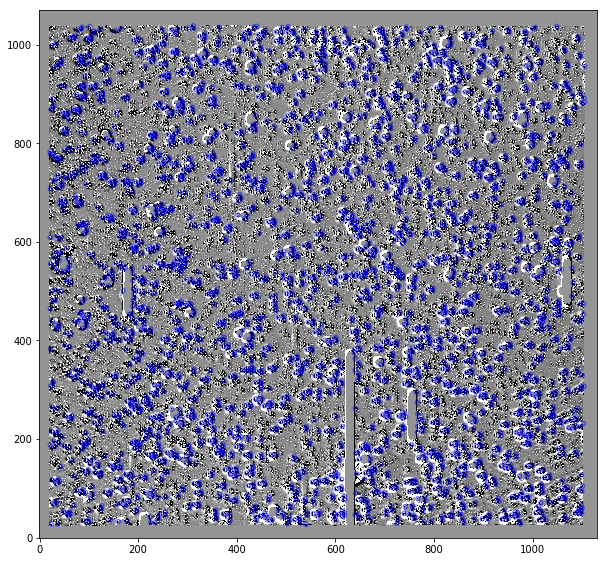

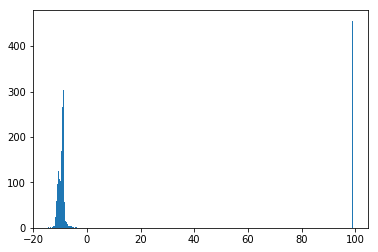

[[ 292.1186135    50.50634759]
 [ 290.89410731   50.0147063 ]
 [ 291.80570126   50.3860243 ]
 ..., 
 [ 290.84917217   51.24714953]
 [ 290.9113032    51.28415738]
 [ 289.95875426   50.89224029]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:28.4672 +50:30:22.8513': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.5858 +50:00:52.9427': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:13.3683 +50:23:09.6875': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:55.8566 +49:57:50.2072': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:00.9273 +50:27:53.1225': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:19.8729 +50:00:01.4617': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.5208 +50:09:21.0429': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:57.8175 +49:58:18.532': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.8035 +50:10:53.6797': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.0731 +49:55:51.1634': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:20.8173 +50:19:17.1224': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.3894 +50:16:22.4059': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:30.0642 +50:15:07.3458': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.1085 +50:09:10.4515': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:58.2437 +50:17:49.7795': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:29.0594 +50:15:30.5036': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:33.9147 +50:10:04.4208': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.0948 +50:09:33.8726': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:21.6696 +50:27:26.0442': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:17.2304 +50:02:22.983': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:24.9544 +50:27:16.4316': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:10.4067 +51:12:41.9853': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:11.6986 +51:12:29.6435': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.3467 +51:16:11.4137': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:07.078 +50:47:06.2835': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:10.0938 +50:47:01.1522': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.3295 +51:22:30.2936': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:27.0132 +50:54:59.5661': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:24.0998 +51:01:19.636': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:54.758 +50:46:19.0704': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.1732 +51:18:15.4963': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:34.3987 +50:55:43.7036': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.7132 +51:06:15.3267': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.939 +51:12:32.4886': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:24.5834 +51:18:17.8764': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:55.4559 +50:50:51.1408': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:09.1037 +50:51:26.2042': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:18.3955 +50:58:36.2608': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:05.5217 +50:50:57.9386': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.1231 +51:13:59.1874': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.8112 +51:13:45.2802': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:59.7644 +50:55:21.9944': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:29.9763 +50:45:29.8495': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:30.6162 +50:45:09.5228': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:13.678 +51:08:31.6216': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:20.4224 +50:56:12.1191': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.3532 +50:55:48.1223': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.1546 +51:03:35.1658': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.6525 +50:54:31.0767': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.9385 +51:15:30.7955': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:32.9425 +50:50:32.9297': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.7291 +50:45:12.6002': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:58.4718 +50:44:50.6263': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:57.3409 +50:46:03.7842': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:03.8934 +50:39:25.2395': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:06.7581 +50:39:28.4846': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:22.3945 +50:41:49.7058': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:59.5469 +51:09:38.8178': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:56.9107 +50:51:02.3051': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.3175 +51:08:32.6512': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:47.4678 +51:07:44.2333': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:01.6658 +50:50:14.3191': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.8682 +50:59:36.7125': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:42.2046 +50:54:09.1895': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:13.2135 +50:57:19.0063': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:05.1161 +50:50:05.844': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:47.8112 +50:59:33.9129': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:44.5142 +50:46:38.6118': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:45.5379 +50:46:05.2772': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:16.9938 +50:41:52.1969': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:18.7874 +51:07:37.1204': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.0462 +51:07:34.0889': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.1162 +50:39:47.6989': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.4154 +50:50:57.4667': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:13.0574 +50:47:56.3449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:38.1604 +50:37:31.4774': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:39.2085 +50:50:02.8302': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:04.9162 +50:52:41.4505': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:27.7128 +50:35:16.8292': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:04.8536 +50:51:53.1559': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.1927 +51:11:21.155': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:17.271 +50:38:52.3712': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:49.5077 +50:43:07.8628': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.4603 +50:44:32.5326': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.3568 +51:02:03.6088': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:40.3002 +50:34:12.435': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:36.7862 +50:33:42.0951': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:45.8399 +50:34:03.5938': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.6575 +51:08:51.2016': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:01.0767 +50:36:40.5933': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.6276 +51:00:50.169': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.1718 +51:02:47.2743': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:28.2652 +51:03:42.0272': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:27.3525 +50:38:58.6126': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.1815 +51:05:28.1564': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:04.5776 +50:36:03.2444': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.2604 +50:48:09.6194': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:12.1143 +50:35:50.3219': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.4697 +51:00:19.2604': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.1086 +50:32:22.0881': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:02.8044 +50:40:45.2086': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.7668 +50:58:37.5894': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.6008 +51:04:12.4936': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:39.4127 +50:37:46.2181': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.6493 +50:44:29.9461': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.4614 +50:53:54.336': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.4333 +50:57:25.8462': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:58.8968 +51:03:52.6148': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.553 +50:53:28.46': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.6314 +50:53:09.794': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.6997 +50:54:28.6293': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroq

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:07.5339 +50:50:34.2751': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.8999 +50:56:22.1087': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.1516 +50:50:11.0326': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:13.5592 +50:31:55.6657': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:24.2993 +50:33:01.1579': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:25.3704 +50:32:40.6755': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.6111 +50:58:54.6606': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.0457 +50:58:35.7646': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:18.8727 +50:37:55.9621': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.6859 +50:57:54.0013': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.1693 +50:57:51.3274': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.9285 +50:41:06.0072': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.6812 +50:43:53.5917': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.0592 +50:42:44.7578': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.552 +50:42:57.4457': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.0474 +50:39:27.7066': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.0037 +50:43:43.596': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.5173 +50:53:11.6645': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:22.7134 +50:35:09.609': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:01.4869 +50:38:15.0834': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:00.6955 +50:38:59.3229': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:14.472 +50:26:45.0173': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:10.9784 +50:27:03.5844': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.9869 +50:26:41.4833': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.1722 +50:40:36.5911': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.8433 +50:37:37.1538': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.1407 +50:46:28.8934': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.17 +50:57:07.8687': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:30.1393 +50:58:19.4749': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:32.742 +50:27:50.7754': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.288 +50:32:46.5808': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:13.9254 +50:24:51.4554': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.8957 +50:32:01.6975': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:12.5951 +51:00:43.7918': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.5923 +50:37:56.9477': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.3314 +50:38:29.1405': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:19.9811 +51:00:28.9074': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:24.1095 +50:59:51.9083': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:16.739 +50:23:40.7112': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:52.7128 +50:32:12.8905': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.0984 +50:44:27.0113': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:57.4996 +50:33:21.8816': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:44.4435 +50:55:33.5762': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:55.3729 +50:32:15.4966': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.7567 +50:33:27.1232': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.9648 +50:33:33.5276': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.8521 +50:35:33.1019': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.6239 +50:46:23.0253': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.8275 +50:40:13.558': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:30.9183 +50:59:11.3895': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:29.7094 +50:22:20.9376': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:02.9655 +50:51:22.9011': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.3029 +50:36:35.8421': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.7047 +50:39:53.4914': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:25.802 +50:32:58.6599': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.3495 +50:37:18.4042': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.3867 +50:37:30.9399': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.2628 +50:43:06.7057': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:51.0747 +50:23:13.7554': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.3661 +50:33:20.154': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.3468 +50:47:40.4575': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:19.0307 +50:37:49.6079': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.4484 +50:39:55.8967': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:43.8009 +50:45:15.8377': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.7194 +50:51:53.3784': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.5158 +50:23:14.6004': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.8417 +50:27:07.3193': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.5567 +50:40:22.2139': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.8483 +50:42:02.1965': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.5314 +50:38:04.9189': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.376 +50:37:42.885': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:12.2405 +50:52:32.0677': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:48.8751 +50:18:29.0506': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:08.9727 +50:45:25.71': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:10.44 +50:45:33.7355': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroq

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.2788 +50:38:56.296': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:49.7243 +50:18:04.8158': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.7405 +50:21:54.8702': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.4995 +50:41:12.0869': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.2292 +50:45:54.9398': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.6061 +50:41:08.235': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:34.2376 +50:50:30.2118': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:42.5071 +50:28:13.1563': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:43.4313 +50:27:36.6314': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:57.1467 +50:52:20.92': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:40.1145 +50:15:00.9983': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.1364 +50:25:09.7092': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:04.6333 +50:16:53.2592': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.8651 +50:25:49.2642': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.7618 +50:25:26.951': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.8805 +50:33:13.6463': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.157 +50:38:43.9887': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.5307 +50:18:53.7742': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:54.6264 +50:14:08.2934': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.4948 +50:22:30.4733': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.5868 +50:22:09.4577': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.633 +50:13:45.1716': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:43.5253 +50:25:00.6064': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:05.0283 +50:27:09.9565': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.7047 +50:26:23.7458': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:43.8678 +50:36:37.3377': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.8193 +50:30:56.8375': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:29.503 +50:28:01.0362': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.6841 +50:31:47.2192': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.6105 +50:31:24.5843': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:36.9381 +50:27:23.8115': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:22.6023 +50:39:23.3275': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:52.8163 +50:36:14.024': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.909 +50:17:08.2667': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:18.0934 +50:25:03.2709': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.4631 +50:20:21.4035': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.9173 +50:21:34.1496': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:21.7406 +50:24:52.2172': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:20.4528 +50:42:58.84': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.4313 +50:33:31.5604': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:09.2501 +50:16:41.5011': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.1863 +50:19:23.1915': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.6399 +50:38:55.4156': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:06.5141 +50:40:31.4496': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:25.3264 +50:36:29.1439': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:18.7393 +50:41:07.4653': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:20.3433 +50:40:47.63': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:39.0462 +50:43:04.0609': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:51.1731 +50:19:15.6002': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:42.2241 +50:12:02.256': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.1206 +50:15:45.2461': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:55.0076 +50:31:21.4084': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:56.6271 +50:31:04.7836': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:47.9301 +50:42:43.4801': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:20.345 +50:08:21.5269': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.8309 +50:15:17.5399': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.6773 +50:15:49.6457': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:08.149 +50:37:26.0889': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.533 +50:07:58.0932': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.2234 +50:08:56.1846': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:15.8171 +50:13:00.0441': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:01.4999 +50:29:58.2259': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:01.421 +50:29:23.7748': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.226 +50:21:13.8962': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:39.1445 +50:38:58.2173': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.4153 +50:16:51.8726': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:38.6843 +50:07:34.7236': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.2753 +50:30:52.7413': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:27.1933 +50:30:30.4398': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:13.0909 +50:40:43.0435': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:03.8657 +50:09:07.0487': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:05.4873 +50:09:04.5462': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:25.2503 +50:35:08.9582': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:20.9988 +50:34:53.9512': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:22.1576 +50:34:32.9938': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.9814 +50:04:45.4859': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:30.3928 +50:17:09.6742': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:53.7156 +50:25:29.2956': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:12.3148 +50:38:51.2693': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.5802 +50:07:46.4936': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.2715 +50:15:11.6874': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:27.7861 +50:33:36.0847': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.7277 +50:03:34.9229': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.2798 +50:07:08.5473': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:01.321 +50:30:25.3557': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:36.6241 +50:33:49.2681': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:10.2174 +50:37:17.295': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:00.4566 +50:04:42.1798': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:33.448 +50:26:46.0221': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.6355 +50:27:13.9354': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:50.0673 +50:33:24.4342': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:51.7942 +50:33:20.5004': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:49.5917 +50:39:36.2022': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:36.6761 +50:31:36.5572': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:44.0989 +50:38:21.7128': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.9038 +50:06:58.2361': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:22.4655 +50:10:37.5892': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:32.9107 +50:36:42.2797': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:37.1261 +50:31:02.9124': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.4576 +50:11:25.1236': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:53.3347 +50:26:12.8546': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.9429 +50:26:06.196': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:19.8928 +50:34:19.2867': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:32.9883 +50:17:25.2856': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:21.5534 +50:28:26.3134': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:19.1615 +50:32:18.4724': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:15.5538 +50:32:33.8434': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:16.7329 +50:32:13.4848': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:56.3633 +50:36:14.6418': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.4781 +50:01:04.2663': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:37.9425 +50:03:53.9304': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.4381 +50:13:43.0473': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.0966 +50:15:21.1431': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.9079 +50:15:21.1756': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:00.193 +50:28:50.3313': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.6993 +50:11:44.2228': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:11.6444 +50:24:25.258': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:03.8736 +50:34:39.8875': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:08.0948 +50:35:19.404': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.5386 +50:12:21.3927': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:47.0506 +50:20:09.276': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:06.7423 +50:22:35.3751': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.9443 +50:22:14.3109': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.1663 +50:08:05.0091': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:10.2573 +49:57:42.7806': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.4149 +50:00:12.3944': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:31.435 +50:29:56.9352': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:32.9133 +50:29:37.1315': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:57.4357 +49:55:51.3881': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:51.615 +50:06:16.0968': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:17.8211 +50:09:42.7681': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.123 +50:12:33.5827': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:00.2583 +50:25:42.3312': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:38.8482 +50:11:11.7855': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.3116 +50:12:10.728': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:13.9387 +51:23:28.1129': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.5809 +51:17:09.4017': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.8937 +51:21:56.3705': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:09.7564 +51:11:03.6266': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.4427 +51:16:29.4074': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:42.0455 +50:53:19.145': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:04.0175 +50:55:41.2624': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.4411 +51:14:27.3096': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.7752 +51:05:41.1101': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.932 +51:15:19.7536': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.1349 +51:19:05.9859': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:31.3994 +50:58:40.8998': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:38.8564 +51:06:21.277': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:03.7476 +50:49:01.4929': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.2615 +51:03:31.4867': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/data/mj1e16/kepler/properDiff/diff_imNo14_channel1.fits


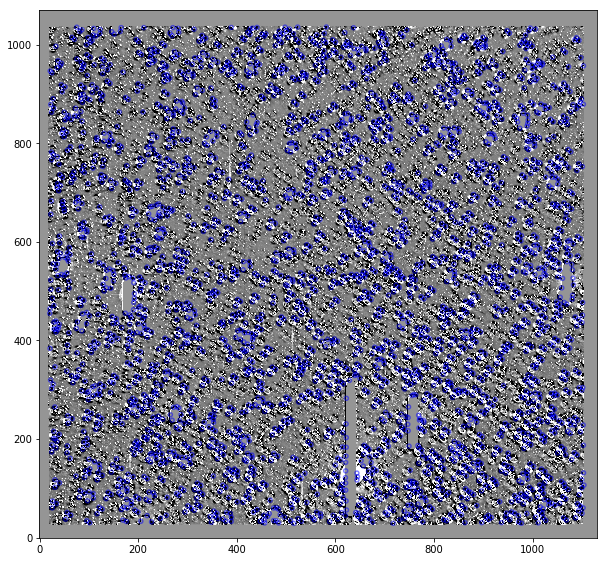

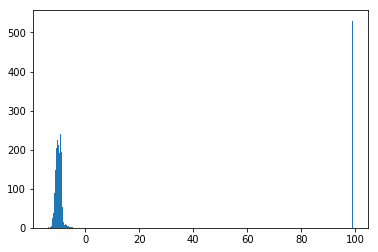

[[ 291.1958354    50.20434606]
 [ 291.21151976   50.18675335]
 [ 290.64650232   49.9254973 ]
 ..., 
 [ 290.45910193   51.16204183]
 [ 290.41274601   51.10973113]
 [ 290.55318707   51.204796  ]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.0005 +50:12:15.6458': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.7647 +50:11:12.3121': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.1606 +49:55:31.7903': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:35.1081 +50:14:02.4403': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:32.6952 +50:25:43.3643': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:17.7944 +50:18:13.2442': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:34.4638 +50:26:06.7827': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.913 +49:57:28.2096': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.7508 +50:00:14.0306': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:45.8396 +50:09:40.5193': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.72 +50:09:24.3827': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:05.776 +50:05:12.1807': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.5447 +49:59:04.7442': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.3365 +50:06:30.0751': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.0381 +50:10:53.8093': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.3214 +50:03:23.1153': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:41.5802 +50:16:41.8142': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:19.7595 +50:32:33.0186': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.4621 +51:06:02.0449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.7625 +51:05:35.3072': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:24.834 +50:56:28.9351': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:37.614 +51:21:52.0633': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:36.0335 +51:21:10.7047': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.0791 +51:20:43.9149': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:50.0891 +51:10:32.5565': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.4896 +51:10:11.1472': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.3952 +51:02:44.7438': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:17.4266 +50:53:55.5303': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:38.0629 +50:43:47.3231': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.4951 +51:19:10.5327': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:07.4191 +50:52:07.042': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:13.6502 +50:52:59.8329': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.3512 +51:10:01.6196': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:04.0163 +51:11:20.5187': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.647 +51:13:33.3433': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.9835 +51:13:39.6264': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.0662 +51:12:58.536': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:53.1703 +50:48:51.0819': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.6688 +50:48:34.1298': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:30.3269 +50:45:45.5374': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:48.5108 +50:47:18.3577': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:21.2013 +50:50:58.9965': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:26.1925 +50:50:30.4229': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:19.9703 +50:55:56.3631': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.7435 +51:01:31.2879': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:28.2843 +50:49:48.6661': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:26.6129 +50:49:09.9891': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:01.5591 +50:53:05.0376': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:26.0717 +50:42:40.214': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:24.3075 +50:42:15.2114': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:25.3017 +50:41:49.692': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:12.4662 +50:46:28.0588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:19.2275 +50:55:10.4721': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:44.8816 +51:09:51.1169': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:03.4908 +51:15:17.7563': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.307 +51:15:33.4874': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:00.2018 +50:50:29.8399': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:30.4494 +50:52:43.9918': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.9925 +50:53:04.6363': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.7606 +50:52:23.3057': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:37.8189 +50:51:52.8369': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:22.8824 +51:03:31.8033': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:58.9308 +50:48:29.1784': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.5327 +50:57:53.5076': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.0931 +51:11:00.751': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:52.2254 +51:11:27.7406': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.4336 +50:55:24.7436': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.7855 +50:54:59.3244': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.1963 +50:50:10.6586': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.008 +51:07:06.0559': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:16.0431 +51:07:13.2927': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.5111 +51:09:56.9845': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:22.8403 +51:12:20.6493': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:50.6245 +50:44:36.7449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:56.6565 +50:38:49.4666': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:17.0587 +50:39:33.4758': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:15.9219 +50:39:04.5694': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:08.395 +51:09:34.9542': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:34.3593 +50:40:31.8448': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:39.9373 +50:40:45.0897': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.9654 +50:53:07.8804': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.169 +51:01:03.138': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:14.2983 +51:02:26.9914': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:41.6047 +51:05:13.8277': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.6134 +51:03:18.5435': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:25.3127 +51:08:53.0086': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.1085 +50:58:25.5527': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:36.9909 +50:38:31.2311': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.6016 +51:08:27.0583': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.2715 +50:58:49.4736': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.2529 +51:03:39.0194': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:08.9848 +51:05:36.68': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:46.4461 +50:44:56.0772': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.9828 +50:42:17.649': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:37.0029 +50:37:00.3804': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.3943 +50:44:09.9112': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.8683 +50:41:32.8649': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:51.0265 +50:55:56.8642': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.0796 +50:55:30.5142': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:12.3497 +50:32:06.3831': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:44.4096 +50:48:16.4412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:43.7255 +50:35:45.2768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:56.2073 +50:29:52.4366': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:54.7125 +50:29:17.1058': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:42.2566 +50:34:39.3689': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:39.0292 +50:51:53.9599': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.1846 +50:55:33.4256': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:06.7094 +51:00:50.8825': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:10.2236 +51:00:01.585': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.5957 +50:46:33.6746': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.5854 +50:55:58.4823': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:32.0835 +50:36:34.5958': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:18.5454 +50:35:14.4344': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.3161 +50:40:57.8769': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:16.174 +50:52:57.6788': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:59.112 +50:32:34.2468': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:01.1974 +50:32:44.0816': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.8791 +50:36:02.1769': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:03.5439 +50:44:30.2392': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:42.499 +50:29:51.508': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.5189 +50:42:04.8917': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:31.346 +50:28:03.0179': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:12.8115 +50:38:17.0541': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:08.5215 +50:30:51.0934': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:22.8483 +50:32:22.8663': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:34.4433 +50:26:34.9642': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:33.1449 +50:38:44.7662': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.65 +50:38:12.904': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:06.8581 +50:42:20.1426': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.5027 +50:51:49.7989': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:56.7801 +50:58:41.2973': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:37.715 +50:44:27.1479': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:29.1061 +50:24:06.1575': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.0672 +50:36:50.531': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.9548 +50:36:23.916': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:34.2516 +50:48:56.3651': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.4481 +50:52:09.8103': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.321 +50:51:43.2174': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:14.3008 +50:40:05.3078': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.5375 +50:54:44.1481': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.1863 +50:29:34.1338': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.4876 +50:43:37.9044': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.3092 +50:49:16.6364': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:01.6818 +50:25:44.3273': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.9869 +50:54:44.9987': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.9048 +50:34:09.5864': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.0522 +50:40:53.8808': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:57.533 +50:54:50.35': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.9815 +50:32:12.497': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:24.1641 +50:33:12.7141': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroq

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:52.5806 +50:47:23.389': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:31.3373 +50:51:32.3219': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:25.445 +50:50:50.1742': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:36.5806 +50:51:16.056': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.3754 +50:50:57.8032': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:58.6354 +50:47:15.9983': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.8979 +50:29:35.1378': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.994 +50:39:26.3455': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:42.6098 +50:19:34.7121': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.1899 +50:25:14.7218': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:47.1064 +50:25:42.0827': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.8778 +50:25:39.2014': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:09.4869 +50:27:13.4451': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:37.1512 +50:42:20.1473': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:45.4821 +50:49:13.7147': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:51.7476 +50:55:24.8356': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.3371 +50:22:13.0735': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:08.6032 +50:44:47.4415': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:50.9985 +50:17:29.5309': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:03.8097 +50:18:53.7208': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:19.4934 +50:51:18.1415': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.0125 +50:35:07.806': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:32.0283 +50:51:06.2315': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:37.8311 +50:51:57.4024': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.3719 +50:19:38.08': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:12.3912 +50:30:31.2512': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:44.4625 +50:15:06.9658': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.2356 +50:30:57.8862': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.632 +50:37:42.9719': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.2737 +50:39:17.2037': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:32.6482 +50:43:09.7724': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:24.2225 +50:42:31.824': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.2863 +50:42:33.5726': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:46.5531 +50:31:54.5536': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.9148 +50:31:25.5404': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.2623 +50:31:04.3327': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.8345 +50:16:37.9684': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.9641 +50:26:07.6917': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:32.9031 +50:47:58.1281': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:43.8786 +50:36:31.545': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:09.6122 +50:50:53.6671': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:34.4172 +50:41:35.5657': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:21.1002 +50:39:33.5107': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.1677 +50:20:45.7605': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:06.0988 +50:44:00.1707': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.6639 +50:32:05.6726': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:51.9549 +50:16:53.078': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:26.468 +50:20:34.9913': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:53.2132 +50:46:47.0736': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.1118 +50:20:24.1312': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.7473 +50:20:05.8878': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.1762 +50:20:51.6853': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.0634 +50:22:06.0146': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.8006 +50:21:37.5385': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:04.9489 +50:40:47.1923': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.5605 +50:33:57.7321': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:04.3443 +50:09:42.089': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:39.9233 +50:12:44.1909': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:27.3798 +50:23:47.082': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.3061 +50:29:47.4495': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:23.5708 +50:47:14.8263': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:09.5631 +50:21:13.0603': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:59.1745 +50:44:39.6524': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.1589 +50:36:37.0667': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:29.8507 +50:22:39.8345': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:54.0661 +50:43:25.4926': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.7887 +50:11:29.0623': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:24.0404 +50:27:25.4155': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.8752 +50:26:57.1393': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:12.3668 +50:19:23.1407': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:56.7119 +50:42:19.9535': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:54.7188 +50:42:01.8422': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:25.2119 +50:17:11.4754': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:28.5251 +50:16:27.4689': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:31.2097 +50:15:41.8587': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.7573 +50:10:01.507': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.1987 +50:12:50.5643': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:46.7874 +50:27:39.5279': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:26.1522 +50:12:18.7779': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.1993 +50:28:18.0805': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.5643 +50:31:59.5316': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:44.5375 +50:31:06.1078': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:45.6632 +50:30:44.3508': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:43.9875 +50:31:49.3883': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:03.9787 +50:39:12.4084': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:13.4023 +50:40:08.3067': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:16.0858 +50:40:26.0341': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.0696 +50:08:56.5458': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:30.5927 +50:35:00.7255': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:30.4366 +50:41:03.8351': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.4696 +50:30:06.1968': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.6672 +50:18:23.4107': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:26.9528 +50:21:31.4157': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.7664 +50:07:01.9382': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.4008 +50:08:40.9392': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.4389 +50:05:25.1717': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:51.627 +50:16:25.2809': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:01.0644 +50:04:58.2192': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:41.2547 +50:33:38.1119': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:16.3837 +50:30:24.5112': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:34.467 +50:01:13.4689': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.9204 +50:17:15.2031': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:54.5339 +50:26:55.3736': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:30.5005 +50:12:29.1207': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:58.8983 +50:15:13.7531': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:33.072 +50:24:15.5724': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:34.1113 +50:23:58.8571': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:53.1954 +50:26:21.6948': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.8981 +50:21:02.8563': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:21.2019 +50:28:43.4576': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:19.8124 +50:28:15.3446': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:38.1729 +50:29:36.1473': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.7789 +50:04:55.2841': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.9692 +50:04:23.9224': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:14.7684 +50:01:38.2489': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:13.4073 +50:01:04.5351': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.9436 +50:13:58.0539': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:43.1769 +50:16:10.6082': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:41.877 +50:15:38.5835': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:47.0298 +49:58:06.4189': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.8852 +50:07:00.1021': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:35.8727 +50:01:58.659': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.7158 +50:01:30.8729': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:47.9946 +50:27:46.3214': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.6638 +49:59:52.419': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:57.7751 +50:51:58.6828': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:54.8517 +49:56:32.3056': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:01.6069 +50:03:54.105': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:04.4853 +50:16:12.8198': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:24.9482 +49:59:18.3414': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.5153 +50:11:13.7216': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.633 +50:20:24.3467': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:30.6278 +50:05:45.1507': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:19.5177 +50:10:44.9029': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.4203 +50:13:43.8237': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:45.4841 +49:59:46.8503': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.014 +50:04:15.9791': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.4734 +50:12:51.8009': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:13.4336 +50:50:50.2746': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.5644 +50:14:54.8231': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:04.6176 +50:20:00.7592': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:24.1057 +51:05:19.6458': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:07.7993 +50:50:12.1866': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:41.6092 +50:23:06.1947': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:35.3022 +51:16:49.9024': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:36.2615 +51:05:40.0905': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:38.484 +50:53:14.6127': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:44.1518 +50:54:16.8266': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:44.1831 +50:53:36.731': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:10.8899 +50:55:22.919': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.2869 +51:12:10.15': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:32.8562 +51:01:00.6215': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:45.179 +51:02:16.9188': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.6273 +51:12:24.5916': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:21.0264 +51:12:01.3655': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:35.1824 +50:54:01.4767': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/data/mj1e16/kepler/properDiff/diff_imNo15_channel1.fits


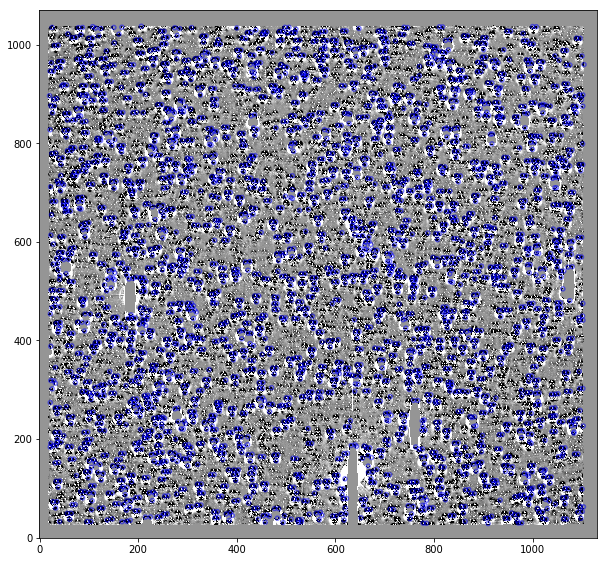

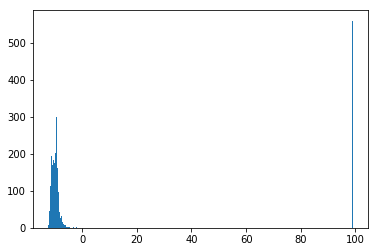

[[ 290.65888543   49.93611548]
 [ 290.98883467   50.09571933]
 [ 291.36802067   50.22591872]
 ..., 
 [ 290.56817241   51.20453555]
 [ 290.5485079    51.18508903]
 [ 290.96586343   51.37284029]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:57.3203 +50:05:44.5896': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.325 +50:13:33.3074': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:33.75 +50:25:52.5999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.7202 +50:01:29.2443': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:22.0878 +50:30:38.5936': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.0667 +50:13:13.8177': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:13.8149 +50:30:10.1001': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:54.3543 +50:11:01.0443': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:23.4304 +49:54:35.1308': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:34.2629 +50:30:25.8523': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:24.6522 +50:28:14.0083': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:57.1885 +49:59:03.9498': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:54.1001 +50:07:23.0204': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:21.1839 +50:27:59.3525': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:33.4782 +50:22:27.8276': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.4851 +51:11:05.4368': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:39.1772 +51:11:21.5544': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.9027 +51:04:00.9921': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.4662 +51:09:34.0143': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:40.1272 +51:04:25.5412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:45.3631 +51:05:00.7938': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.719 +51:12:04.2233': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.9072 +51:14:48.3016': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:18.1704 +51:19:59.8852': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:52.4386 +51:10:23.0166': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.456 +50:51:59.3744': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.8729 +50:52:16.5678': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:00.8663 +51:17:16.766': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:14.7719 +51:18:38.7026': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:21.6491 +50:54:37.8478': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.2315 +51:12:56.096': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:55.284 +51:16:07.1895': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:07.5951 +50:52:30.8768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:17.1996 +50:46:13.5068': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:19.9572 +50:46:32.0707': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:53.6127 +51:08:47.0878': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:24.6384 +51:16:59.3391': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:27.4395 +51:17:15.6868': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:52.6162 +50:48:55.4901': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.3015 +51:07:07.463': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:08.0026 +50:43:42.5358': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:22.9417 +50:51:05.0564': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:10.4957 +50:49:34.0735': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:10.347 +50:49:14.1416': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:31.2739 +50:52:10.1263': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:08.5799 +50:54:49.2832': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.1774 +50:54:31.8243': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.1528 +50:54:04.3196': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.0875 +51:15:34.0354': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:43.571 +51:09:50.9167': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.3156 +51:09:34.8081': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:21.3661 +50:54:23.5588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:23.067 +50:54:31.2114': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:22.2491 +51:06:57.5137': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.2897 +51:08:29.8339': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:06.5051 +50:39:49.0373': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.1277 +51:14:13.0248': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:00.831 +50:44:12.4443': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:04.5457 +50:44:41.7266': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:03.2697 +50:44:28.0494': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:34.6309 +50:53:09.7591': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.0795 +50:52:46.4043': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:29.8039 +50:53:03.2504': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.2044 +50:54:53.8987': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.6806 +50:55:14.4755': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:02.229 +50:55:31.1122': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:01.5973 +51:07:04.3392': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:36.8278 +51:04:38.5116': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.6088 +51:14:35.4023': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:01.0128 +50:53:54.3588': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:32.3225 +50:38:22.4435': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.0091 +50:40:05.5151': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:36.4246 +51:02:52.0895': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.4139 +51:05:28.6962': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.5804 +51:05:57.3072': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.4054 +50:54:21.8969': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.9592 +51:02:44.8431': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:42.0784 +51:02:33.1628': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:27.4096 +50:35:24.7392': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:29.7818 +50:35:42.026': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:48.5711 +50:43:43.0209': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:35.0737 +51:11:50.4887': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.0612 +51:12:06.8846': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.4795 +50:49:39.0452': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:14.6278 +51:09:09.0736': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:53.9818 +50:36:11.7929': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:33.5409 +50:40:19.9007': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:02.6088 +50:36:20.0476': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:27.0916 +50:39:05.994': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:08.4064 +51:00:50.596': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.7463 +50:58:47.8423': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:48.6322 +50:59:06.2992': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.5365 +50:44:21.7881': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:11.7435 +50:35:57.4735': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:14.1679 +50:36:14.0332': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:19.1275 +51:09:27.2855': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:32.7672 +51:02:22.7302': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:05.4538 +50:47:20.4915': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:19.9612 +50:48:57.3297': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:47.2942 +51:09:03.4086': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:50.1316 +51:09:12.5194': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:51.4921 +51:03:39.0819': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.609 +50:42:25.2301': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:24.1637 +50:53:45.7635': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:26.818 +50:53:55.3211': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:18.333 +50:40:26.0505': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:38.6412 +50:48:34.705': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:41.1472 +50:48:51.5155': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:47.001 +50:54:39.4539': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.1008 +51:05:58.7404': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:42.0909 +51:06:14.1284': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.0787 +50:40:34.5146': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:00.2139 +51:07:24.7358': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:02.7639 +51:07:38.583': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:20.2358 +50:50:17.9881': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:38.8793 +50:58:02.5637': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:41.7981 +50:58:20.0348': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:52.4956 +50:52:27.8926': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:47.7876 +50:51:43.0935': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:09.6516 +50:35:55.7494': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.4429 +50:53:21.3291': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:13.7325 +50:53:43.7585': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.1152 +50:53:29.3948': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:52.6141 +51:02:51.8106': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.376 +50:58:29.9439': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:11.8502 +50:58:44.397': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:13.2169 +50:39:51.1571': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:10.8509 +50:39:33.2743': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:35.625 +50:35:51.3066': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:31.6209 +50:28:21.2892': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:04.53 +50:31:45.6672': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.9594 +50:32:03.3774': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:41.3877 +50:53:27.5229': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:44.1646 +50:35:18.8447': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:06.7102 +50:43:41.68': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:17.1188 +50:37:52.026': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:01.0138 +50:29:52.2636': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.4345 +50:37:02.313': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:24.7929 +50:31:08.8879': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.7156 +50:31:26.1928': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:50.7854 +50:52:44.1264': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.8365 +50:55:34.3645': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.2938 +50:40:00.9177': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.0532 +50:54:18.189': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:57.7221 +50:27:13.5948': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:28.2274 +50:23:51.794': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:30.6506 +50:24:07.5858': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:10.1601 +50:33:51.3398': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:31.7755 +50:35:04.3838': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.5399 +50:35:35.5104': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.4511 +50:46:32.5879': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:24.8209 +50:46:22.1296': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.8972 +50:46:13.2482': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:10.2081 +50:39:03.7659': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:59.7658 +50:50:14.0826': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.6472 +50:33:01.2927': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:42.1105 +50:29:21.0534': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:19.8197 +50:32:52.543': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.8067 +50:32:36.0573': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:34.2151 +50:21:57.9801': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.75 +50:27:22.8548': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.2352 +50:41:25.5475': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:09.6016 +50:37:09.6963': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.5912 +50:40:23.4995': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:49.4852 +50:40:55.1673': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:35.7702 +50:38:49.0518': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:41.7157 +50:57:25.8075': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:35.5333 +50:56:43.5997': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:41.9527 +50:38:19.5285': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:06.8262 +50:40:47.7904': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.3436 +50:40:30.3262': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:15.5191 +50:46:44.254': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.4983 +50:46:59.6251': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.2024 +50:54:03.7893': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.35 +50:27:18.7983': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:35.7675 +50:42:14.5677': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:44.8065 +50:48:51.5631': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:27.9518 +50:22:20.2902': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.5456 +50:39:20.5251': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.4393 +50:25:00.8513': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.5507 +50:39:18.0145': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.6963 +50:41:37.5318': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:02.4118 +50:31:15.0696': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:17.4135 +50:19:27.58': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:19.9463 +50:19:42.8034': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:51.1369 +50:47:40.9085': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:56.0411 +50:48:26.3221': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:16.2763 +50:25:27.8047': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:08.8985 +50:48:47.3393': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:49.3921 +50:45:44.1386': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:52.0165 +50:45:59.6304': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:55.1498 +50:21:51.0412': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:23.6467 +50:41:57.9443': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:23.6081 +50:42:22.0768': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.4325 +50:42:34.4236': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:41.4908 +50:25:18.1809': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.7209 +50:31:16.4824': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.3325 +50:31:35.7933': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:26.0642 +50:16:25.5715': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.5808 +50:16:40.7422': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:37.9385 +50:42:28.1095': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:34.9251 +50:35:26.0069': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:20.6837 +50:15:25.0475': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:18.5133 +50:27:40.2747': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:41.3382 +50:47:28.3507': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:18.5216 +50:20:37.0929': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:48.4198 +50:23:49.3326': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:06.5416 +50:18:30.2282': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:47.5172 +50:47:12.8652': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:50.0122 +50:47:27.6004': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:05.2316 +50:41:48.0465': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:49.4853 +50:21:44.2897': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.8579 +50:29:15.3245': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:12.0629 +50:23:39.2435': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:05.2493 +50:41:05.298': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.4599 +50:37:14.8212': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:09.3813 +50:47:10.8028': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:01.3194 +50:40:21.719': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.7514 +50:41:20.7776': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:59.8708 +50:26:56.1533': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.8806 +50:27:11.1806': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:17.2531 +50:10:11.4093': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:08.8637 +50:21:06.4105': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.7492 +50:27:53.0116': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.1835 +50:38:44.9103': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:56.7901 +50:31:15.0057': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:58.9439 +50:31:29.5363': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:10.2408 +50:07:51.5721': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:25.7033 +50:27:29.6636': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:52.028 +50:42:22.6968': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:07.3838 +50:43:51.8939': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:53.5286 +50:41:47.9651': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:56.1784 +50:42:04.5631': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:27.6795 +50:14:49.1699': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.0795 +50:17:15.7504': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:00.358 +50:17:00.1746': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:04.2591 +50:17:44.4437': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:25.6423 +50:43:17.0917': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.2081 +50:31:02.5213': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:31.2408 +50:43:40.3018': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:37.8103 +50:18:53.115': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:38.1921 +50:19:20.7442': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:40.8015 +50:19:29.2822': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:28.7514 +50:41:57.9232': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:20.4315 +50:34:54.8206': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:21.1451 +50:35:09.8988': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.8159 +50:33:10.3021': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.8909 +50:32:48.3235': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:39.7191 +50:05:35.7528': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.4576 +50:34:07.6822': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:57.8335 +50:25:06.6396': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:12.6409 +50:20:38.6467': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.3151 +50:05:01.9908': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:23.0017 +50:33:03.8682': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:45.2747 +50:41:06.6256': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:35.0178 +50:34:23.9371': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:15.8073 +50:06:49.4456': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:30.1349 +50:20:45.4224': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.2936 +50:21:43.0044': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.288 +50:26:41.7531': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:07.113 +50:29:32.9285': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:50.0677 +50:02:30.2508': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:52.6463 +50:02:45.6447': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:14.5855 +50:29:42.9996': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:39.7571 +50:31:30.3928': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:42.8907 +50:31:33.8833': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:46.1217 +50:31:45.8476': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.6305 +50:01:59.1223': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:33.2499 +50:05:35.8449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.2941 +50:14:56.5261': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.9285 +50:06:42.31': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:58.265 +50:07:12.1791': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:01.7254 +50:07:22.8484': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.6909 +50:10:13.2878': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:40.9444 +50:23:02.3999': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:34.9742 +50:34:33.8527': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:29.1905 +50:33:02.0975': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.687 +50:01:56.61': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:30.3144 +50:02:35.0892': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astro

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:39.3002 +50:15:02.3277': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:48.2749 +50:28:03.8113': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:17.6762 +50:30:49.7886': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:39.6918 +50:20:23.8161': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:23.8118 +50:24:49.1556': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.4655 +50:25:03.7282': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:21.9016 +50:18:03.2145': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:06.4259 +49:57:38.4': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:08.73 +49:57:54.8976': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroqu

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:50.1422 +50:20:08.3934': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:26.3347 +50:23:38.5681': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:31.4926 +50:30:10.6883': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:14.6972 +50:21:57.9672': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:16.8758 +50:22:10.169': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:55.3115 +50:26:04.4289': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:08.0336 +50:20:31.6888': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:00.5504 +51:01:55.9493': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:37.6055 +50:06:13.27': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:04.8193 +50:50:11.6155': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:29.8868 +51:12:22.2819': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:16.7753 +51:04:13.7211': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:01.2463 +50:58:51.0652': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:20.904 +51:23:31.4103': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:29.7645 +51:24:33.6101': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:41.426 +50:54:07.8474': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.9221 +51:12:21.0393': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:57.5841 +51:10:06.4238': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:12.041 +51:05:32.3459': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:09.4929 +51:11:14.1789': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:34.1405 +51:25:31.7404': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/data/mj1e16/kepler/properDiff/diff_imNo16_channel1.fits


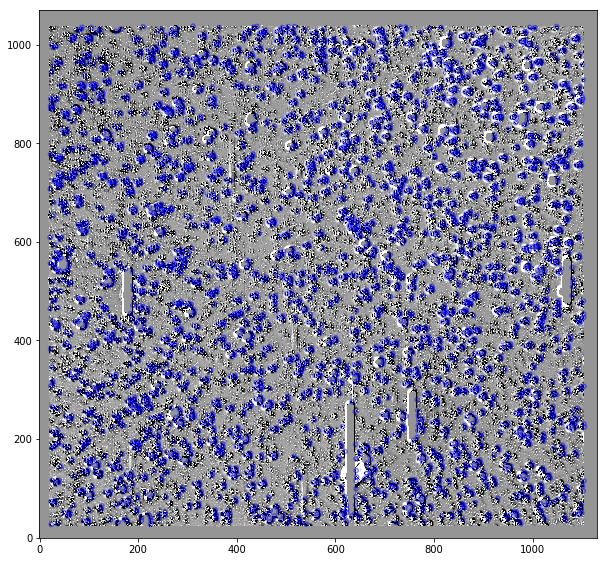

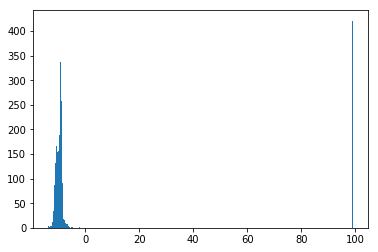

[[ 292.119971     50.50552122]
 [ 290.72856002   49.94396377]
 [ 291.36054688   50.20240588]
 ..., 
 [ 290.05906681   50.85037097]
 [ 289.91798452   50.81465737]
 [ 290.03163674   50.87282546]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:28.793 +50:30:19.8764': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:54.8544 +49:56:38.2696': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:26.5313 +50:12:08.6612': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:22.2669 +50:05:50.4739': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:28:01.256 +50:27:52.8565': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.4159 +50:16:18.3378': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:33.1772 +50:25:21.9352': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:28.2454 +50:13:25.3078': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.8728 +49:54:12.1878': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.5409 +49:56:52.1351': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:15.95 +49:59:31.0645': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:55.4835 +50:17:28.6049': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.6153 +49:57:18.3287': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:50.0494 +50:05:15.1974': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:04.7694 +50:06:08.6551': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:15.6242 +50:21:23.4068': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:20.8626 +50:24:44.2397': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:01.4609 +49:58:10.3379': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:21.7312 +50:16:00.5887': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:05.9158 +50:26:21.6872': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:05.8791 +50:14:50.9651': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:07.1159 +49:57:07.6983': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:11.0873 +49:56:33.1697': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:10.2555 +50:10:09.9369': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:06.7247 +50:27:14.6991': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:09.0471 +50:10:16.2868': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:53.6527 +50:08:19.3383': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:44.7035 +50:13:52.7211': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:07.9493 +50:10:38.3827': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:49.5752 +50:27:29.6326': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:50.5717 +50:34:13.2512': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:21.9232 +50:30:50.4655': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:48.3764 +50:27:53.6914': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:42.9785 +50:15:18.699': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:34.5672 +50:02:04.5044': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:34.4456 +50:06:23.8182': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:58.0508 +50:23:17.6228': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:09.6239 +50:18:40.1029': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:11.2314 +50:06:31.118': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:19.3689 +50:32:16.3995': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:52.6584 +50:23:11.7226': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:33.1036 +50:09:28.5222': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:31.1073 +50:34:30.7312': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:27:33.9731 +50:34:28.9928': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:55.4619 +50:06:24.9347': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:00.2622 +50:42:37.2974': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:28.0072 +51:16:36.2286': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.2103 +51:14:03.611': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:23.0279 +51:08:55.1815': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:59.7835 +50:55:22.4229': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.4548 +51:18:24.6246': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:33.8243 +50:51:58.8362': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:56.3034 +51:06:44.0794': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:18:59.8814 +50:42:08.9952': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.6969 +50:52:56.091': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:58.8941 +50:52:47.4867': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:25.0727 +50:56:17.9636': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:33.5196 +50:50:11.2449': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:37.1422 +50:50:39.48': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:47.7035 +51:08:50.7893': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:20.7311 +51:00:54.5447': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:18.3948 +51:06:49.8441': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:13.8822 +51:18:23.0582': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:30.752 +50:49:02.3865': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:55.0433 +50:51:38.2034': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:03.3314 +51:10:42.8098': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:22.4728 +50:53:49.1754': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:31.2591 +50:54:48.2317': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:49.4127 +50:56:40.4101': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:41.8874 +50:42:13.5143': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:43.9102 +50:41:41.4805': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:48.246 +50:55:09.263': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:32.9897 +50:59:44.0656': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:06.4911 +50:50:39.4869': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:36.0389 +51:06:02.7035': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:47.7801 +51:06:28.7581': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:10.0233 +51:14:43.506': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:45.0375 +51:05:59.3133': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:28.7192 +50:51:14.8905': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:36.8778 +50:58:05.1967': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:40.0199 +51:10:36.2512': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:58.7699 +50:53:29.9265': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:59.485 +50:53:08.3019': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:02.5684 +51:05:59.9071': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:34.1353 +50:50:21.7855': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:56.6223 +50:51:51.8874': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:21:53.2741 +50:52:01.5072': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:38.1791 +50:37:33.5587': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.4801 +50:38:55.6194': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:19:50.6374 +50:38:26.1861': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:47.1578 +51:08:16.166': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:49.237 +51:08:16.7874': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:18.1928 +51:11:22.6984': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astr

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:36.9058 +51:11:17.6959': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:38.8496 +51:11:19.5414': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:04.8262 +50:39:08.8769': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:16.7719 +50:57:39.5703': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:28.2857 +50:52:37.7534': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:23:19.0951 +50:57:48.3499': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/as

/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:21.8681 +51:03:50.2193': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:20:02.4254 +50:37:13.364': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:25:08.0075 +51:08:19.0787': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

In [ ]:
objectsFound = []

for imNo in range(len(imagelist)):
    for channel in range(1,2): #len(medians)):
        magLim = lowerMagLims[channel]
        diffImName = '/data/mj1e16/kepler/properDiff/diff_imNo{}_channel{}.fits'.format(imNo,channel)
        brightTrans = sextractorTransientSearch(diffImName,'test.cat',magLim)
        if len(brightTrans) > 0:
            result_table = queryObjectRegion(brightTrans,'sex',diffImName)
            objectsFound.append(findObjectOccurences(result_table,'OTYPE'))
            

In [31]:
objectsFound = []
objectsFound.append(findObjectOccurences(result_table,'OTYPE'))
print(objectsFound)

[OrderedDict([('-', 1), ('Not Found in Simbad', 2903), ('RotV*', 8), ('Star', 22)])]


/data/mj1e16/kepler/properDiff/diff_imNo0_channel2.fits


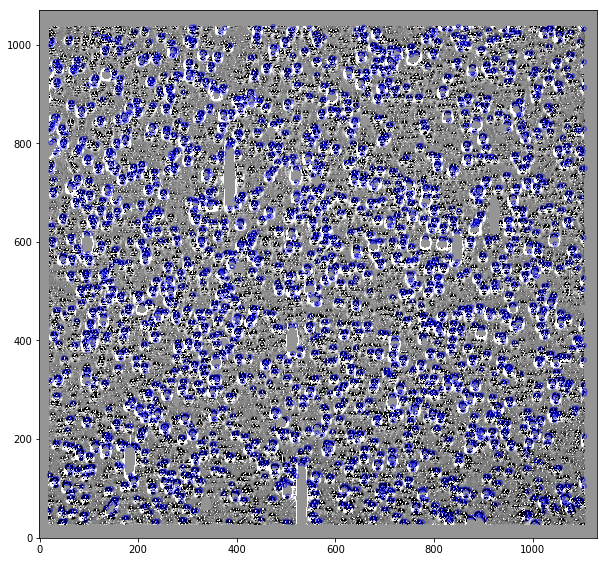

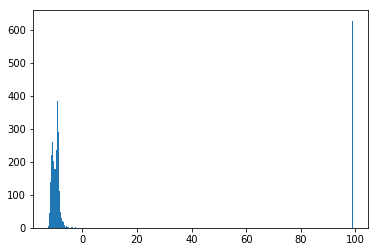

In [19]:
imNo = 0
channel = 2
magLim = -9
diffImName = '/data/mj1e16/kepler/properDiff/diff_imNo{}_channel{}.fits'.format(imNo,channel)
brightTrans = sextractorTransientSearch(diffImName,'test.cat',magLim)

In [26]:
print(result_table)

MAIN_ID RA_d DEC_d        OTYPE        xcentroid ycentroid
------- ---- ----- ------------------- --------- ---------
      -  0.0   0.0                   -       0.0       0.0
    N/A  0.0   0.0 Not Found in Simbad  647.0416   99.8364
    N/A  0.0   0.0 Not Found in Simbad  646.1707   53.7858
    N/A  0.0   0.0 Not Found in Simbad  646.3025  195.1901
    N/A  0.0   0.0 Not Found in Simbad   628.134  273.2393
    N/A  0.0   0.0 Not Found in Simbad  624.6146   48.5795
    N/A  0.0   0.0 Not Found in Simbad  625.9633   94.4075
    N/A  0.0   0.0 Not Found in Simbad  230.5236   32.9999
    N/A  0.0   0.0 Not Found in Simbad  209.9736   30.7232
    N/A  0.0   0.0 Not Found in Simbad  163.3403   32.4995
    ...  ...   ...                 ...       ...       ...
    N/A  0.0   0.0 Not Found in Simbad  210.0089 1032.3317
    N/A  0.0   0.0 Not Found in Simbad 1003.7277 1031.1488
    N/A  0.0   0.0 Not Found in Simbad 1108.3148 1033.9186
    N/A  0.0   0.0 Not Found in Simbad  439.3037 1033.90

In [25]:
result_table = queryObjectRegion(brightTrans,'sex',diffImName)

[[ 291.14154333   50.21634032]
 [ 291.18556745   50.17398335]
 [ 291.05383599   50.30551075]
 ..., 
 [ 290.20704398   51.05663052]
 [ 290.35569023   51.12367809]
 [ 290.64836415   51.2440234 ]]


/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:22:23.483 +49:54:08.4485': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:24:48.9249 +50:11:49.4059': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/astroquery/simbad/core.py:136: UserWarning: Warning: The script line number 3 raised an error (recorded in the `errors` attribute of the result table): '19:26:19.9749 +50:19:44.9547': No astronomical object found :
  (error.line, error.msg))
/home/mj1e16/miniconda2/envs/astroconda/lib/python2.7/site-packages/ast

In [33]:
def ds9Command(imNo,channel):
    print('ds9 {}[{}]'.format(imagelist[imNo],int(extensionOrders[imNo][channel])))

In [34]:
ds9Command(0,1)

ds9 /data/mj1e16/kepler/cal/kplr2012121122500_ffi-cal.fits[53]
